# *Clusterisation of time series*

IMPORTING LIBRARIES

Before we get started, let's import all necessary libraries for performing our time series classification:

In [260]:
# %load_ext autoreload
# %autoreload 2
# %matplotlib inline


# importing general libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
import time
from datetime import datetime
import warnings
import random

warnings.filterwarnings("ignore")

import os
import random
from tqdm.auto import tqdm
from itertools import product
from typing import List, Tuple, Dict

# importing functions from sklearn and related libraries

from sklearn.preprocessing import MaxAbsScaler
from sklearn.linear_model import Ridge
from sklearn.manifold import MDS
from sklearn.metrics.pairwise import manhattan_distances, euclidean_distances,cosine_distances
from sklearn.metrics import pairwise_distances
from sklearn.model_selection import train_test_split
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
from yellowbrick.cluster.silhouette import SilhouetteVisualizer
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn_extra.cluster import KMedoids

from tslearn.clustering import KShape
from tslearn.utils import to_time_series_dataset
from tslearn.clustering import TimeSeriesKMeans

# importing functions from sktime

from sktime.transformations.series.detrend import Deseasonalizer
from sktime.utils.plotting import plot_series
from sktime.clustering.k_means import TimeSeriesKMeans as clusterkmeans
from sktime.clustering.k_medoids import TimeSeriesKMedoids
#from sktime.clustering.k_shapes import TimeSeriesKShapes
#from sktime.clustering import BaseClusterer
from sktime.clustering.utils.plotting._plot_partitions import plot_cluster_algorithm
from sktime.datasets import load_arrow_head

__Download of the data__

In [261]:
infile_dfindices = open('data_indices/dfindices_interpolated_notnormalized','rb')
dfindices = pickle.load(infile_dfindices)
infile_dfindices.close()

In [262]:
def simple_exp_smooth(d,alpha=0.4):  
    mylist= d  # Transform the input into a numpy array 
    cols = len(mylist)  # Historical period length  

    f = list(np.full(cols,np.nan))  # Forecast array  
    f[0] = mylist[0]  # initialization of first forecast  
      # Create all the t+1 forecasts until end of historical period  
    for t in range(1,cols):  
        f[t] = alpha*mylist[t-1]+(1-alpha)*f[t-1]  
    return f

<div class="alert-info">
1. Creating training dataset for clustering algorithm
</div>

In [263]:
print("loading M4 TimeSeries...")
with open("m4_monthly_scaled.pkl", "rb") as f:
    m4_series = pickle.load(f)

# filter and keep only series that contain at least 52 training points
m4_series = list(filter(lambda t: len(t[0]) >= 252, m4_series))

loading M4 TimeSeries...


In [264]:
len(m4_series)

18398

Selecting only the time series that make sense to me.

In [265]:
list_timeseries = []
numbernegval=0
oldmax = 0
oldmin = 0
for tm in m4_series:
    mylist = []
    for x in tm[0].all_values():
        mylist.append(x[0][0])
    mylist = mylist[:252]
    toverify =np.array(mylist)
    for x in mylist:
        if x<oldmin:
            oldmin=x 
        if x>oldmax:
            oldmax=x
        if x<0:
            numbernegval=numbernegval+1
    if toverify.mean()>0.05:
        list_timeseries.append(mylist)
print('My global minimum is '+str(oldmin))
print('My global maximum is '+str(oldmax))
print('Number of negative values is '+str(numbernegval))

My global minimum is 0
My global maximum is 1.0
Number of negative values is 0


We smooth our time series.

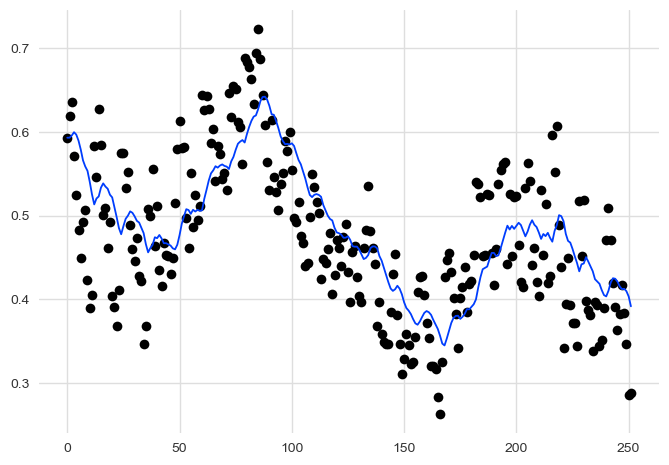

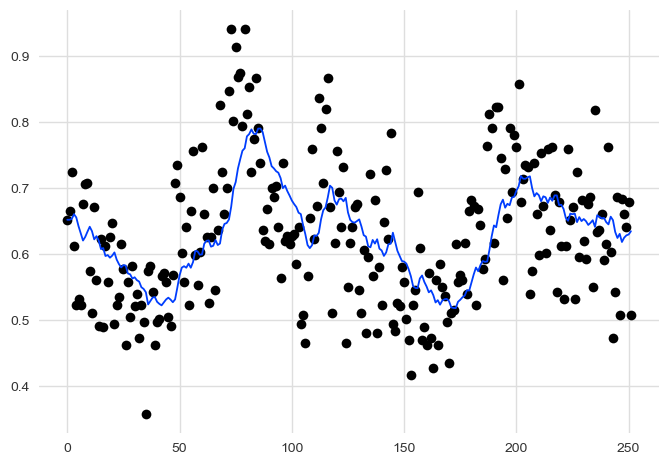

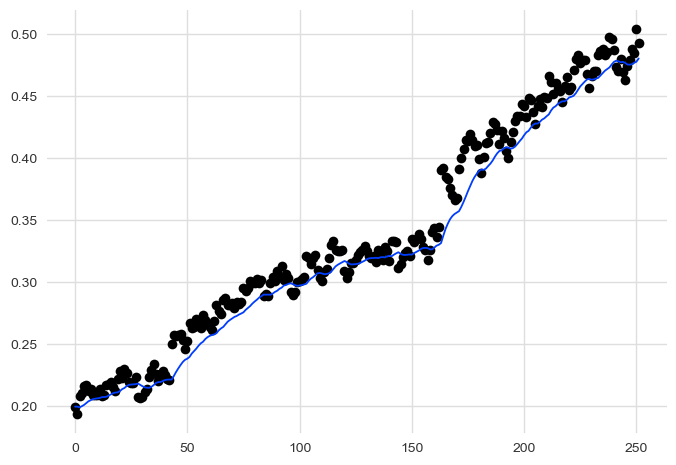

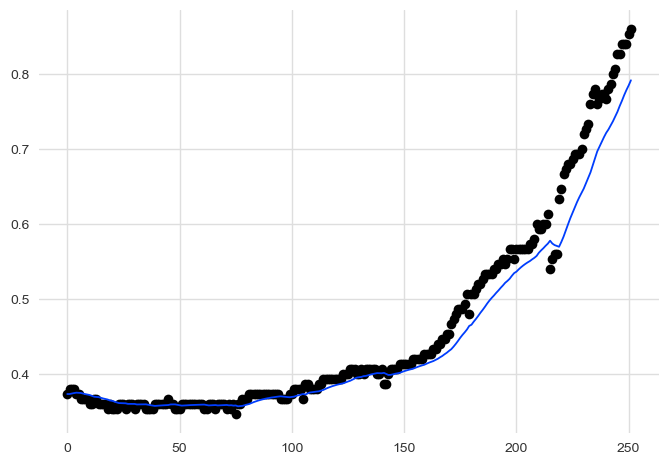

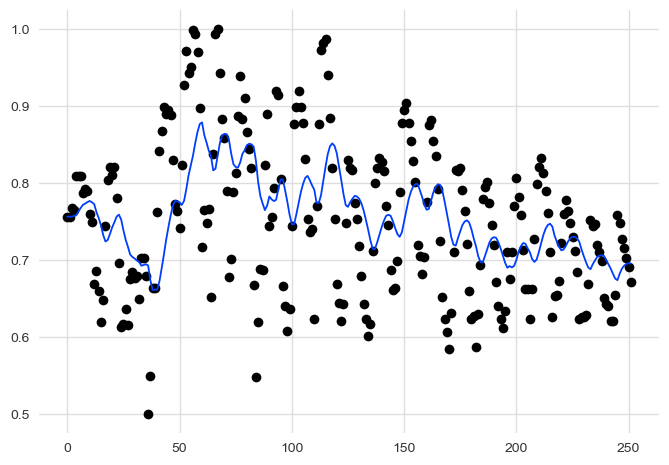

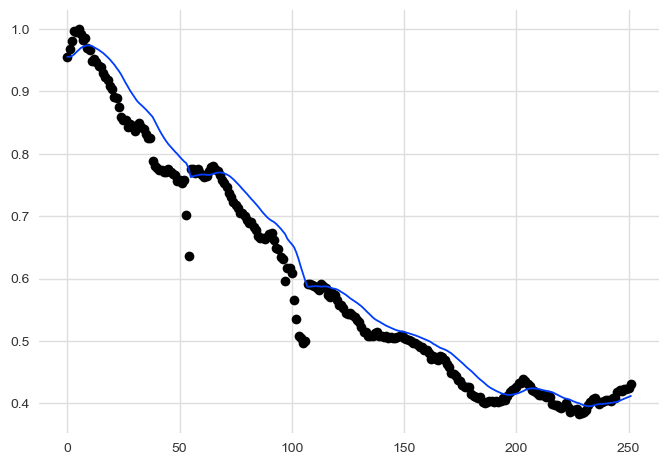

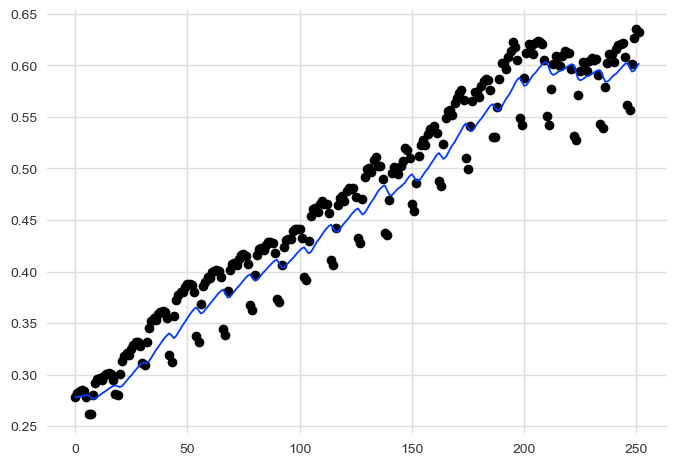

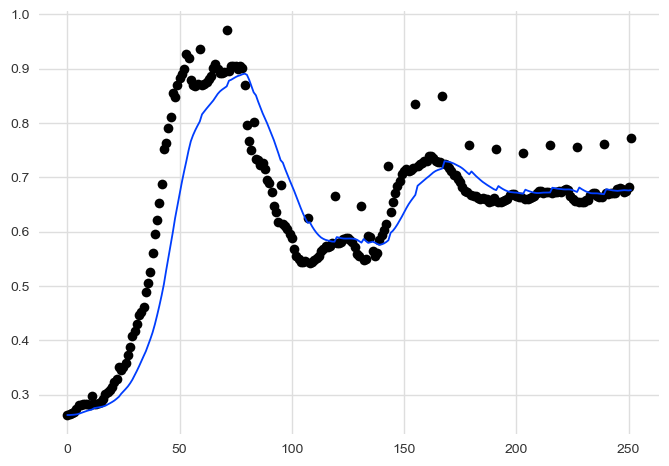

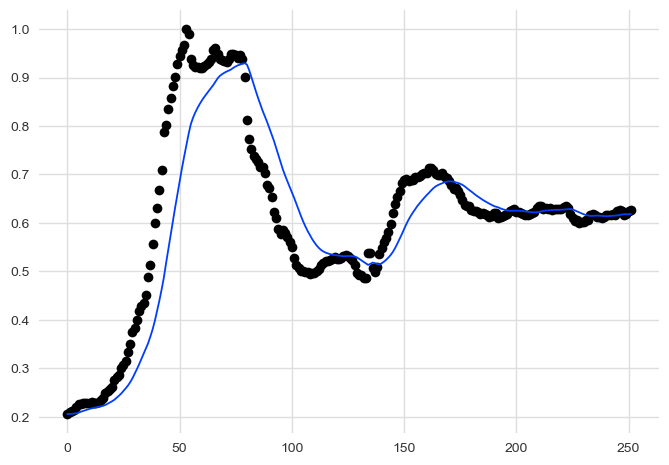

In [266]:
list_smoothed_timeseries = []
myx=np.arange(0,252)

i= 0

for tm in list_timeseries:
    mysmoothedtm = simple_exp_smooth(tm,0.1)
    list_smoothed_timeseries.append(mysmoothedtm)
    i=i+1
    if i<10:
        plt.plot(myx,tm, 'o',myx,mysmoothedtm, '-')
        plt.show()

In [267]:
dftraincluster = pd.DataFrame({'timeseries':[pd.Series(x) for x in list_smoothed_timeseries]})
dftraincluster

,timeseries
0,0 0.593032 1 0.593032 2 0.59562...
1,0 0.652406 1 0.652406 2 0.65374...
2,0 0.199328 1 0.199328 2 0.19873...
3,0 0.373333 1 0.373333 2 0.37400...
4,0 0.756529 1 0.756529 2 0.75644...
...,...
18350,0 0.152420 1 0.152420 2 0.15190...
18351,0 0.136892 1 0.136892 2 0.13689...
18352,0 0.135412 1 0.135412 2 0.13630...
18353,0 0.128894 1 0.128894 2 0.12855...


<div class="alert-info">
2. Creation of a dataframe for time series for darts
</div>

In [268]:
def cnv(row):
    my_months = ['January','February','March','April','May','June','July','August','September','October','November','December']
    index = my_months.index(row.month)
    month = index +1
    datStr = str(month) +'-01-' + str(row.year-2000)
    return datStr

In [269]:
dfindices['date'] = dfindices.apply(cnv, axis=1)

In [270]:
dfindices

,concept2,concept1,index_keyword,index_cit_t1_t2,index_cit_t2_t1,index_colab_notincrem,index_colab_increm,month,year,date
0,Authentication protocole,Authentication protocole,1.720479,0.0,0.0,2.699103,2.699103,January,2002,1-01-2
0,Authentication protocole,Authentication protocole,1.720479,0.0,0.0,2.699103,2.699103,February,2002,2-01-2
0,Authentication protocole,Authentication protocole,1.720479,0.0,0.0,2.699103,2.699103,March,2002,3-01-2
0,Authentication protocole,Authentication protocole,7.22864,0.836174,0.836174,13.77767,13.808524,April,2002,4-01-2
0,Authentication protocole,Authentication protocole,3.355919,0.0,0.0,6.284266,6.284266,May,2002,5-01-2
...,...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8.031585,0.0,0.0,28.72956,54.317264,August,2022,8-01-22
624,Zero-knowlegde proof,Zero-knowlegde proof,8.877465,0.0,0.0,19.811067,19.811067,September,2022,9-01-22
624,Zero-knowlegde proof,Zero-knowlegde proof,14.777641,6.706388,6.706388,44.762499,48.748713,October,2022,10-01-22
624,Zero-knowlegde proof,Zero-knowlegde proof,6.616964,0.0,0.0,16.901309,24.238745,November,2022,11-01-22


In [271]:
dfindices = dfindices.drop(['year', 'month'], axis=1).sort_index(axis=1)

In [272]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964


In [273]:
dfindices.to_pickle('data_indices/dfindices_timeseries')

<div class="alert-info">
3. Creation of a dataframe for time series for sktime
</div>

In [274]:
infile_dfindices = open('data_indices/dfindices_interpolated_notnormalized','rb')
dfindices = pickle.load(infile_dfindices)
infile_dfindices.close()

In [275]:
def cnv_sk(row):
    my_months = ['January','February','March','April','May','June','July','August','September','October','November','December']
    index = my_months.index(row.month)
    themonth = index +1
    a = pd.Period(freq='M', year=row.year, month=themonth)
    return a

In [276]:
dfindices['date'] = dfindices.apply(cnv_sk, axis=1)

In [277]:
dfindices = dfindices.drop(['year', 'month'], axis=1).sort_index(axis=1)

In [278]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,2002-01,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2002-02,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2002-03,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2002-04,0.836174,0.836174,13.808524,13.77767,7.22864
0,Authentication protocole,Authentication protocole,2002-05,0.0,0.0,6.284266,6.284266,3.355919
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08,0.0,0.0,54.317264,28.72956,8.031585
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09,0.0,0.0,19.811067,19.811067,8.877465
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10,6.706388,6.706388,48.748713,44.762499,14.777641
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11,0.0,0.0,24.238745,16.901309,6.616964


<div class="alert-info">
4. Normalizing and deseasonalizing dfindices
</div>

In [279]:
list_indices=['index_cit_t1_t2','index_cit_t2_t1','index_colab_increm','index_colab_notincrem','index_keyword']

In [280]:
def fun_normalize_deseaz(df,list_indices,period_season=12):
    transformer = Deseasonalizer(sp=period_season)  
    list_new_indices = []
    for myindex in list_indices:
        indices = df[myindex].tolist() 
        #deseasonalized_indices = transformer.fit_transform(np.array(indices))
        #myindices = [x[0] for x in deseasonalized_indices]
        
        mymax = max(indices)
        mymin = min(indices)
        indices 
        if mymax!=mymin:
            indices = [(x - mymin) / (mymax - mymin) for x in indices]
        else:
            if mymax!=0:
                print(mymax)
                print('There is a constant time series which is not zero!')
        list_new_indices.append(simple_exp_smooth(indices,alpha=0.1))
        
    return list_new_indices

In [281]:
dfindices_normalized = dfindices.groupby(['concept1','concept2']).apply(lambda x: fun_normalize_deseaz(x,list_indices)).to_frame()

In [282]:
dfindices_normalized

0
concept1                 concept2                                                                    
Authentication protocole Authentication protocole   [[0.0, 0.0, 0.0, 0.0, 0.002631974544005568, 0....
                         Biometrics                 [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
                         Blockchain                 [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
                         Digital rights management  [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.14...
                         Digital signature          [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.399074728538...
...                                                                                               ...
Zero-knowlegde proof     Symmetric-key algorithm    [[0.0, 0.0, 0.0, 0.0, 1.3084183506695708e-10, ...
                         Threshold cryptosystem     [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
                         Trusted Computing          [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
                         Tunneling protocol         [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
                         Zero-knowlegde proof       [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0044624...

[625 rows x 1 columns]

In [283]:
dfindices_normalized.rename(columns={0: "indices"}, inplace=True)
dfindices_normalized.reset_index(inplace=True, level=['concept1'])
dfindices_normalized.reset_index(inplace=True, level=['concept2'])

In [284]:
dfindices_normalized

,concept2,concept1,indices
0,Authentication protocole,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.002631974544005568, 0...."
1,Biometrics,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,Blockchain,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,Digital rights management,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.14..."
4,Digital signature,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.399074728538..."
...,...,...,...
620,Symmetric-key algorithm,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 1.3084183506695708e-10, ..."
621,Threshold cryptosystem,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
622,Trusted Computing,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
623,Tunneling protocol,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [285]:
listindices = dfindices_normalized['indices'].tolist()
list_all = []
for j in range(5):
    list_index_for_alltech = []
    for i in range(625):
        # we take the list corresponding to the list of indices for this pair of technologies
        list_concept = listindices[i]
        # we take the list corresponding to the list of the specific indices we want for this pair of technologies
        list_myindex = list_concept[j]
        list_index_for_alltech.append(list_myindex)
    list_all.append(list_index_for_alltech)

In [286]:
k = 0
for myindex in list_indices:
    dfindices_normalized[myindex]=list_all[k]
    k=k+1

In [287]:
dfindices_normalized

,concept2,concept1,indices,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.002631974544005568, 0....","[0.0, 0.0, 0.0, 0.0, 0.002631974544005568, 0.0...","[0.0, 0.0, 0.0, 0.0, 0.002631974544005568, 0.0...","[0.003142299239606753, 0.003142299239606753, 0...","[0.007803086355248033, 0.007803086355248033, 0...","[0.007501247003919597, 0.007501247003919598, 0..."
1,Biometrics,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 9.830651922644553e-08, 8....","[0.0, 0.0, 0.0, 0.0, 2.0495725537038644e-07, 1...","[0.001319338276625429, 0.0013193382766254291, ..."
2,Blockchain,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Digital rights management,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.14...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.142...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.484...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.200...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0009165148166..."
4,Digital signature,Authentication protocole,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.399074728538...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.3990747285386...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 4.7771414782808...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0001277887559...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0002544291218...","[0.01094353065419715, 0.010943530654197151, 0...."
...,...,...,...,...,...,...,...,...
620,Symmetric-key algorithm,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 1.3084183506695708e-10, ...","[0.0, 0.0, 0.0, 0.0, 1.3084183506695708e-10, 2...","[0.0, 0.0, 0.0, 0.0, 1.1917477425563196e-10, 2...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.03300272798685272, 0.03300272798685272, 0.0..."
621,Threshold cryptosystem,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.12426949246042532, 0.12426949246042532, 0.1..."
622,Trusted Computing,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
623,Tunneling protocol,Zero-knowlegde proof,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.3488573404682414, 0.3488573404682414, 0.348..."


In [288]:
dfindices_normalized= dfindices_normalized.explode(list_indices)

In [289]:
dfindices_normalized=dfindices_normalized.drop('indices',axis=1)

In [290]:
my_months = ['January','February','March','April','May','June','July','August','September','October','November','December']
my_years = [2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022]

In [291]:
list_ofyears = []
for year in my_years:
    list_ofyears = list_ofyears+12*[year]

In [292]:
dfindices_normalized

,concept2,concept1,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,0.002632,0.002632,0.005128,0.011675,0.011244
...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,0.071042,0.071042,0.21198,0.279424,0.283876
624,Zero-knowlegde proof,Zero-knowlegde proof,0.063938,0.063938,0.210831,0.281445,0.283261
624,Zero-knowlegde proof,Zero-knowlegde proof,0.057544,0.057544,0.197061,0.273963,0.285633
624,Zero-knowlegde proof,Zero-knowlegde proof,0.069831,0.069831,0.195349,0.293252,0.30817


In [293]:
dfindices_normalized['month']=625*21*my_months
dfindices_normalized['year']=625*list_ofyears

In [294]:
dfindices_normalized

,concept2,concept1,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,month,year
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501,January,2002
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501,February,2002
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501,March,2002
0,Authentication protocole,Authentication protocole,0.0,0.0,0.003142,0.007803,0.007501,April,2002
0,Authentication protocole,Authentication protocole,0.002632,0.002632,0.005128,0.011675,0.011244,May,2002
...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,0.071042,0.071042,0.21198,0.279424,0.283876,August,2022
624,Zero-knowlegde proof,Zero-knowlegde proof,0.063938,0.063938,0.210831,0.281445,0.283261,September,2022
624,Zero-knowlegde proof,Zero-knowlegde proof,0.057544,0.057544,0.197061,0.273963,0.285633,October,2022
624,Zero-knowlegde proof,Zero-knowlegde proof,0.069831,0.069831,0.195349,0.293252,0.30817,November,2022


In [295]:
dfindices_normalized['date'] = dfindices_normalized.apply(cnv_sk, axis=1)

In [296]:
dfindices_normalized = dfindices_normalized.drop(['year', 'month'], axis=1).sort_index(axis=1)

In [297]:
dfindices_normalized

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,2002-01,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-02,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-03,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-04,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-05,0.002632,0.002632,0.005128,0.011675,0.011244
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08,0.071042,0.071042,0.21198,0.279424,0.283876
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09,0.063938,0.063938,0.210831,0.281445,0.283261
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10,0.057544,0.057544,0.197061,0.273963,0.285633
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11,0.069831,0.069831,0.195349,0.293252,0.30817


In [298]:
dfindices_normalized

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,2002-01,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-02,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-03,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-04,0.0,0.0,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-05,0.002632,0.002632,0.005128,0.011675,0.011244
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08,0.071042,0.071042,0.21198,0.279424,0.283876
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09,0.063938,0.063938,0.210831,0.281445,0.283261
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10,0.057544,0.057544,0.197061,0.273963,0.285633
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11,0.069831,0.069831,0.195349,0.293252,0.30817


In [299]:
dfindices_normalized.to_pickle('data_indices/dfindices_normalized_withmax')

<div class="alert-info">
5. Getting in touch with clustering algorithm of sktime
</div>

In [300]:
X, y = load_arrow_head(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(158, 1) (158,) (53, 1) (53,)


In [301]:
X_train 

,dim_0
193,0 -2.038970 1 -2.053289 2 -2.05208...
194,0 -2.061565 1 -2.094894 2 -2.09420...
100,0 -2.012424 1 -2.008557 2 -1.98535...
109,0 -1.813234 1 -1.825545 2 -1.81662...
14,0 -2.188812 1 -2.185519 2 -2.17646...
...,...
111,0 -1.721555 1 -1.736613 2 -1.71897...
155,0 -1.735623 1 -1.730093 2 -1.69493...
201,0 -1.830178 1 -1.812267 2 -1.81222...
152,0 -2.200299 1 -2.184525 2 -2.15325...


<Figure size 500x1000 with 0 Axes>

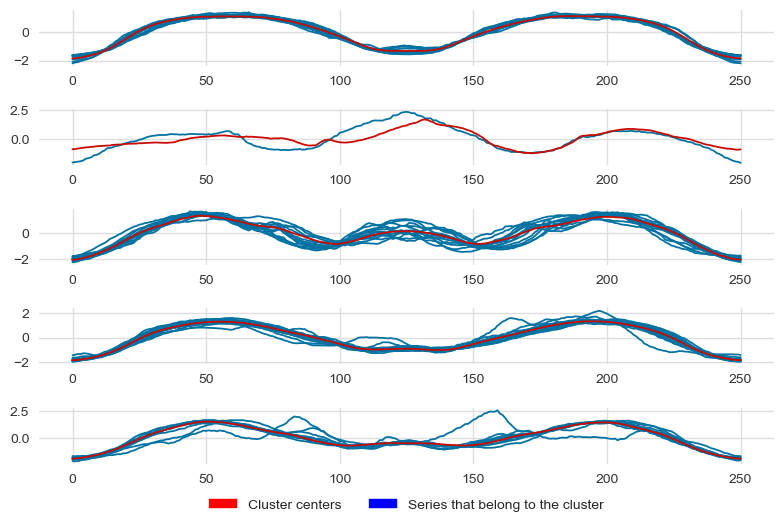

In [302]:
k_means = clusterkmeans(
    n_clusters=5,  # Number of desired centers
    init_algorithm="forgy",  # Center initialisation technique
    max_iter=10,  # Maximum number of iterations for refinement on training set
    metric="dtw",  # Distance metric to use
    averaging_method="mean",  # Averaging technique to use
    random_state=1,
)

k_means.fit(X_train)

plot_cluster_algorithm(k_means, X_test, k_means.n_clusters)

<div class="alert-info">
6. Filtering my time series to have only the ones I am interested in
</div>

The time series that are always zero or almost always zero are easily identifiable and the ones with a high interpolation rate do not make much sense. For this reason we eliminate them from the dataset, we use to fit the clustering algorithm or just to be clustered.

In [303]:
infile_df_interpolation = open('data_indices/df_interpolation_ratio','rb')
df_interpolation = pickle.load(infile_df_interpolation)
infile_df_interpolation.close()

In [304]:
dfindices_normalized.dtypes

concept1                    object
concept2                    object
date                     period[M]
index_cit_t1_t2             object
index_cit_t2_t1             object
index_colab_increm          object
index_colab_notincrem       object
index_keyword               object
dtype: object

In [305]:
for index in list_indices:
    dfindices_normalized[index]=dfindices_normalized[index].astype(float)

In [306]:
dfindices_normalized.dtypes

concept1                    object
concept2                    object
date                     period[M]
index_cit_t1_t2            float64
index_cit_t2_t1            float64
index_colab_increm         float64
index_colab_notincrem      float64
index_keyword              float64
dtype: object

In [307]:
dfindices.dtypes

concept1                    object
concept2                    object
date                     period[M]
index_cit_t1_t2             object
index_cit_t2_t1             object
index_colab_increm          object
index_colab_notincrem       object
index_keyword               object
dtype: object

Now I aim to try clustering algorithm with my own data.

In [308]:
dfindices_normalized

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,2002-01,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-02,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-03,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-04,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-05,0.002632,0.002632,0.005128,0.011675,0.011244
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08,0.071042,0.071042,0.211980,0.279424,0.283876
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09,0.063938,0.063938,0.210831,0.281445,0.283261
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10,0.057544,0.057544,0.197061,0.273963,0.285633
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11,0.069831,0.069831,0.195349,0.293252,0.308170


In [309]:
list_concepts= ['Authentication protocole','Biometrics','Blockchain','Digital rights management'
,'Digital signature','Distributed algorithm','Electronic voting','Functional encryption',
'Hardware acceleration','Hardware security module','Hash function','Homomorphic encryption','Identity management',
'Key management','Link encryption','Post-quantum cryptography','Public-key cryptography','Quantum key distribution',
'Quantum cryptography','Random number generation','Symmetric-key algorithm','Threshold cryptosystem',
'Trusted Computing','Tunneling protocol','Zero-knowlegde proof']

In [310]:
df_interpolation

,concept1,concept2,interpolation_ratio
548,Threshold cryptosystem,Tunneling protocol,0.944444
596,Tunneling protocol,Threshold cryptosystem,0.944444
577,Tunneling protocol,Blockchain,0.928571
73,Blockchain,Tunneling protocol,0.928571
589,Tunneling protocol,Link encryption,0.924603
...,...,...,...
110,Digital signature,Hash function,0.007937
410,Public-key cryptography,Hash function,0.000000
416,Public-key cryptography,Public-key cryptography,0.000000
266,Hash function,Public-key cryptography,0.000000


In [311]:
list_timeseries=[]

timezero = 0

for concept1 in list_concepts:
    dfconcept1 = dfindices_normalized.loc[dfindices_normalized['concept1']==concept1]
    dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
    for concept2 in list_concepts:
        dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2]
        dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
        interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
        
        if interpolation_score<0.5:
            for index in list_indices:
                indices = np.array(dfconcept2[index].tolist())

                if np.array(indices).mean()>0.02:
                    dfindex = dfconcept2[[index]]
                    dfindex=dfindex.reset_index(drop=True)
                    list_timeseries.append(dfindex[index])
                else:
                    timezero = timezero+1
                
print('There are '+str(timezero)+' time series that are almost completely flat.')

There are 1242 time series that are almost completely flat.


In [312]:
dfcluster = pd.DataFrame({'timeseries':list_timeseries})
dfcluster

,timeseries
0,0 0.000000 1 0.000000 2 0.00000...
1,0 0.000000 1 0.000000 2 0.00000...
2,0 0.003142 1 0.003142 2 0.00314...
3,0 0.007803 1 0.007803 2 0.00780...
4,0 0.007501 1 0.007501 2 0.00750...
...,...
1103,0 0.000000 1 0.000000 2 0.00000...
1104,0 0.000000 1 0.000000 2 0.00000...
1105,0 0.014221 1 0.014221 2 0.01422...
1106,0 0.022632 1 0.022632 2 0.02263...


In [313]:
X_train, X_test = train_test_split(dfcluster)

In [314]:
len(X_train)

831

In [315]:
len(X_test)

277

In [316]:
X_train=X_train.reset_index(drop=True)

In [317]:
X_test=X_test.reset_index(drop=True)

In [318]:
X_train

,timeseries
0,0 0.026792 1 0.026792 2 0.02679...
1,0 0.000000 1 0.000000 2 0.00000...
2,0 0.000000 1 0.000000 2 0.00000...
3,0 0.000000 1 0.000000 2 0.00000...
4,0 0.000000 1 0.000000 2 0.00000...
...,...
826,0 0.000000 1 0.000000 2 0.00000...
827,0 0.000000 1 0.000000 2 0.00000...
828,0 0.000000 1 0.000000 2 0.00000...
829,0 0.000000e+00 1 0.000000e+00 2 ...


In [319]:
X_test

,timeseries
0,0 0.000000 1 0.000000 2 0.00000...
1,0 0.000000 1 0.000000 2 0.00000...
2,0 0.000000 1 0.000000 2 0.00000...
3,0 0.000000e+00 1 0.000000e+00 2 ...
4,0 0.000000 1 0.000000 2 0.00000...
...,...
272,0 0.000000 1 0.000000 2 0.00000...
273,0 0.000000 1 0.000000 2 0.00000...
274,0 0.000000 1 0.000000 2 0.00000...
275,0 0.006191 1 0.006191 2 0.00619...


In [320]:
dfcluster

,timeseries
0,0 0.000000 1 0.000000 2 0.00000...
1,0 0.000000 1 0.000000 2 0.00000...
2,0 0.003142 1 0.003142 2 0.00314...
3,0 0.007803 1 0.007803 2 0.00780...
4,0 0.007501 1 0.007501 2 0.00750...
...,...
1103,0 0.000000 1 0.000000 2 0.00000...
1104,0 0.000000 1 0.000000 2 0.00000...
1105,0 0.014221 1 0.014221 2 0.01422...
1106,0 0.022632 1 0.022632 2 0.02263...


<div class="alert-info">
7. Evaluating the different clusterers with different number of clusters
</div>

Note: algo must be either TimeSeriesKMeans, TimeSeriesKMedoids or KShape.
The function below does not work with more than 25 clusters (because of the color list).

The best distance metrics to choose for clusterer would probably be 'wddtw'. For more details see:
https://www.sktime.org/en/stable/api_reference/auto_generated/sktime.dists_kernels.dtw.DtwDist.html \
There, one can find all the distances we can use as a parameter of distance_viz: 
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise_distances.html#sklearn.metrics.pairwise_distances

In [321]:
colors = ['aqua', 'blueviolet', 'burlywood', 'chartreuse', 'coral', 'cornsilk', 'darkcyan', 'darkgray', 'darkgrey', 'darkmagenta',
'darkorange', 'darkred', 'darkseagreen', 'darkslategray', 'darkturquoise', 'deeppink', 'dimgray', 'dodgerblue', 'forestgreen',
'gainsboro', 'goldenrod', 'green', 'grey', 'hotpink']

In [322]:
def fit_and_predict_TimeSeriesKmeans(X_train, X_test,n_clusters=5, init_algorithm="kmeans++", max_iter=20, metric="softdtw",\
                       random_state=1, n_init=20,distance_viz='correlation'):
    datatolist = X_train.timeseries.tolist()
    
    myX =[]
    for x in datatolist:
        myX.append(list(x))
    
    clusterer = TimeSeriesKMeans(
    n_clusters=n_clusters,
    max_iter=max_iter,
    random_state=random_state,
    n_init=n_init,
    metric=metric,
    init=init_algorithm,
    n_jobs=-1,
    verbose=True)
            
    clusterer.fit(myX)
            
    pred=[]
            
    datatolistforpred = X_test.timeseries.tolist()
    for tm in datatolistforpred:
        mytm=to_time_series_dataset(tm)
        mypred=list(clusterer.predict(mytm))[0]
        pred.append(mypred)
        
    # regrouping the indices of the time series by cluster    
    index_clusters=[]
    for j in range(n_clusters):
        index=0
        index_thiscluster =[]
        for element in pred:
            if int(element)==int(j):
                index_thiscluster.append(index)
            index=index+1
        index_clusters.append(index_thiscluster)
           
    # choosing randomly 10 representatives for each cluster
    index_tm_toplot=[]
    for comp in index_clusters:
        if len(comp)<8:
            index_tm_toplot.append(comp)
        else:
            index_tm_toplot.append(random.choices(comp, k=7))
    
    # choosing the time series properly and not the indices anymore
    representatives_tm=[]
    for cluster in index_tm_toplot:
        tm_for_cluster=[]
        for index in cluster:
            tm_for_plot=list(X_test.loc[index][0])
            tm_for_cluster.append(tm_for_plot)
        representatives_tm.append(tm_for_cluster)  
        
    oldcentroids = clusterer.cluster_centers_
    inertia = clusterer.inertia_
    
    centroids = []
    for element in oldcentroids:
        mylist=[]
        for component in element:
            mylist.append(list(component)[0])
        centroids.append(mylist)

    return [clusterer,pred,centroids,representatives_tm,inertia]

In [323]:
def fit_and_predict_TimeSeriesKmedoids(X_train, X_test,n_clusters=5, init_algorithm="kmeans++", max_iter=20, metric="wddtw",\
                       random_state=1, n_init=20,distance_viz='correlation'):


    clusterer = TimeSeriesKMedoids(
    n_clusters=n_clusters,  # Number of desired centers
    init_algorithm=init_algorithm,  # Center initialisation technique
    max_iter=max_iter,  # Maximum number of iterations for refinement on training set
    metric=metric,  # Distance metric to use
    random_state=random_state,
    n_init=n_init,
    verbose=True
    )

    clusterer.fit(X_train)

    plot_cluster_algorithm(clusterer, X_test, clusterer.n_clusters)
        
    pred=[]
    for i in range(len(X_test)):
        specificinfo=pd.DataFrame(X_test.loc[i])
        mypred=list(clusterer.predict(specificinfo))[0]
        pred.append(mypred)
        
    # regrouping the indices of the time series by cluster    
    index_clusters=[]
    for j in range(n_clusters):
        index=0
        index_thiscluster =[]
        for element in pred:
            if int(element)==int(j):
                index_thiscluster.append(index)
            index=index+1
        index_clusters.append(index_thiscluster)
           
    # choosing randomly 10 representatives for each cluster
    index_tm_toplot=[]
    for comp in index_clusters:
        if len(comp)<8:
            index_tm_toplot.append(comp)
        else:
            index_tm_toplot.append(random.choices(comp, k=7))
    
    # choosing the time series properly and not the indices anymore
    representatives_tm=[]
    for cluster in index_tm_toplot:
        tm_for_cluster=[]
        for index in cluster:
            tm_for_plot=list(X_test.loc[index][0])
            tm_for_cluster.append(tm_for_plot)
        representatives_tm.append(tm_for_cluster)    
         
    datatolist = X_train.timeseries.tolist()         
    myX =[]
    for x in datatolist:
        myX.append(list(x))
            
    oldcentroids = clusterer.cluster_centers_
    inertia = clusterer.inertia_
    
        
    centroids = []
    for element in oldcentroids:
        mylist=[]
        for component in element:
            mylist.append(list(component))
        centroids = centroids + mylist

    return [clusterer,pred,centroids,representatives_tm,inertia]

In [324]:
def fit_and_predict_KShape(X_train, X_test,n_clusters=5, max_iter=20, metric="wddtw",\
                       random_state=1, n_init=20,distance_viz='correlation'):

    datatolist = X_train.timeseries.tolist()
    
    myX =[]
    for x in datatolist:
        myX.append(list(x))
    
    clusterer = KShape(
    init='random',
    n_clusters=n_clusters,
    max_iter=max_iter,
    random_state=random_state,
    n_init=n_init,
    verbose=True)   
            
    try:
        clusterer.fit(myX)
                
    except:
        pass 
        
    pred=[]
            
    datatolistforpred = X_test.timeseries.tolist()
    for tm in datatolistforpred:
        mytm=to_time_series_dataset(tm)
        mypred=list(clusterer.predict(mytm))[0]
        pred.append(mypred)
        
    # regrouping the indices of the time series by cluster    
    index_clusters=[]
    for j in range(n_clusters):
        index=0
        index_thiscluster =[]
        for element in pred:
            if int(element)==int(j):
                index_thiscluster.append(index)
            index=index+1
        index_clusters.append(index_thiscluster)
           
    # choosing randomly 10 representatives for each cluster
    index_tm_toplot=[]
    for comp in index_clusters:
        if len(comp)<8:
            index_tm_toplot.append(comp)
        else:
            index_tm_toplot.append(random.choices(comp, k=7))
    
    # choosing the time series properly and not the indices anymore
    representatives_tm=[]
    for cluster in index_tm_toplot:
        tm_for_cluster=[]
        for index in cluster:
            tm_for_plot=list(X_test.loc[index][0])
            tm_for_cluster.append(tm_for_plot)
        representatives_tm.append(tm_for_cluster)  
             
    oldcentroids = clusterer.cluster_centers_
    inertia = clusterer.inertia_
    
    centroids = []
    for element in oldcentroids:
        mylist=[]
        for component in element:
            mylist.append(list(component)[0])
        centroids.append(mylist)
        
    return [clusterer,pred,centroids,representatives_tm,inertia]

In [325]:
def scatterplot_silhouette(X_test,distance_viz,pred,clusterer,colors,n_clusters):
    
    mylist = X_test.timeseries.tolist()
    tm_tomeasure=[]
    for x in mylist:
        tm_tomeasure.append(list(x))
        
    firstdist = pairwise_distances(tm_tomeasure,metric=distance_viz)
    
    np.fill_diagonal(firstdist, 0)
    
    score = silhouette_score(firstdist, pred, metric="precomputed")
    
    num_clusters = n_clusters
    cluster_labels = clusterer.labels_
    sample_silhouette_values = silhouette_samples(firstdist, pred,metric="precomputed")

    list_oflist_cluster = []
    
    for n in range(num_clusters):
        list_oflist_cluster.append([])
    
    k=0
    listallsample = []
    for number in sample_silhouette_values:
        mycluster = pred[k]
        list_oflist_cluster[int(mycluster)].append(number)
        listallsample.append(number)
        k = k+1
 
    mean_overall = np.array(listallsample).mean()
    
    mean_bycluster = []
    
    for listcluster in list_oflist_cluster:
        mean_bycluster.append(np.array(listcluster).mean())
    
    x_axis = []
    start = 1
    list_samples_bycluster = []
    for i in range(num_clusters):
        number_el_incluster = len(list_oflist_cluster[i])
        list_samples_bycluster.append(number_el_incluster)
        x_axis.append(list(np.arange(start,number_el_incluster+start)))
        start = number_el_incluster+start+8
    
    x_mean_bycluster = []
    y_mean_bycluster =[]
    l=0
    for x in x_axis:
        x_mean_bycluster=x_mean_bycluster+x
        y_mean_bycluster=y_mean_bycluster+len(x)*[mean_bycluster[l]]
        l=l+1
    
    y_axis =[]
    for i in range(num_clusters):
        y_axis.append(list(list_oflist_cluster[i]))

    for j in range(num_clusters):
        plt.scatter(x_axis[j],y_axis[j],color=colors[j])
        
    plt.axhline(y = score, color = 'pink', linestyle = '-')
    plt.plot(x_mean_bycluster,y_mean_bycluster, color = 'black', linestyle = 'dashdot')
    
    plt.xlabel("The clusters and their samples")
    plt.ylabel("Accuracy clusterer")
    plt.show()
    
    return list_samples_bycluster

In [326]:
def barchart_cluster(n_clusters,list_samples_bycluster,algo):
    
    #creating plot bar charts of number samples by cluster
    f = plt.figure()
    f.set_figwidth(15)
    f.set_figheight(8)

    # score bar chat
    # setting the axes of our horizontal bar plot
    mylabels = [str(x) for x in list(np.arange(1,n_clusters+1))]

    plt.bar(mylabels,list_samples_bycluster, color="powderblue")  
    # setting the column of our dataset ('number of papers') that we want to plot as a numerical variable

    # setting the labels of our axes
    plt.xlabel("Labels of the clusters")
    plt.ylabel("Number of samples")

    # setting the bar plot title
    plt.title("Number of by clusters for : "+str(algo)+" with "+str(n_clusters)+" clusters.")

    # showing the bar plot (command not necessary, but it avoids to print the explanation text)
    plt.show()

In [327]:
def viz_clusters(centroids,num_clusters,list_samples_bycluster,colors,distance_viz):
    dist = pairwise_distances(centroids,metric=distance_viz)
                
    mds = MDS(dissimilarity='precomputed', random_state=0,n_components =2,n_init=10,max_iter=100,n_jobs=10)

    # Get the embeddings
    X_transform_L1 = mds.fit_transform(dist)


    mycolors = colors[:num_clusters]
    maxcluster = max(list_samples_bycluster)
    myarray=np.array(list_samples_bycluster)
    area = list(500/maxcluster*myarray)

    df = pd.DataFrame({
    'X': list(X_transform_L1[:,0]),
    'Y': list(X_transform_L1[:,1]),
    'Colors': mycolors,
    "bubble_size":area})

    # scatter plot with scatter() function
    # transparency with "alpha"
    # bubble size with "s"
    # color the bubbles with "c"
    plt.scatter('X', 'Y',
             s='bubble_size',
             c='Colors', 
            data=df)
    plt.xlabel("X", size=16)
    plt.ylabel("y", size=16)
    plt.title("Visualization of the separatedness and size of the clusters ", size=18)
    plt.show()
    

In [328]:
def plot_tm(representatives_tm,algo):
    number_clusters = len(representatives_tm)
    number_rows=(number_clusters//2)+1
    
    x_array = np.arange(0,252)
    fig, ax = plt.subplots(number_rows,2, figsize=(12,10))

    list_indices =[[0,0],[0,1],[1,0],[1,1],[2,0],[2,1],[3,0],[3,1],[4,0],[4,1],
              [5,0],[5,1],
              [6,0],[6,1],
              [7,0],[7,1],
              [8,0],[8,1],
              [9,0],[9,1],
              [10,0],[10,1],
              [11,0],[11,1]]

    k=0

    for cluster in representatives_tm:
        i=list_indices[k][0]
        j=list_indices[k][1]
        
        for tm in cluster :
            ax[i][j].plot(x_array,tm, '-')
        
        ax[i][j].set_ylabel('Index of proximity', fontsize=8)
        ax[i][j].set_xlabel('Time (in months from 2002 to 2022)', fontsize=8)        
        ax[i][j].set_xticks(list(np.arange(0,252,12)))

        ax[i][j].set_title('Plots of cluster number: '+str(k+1)+' for '+str(algo))
        k=k+1
    
    fig.suptitle('Plots of randomly chosen time series to represent their clusters',x=0.5, y=0.9999,fontsize=15,ha='center')
    fig.tight_layout()
    plt.show()

Testing my new functions.

In [329]:
def evaluate_clusterer(algo,X_train, X_test,n_clusters=5, init_algorithm="kmeans++", max_iter=20, metric="wddtw",\
                       random_state=1, n_init=20,distance_viz='correlation',colors=colors):
    
    time1 = time.time()
    # fitting the algos and doing the predictions
    
    if algo==KShape:
        [clusterer,pred,centroids,representatives_tm,inertia]=fit_and_predict_KShape(X_train, X_test,n_clusters, max_iter=max_iter, \
        metric="wddtw",random_state=random_state, n_init=n_init,distance_viz='correlation')

    if algo==TimeSeriesKMeans:
        [clusterer,pred,centroids,representatives_tm,inertia]=fit_and_predict_TimeSeriesKmeans(X_train, X_test,n_clusters, init_algorithm="k-means++",\
        max_iter=max_iter, metric="softdtw",random_state=random_state, n_init=n_init,distance_viz=distance_viz)
    
    if algo==TimeSeriesKMedoids:
        [clusterer,pred,centroids,representatives_tm,inertia]=fit_and_predict_TimeSeriesKmedoids(X_train, X_test,n_clusters,init_algorithm="kmeans++",\
        max_iter=max_iter, metric="wddtw",random_state=random_state, n_init=n_init,distance_viz='correlation')
    
    ######################################################################################################################
    print('The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : '+str(inertia))
    
    time2=time.time()
    print('It took '+str(round(time2-time1))+' seconds to fit the clustering algorithm and do the predictions.')

    # creating the scatter plot of silhouette measure.
    
    list_samples_bycluster=scatterplot_silhouette(X_test,distance_viz,pred,clusterer,colors,n_clusters)
    
    time3=time.time()
    print('It took '+str(round(time3-time2))+' seconds to compute the silhouette score and to visualize it as a scatter plot.')
    
    #creating plot bar charts of number samples by cluster
    
    barchart_cluster(n_clusters,list_samples_bycluster,algo)
   
    # creating scatterplots of the clusters with size of the points proportional to the number of samples in the cluster
    #and 
    
    time4=time.time()
    print('It took '+str(round(time4-time3))+' seconds to visualize a bar chart with the distribution of samples among the clusters.')
    
    viz_clusters(centroids,n_clusters,list_samples_bycluster,colors,distance_viz)
    
    time5=time.time()
    print('It took '+str(round(time5-time4))+' seconds to compute visualize on a surface the clusters and the distance between the centroids.')
    
    plot_tm(representatives_tm,algo)
    time6=time.time()
    print('It took '+str(round(time6-time5))+' seconds to plot the chosen time series.')
    print(' ')
    return clusterer

Using transfer learning method. After several trials, we deduced empirically that the best results are obtained with a number of clusters between 4 and 6 both included. In fact, when we chose a number of clusters above 6, we always had empty clusters or almost empty clusters and the indicators (silhouette score, cluster visualization, plot of time series) were pretty bad. We reduce our area of research for computational efficiency.

In [226]:
listalgos = [TimeSeriesKMedoids,KShape,TimeSeriesKMeans] 
listclusters=[4,5,6]

  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 4 clusters are:
Iteration 0, inertia 3.074559738585518.
Iteration 1, inertia 2.9754044451754806.
Iteration 2, inertia 3.049560000811441.
Iteration 0, inertia 4.211585173646541.
Iteration 1, inertia 3.177307431611732.
Iteration 2, inertia 3.122893151417469.
Iteration 3, inertia 2.9268195313444574.
Iteration 0, inertia 3.1339951246350672.
Iteration 1, inertia 2.9259372524388176.
Iteration 2, inertia 2.8862271544242857.
Iteration 3, inertia 2.8867498976644526.
Iteration 0, inertia 3.08562995023049.
Iteration 1, inertia 2.8294026810817208.
Iteration 2, inertia 2.801173470822945.
Iteration 3, inertia 2.7896794952026287.
Iteration 0, inertia 3.200774255653097.
Iteration 1, inertia 2.884577471250685.
Iteration 2, inertia 2.8968188968713613.
Iteration 3, inertia 2.9089261743190047.
Iteration 4, inertia 2.8957412507074634.
Iteration 0, inertia 2.9473782575362453.
Iteration 1, inertia 2.92072595503275.

<Figure size 500x1000 with 0 Axes>

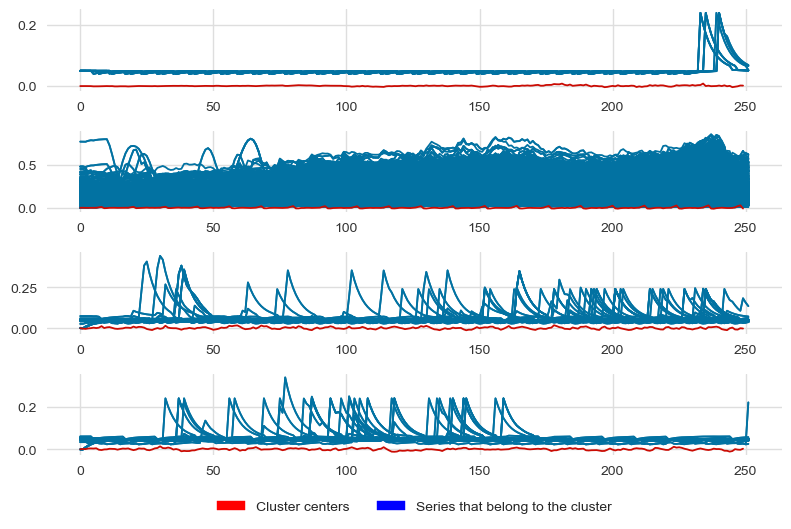

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 2.7896794952026287
It took 6113 seconds to fit the clustering algorithm and do the predictions.


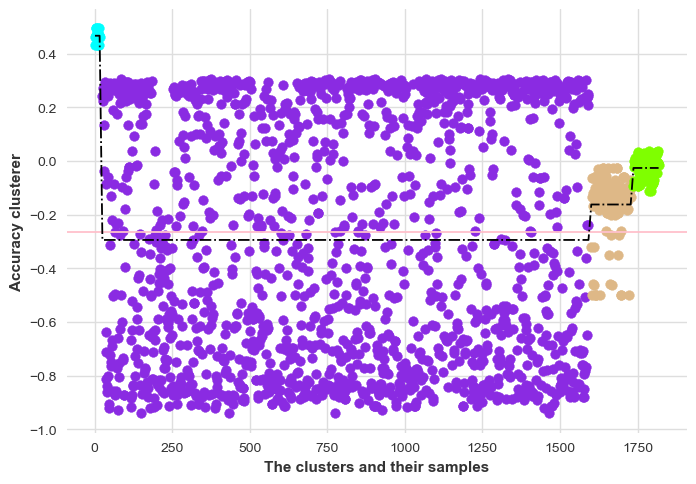

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


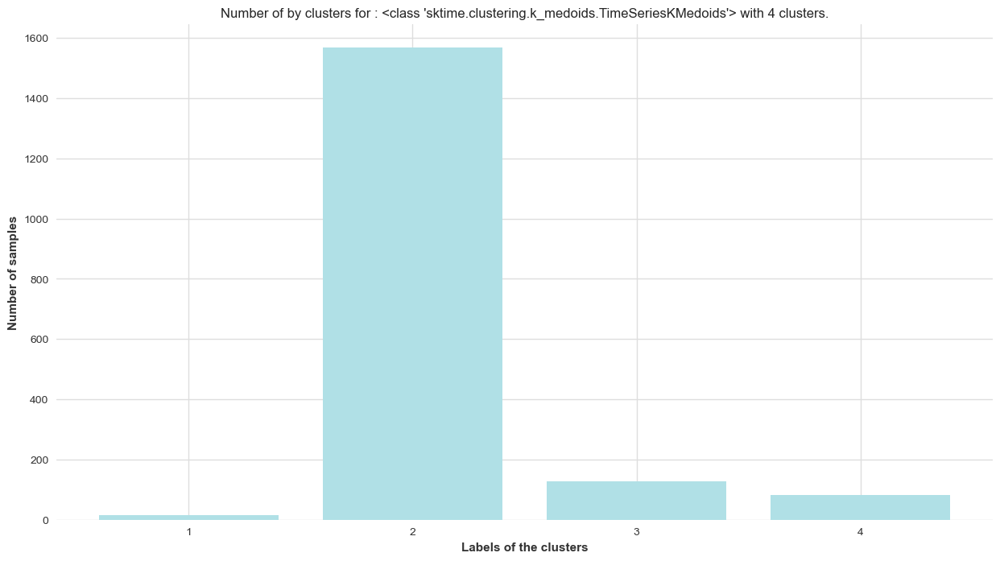

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


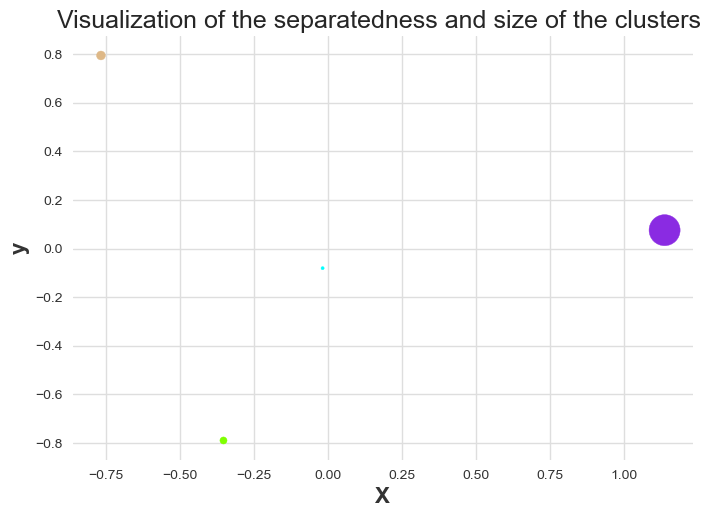

It took 8 seconds to compute visualize on a surface the clusters and the distance between the centroids.


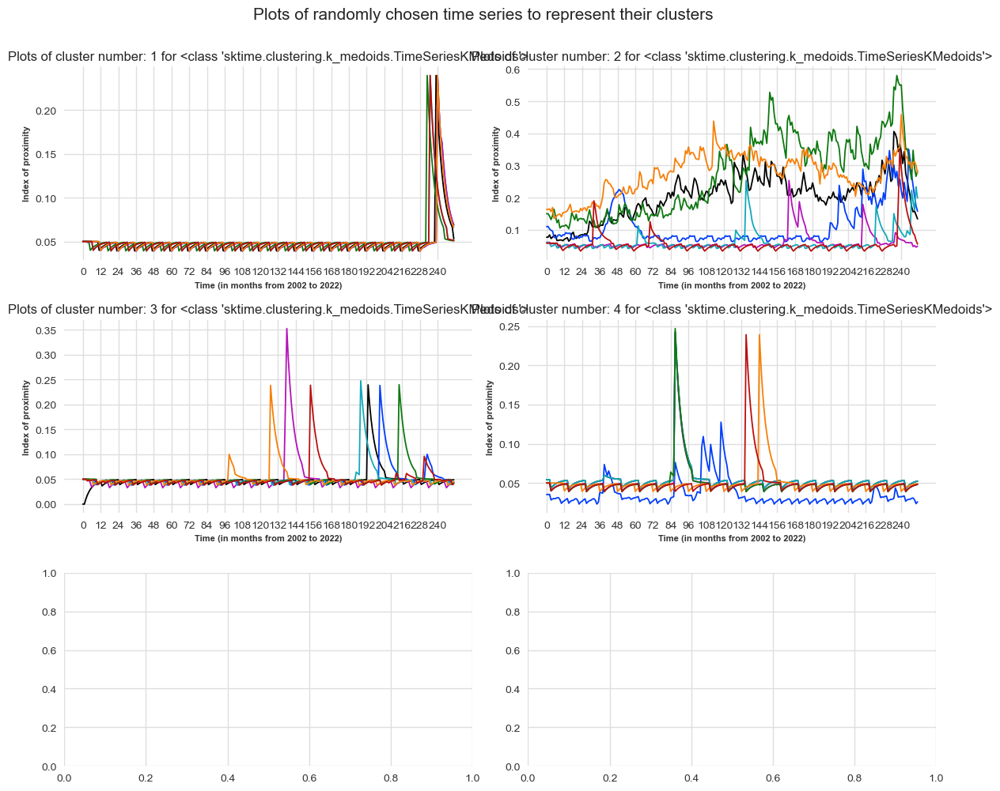

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 5 clusters are:
Iteration 0, inertia 3.036378875493115.
Iteration 1, inertia 2.9405734770990684.
Iteration 2, inertia 2.989004700632684.
Iteration 3, inertia 2.9853733444944384.
Iteration 0, inertia 2.8871233765162607.
Iteration 1, inertia 2.8738584723478917.
Iteration 2, inertia 2.884445864778689.
Iteration 3, inertia 2.8529777789505006.
Iteration 4, inertia 2.844165319213021.
Iteration 5, inertia 2.826380573741556.
Iteration 6, inertia 2.8119067319848097.
Iteration 7, inertia 2.8062075431502858.
Iteration 0, inertia 3.2063430308489203.
Iteration 1, inertia 2.8477074647390554.
Iteration 2, inertia 2.8200296087134165.
Iteration 3, inertia 2.823399876551208.
Iteration 0, inertia 2.8514326551195666.
Iteration 1, inertia 2.8573100684268433.
Iteration 2, inertia 2.8183283968696804.
Iteration 3, inertia 2.805456405601672.
Iteration 0, inertia 2.8

<Figure size 500x1000 with 0 Axes>

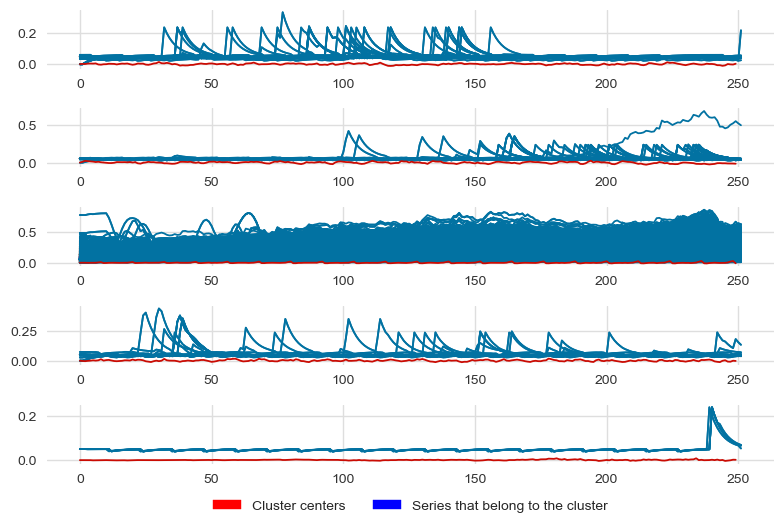

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 2.730998210524737
It took 6288 seconds to fit the clustering algorithm and do the predictions.


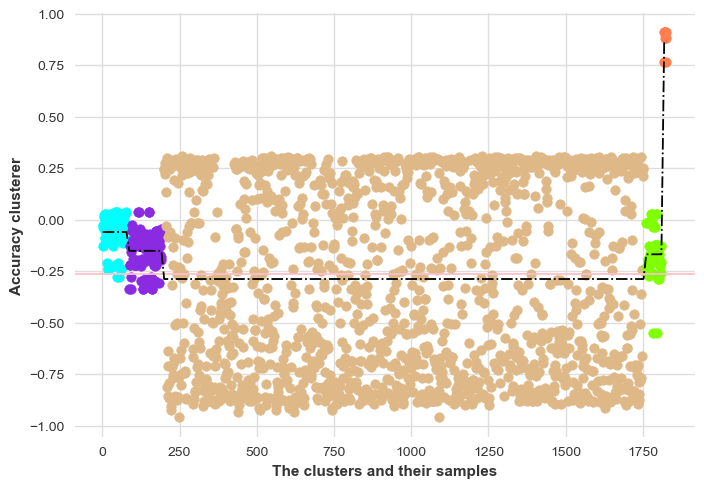

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


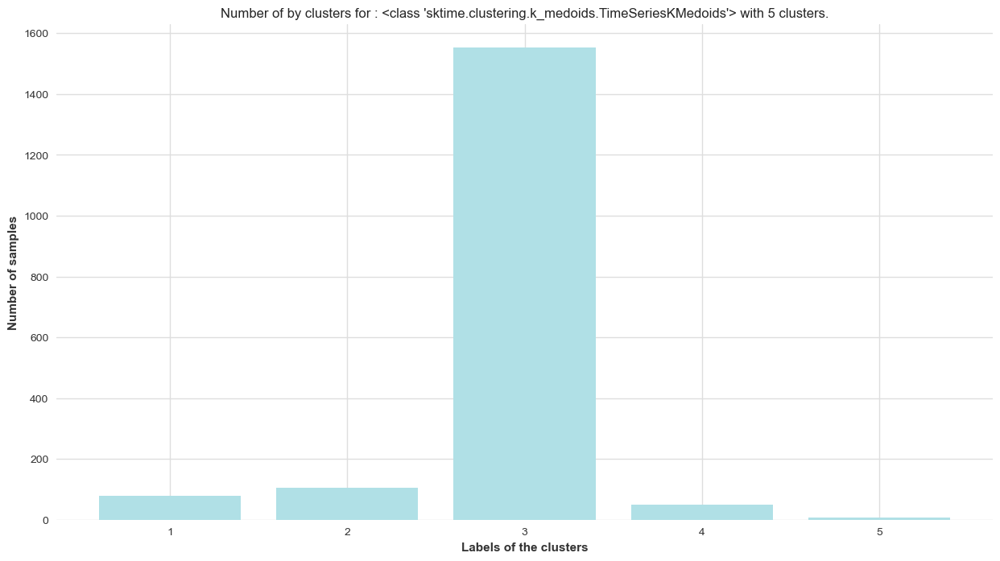

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


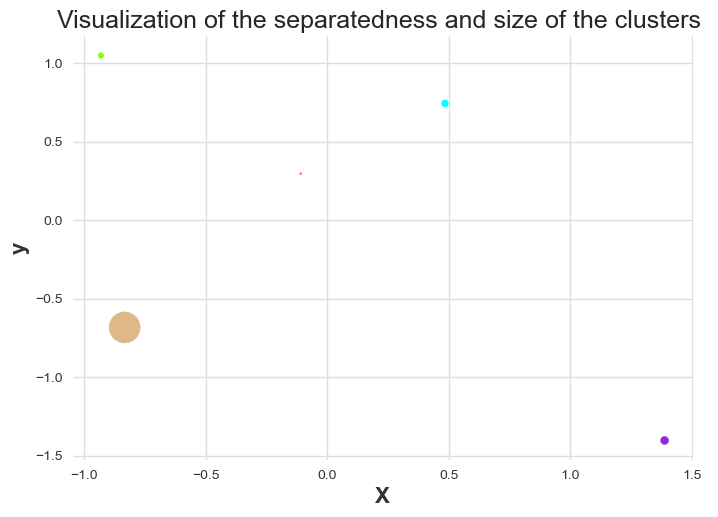

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


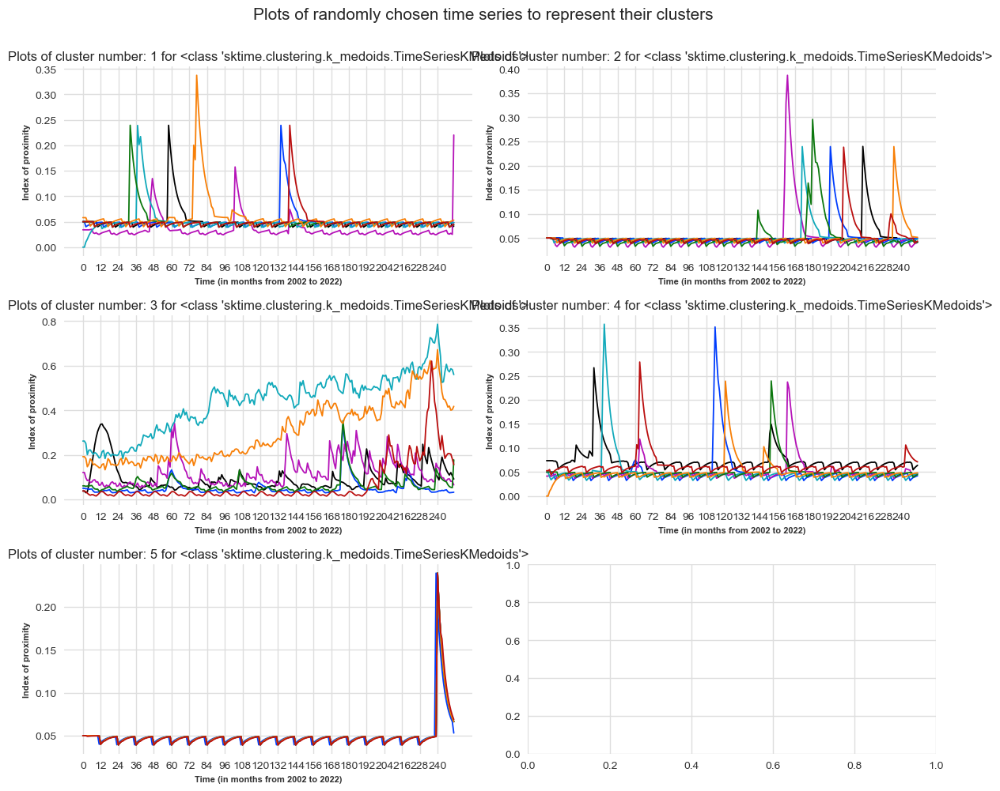

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 6 clusters are:
Iteration 0, inertia 2.990210089949564.
Iteration 1, inertia 2.8391194826385844.
Iteration 2, inertia 2.7949240711058487.
Iteration 3, inertia 2.7842157626495254.
Iteration 4, inertia 2.7527036099045916.
Iteration 5, inertia 2.7670128200301365.
Iteration 0, inertia 2.866264208339465.
Iteration 1, inertia 2.7992662625930333.
Iteration 2, inertia 2.7827472814772296.
Iteration 3, inertia 2.765929383361102.
Iteration 0, inertia 2.8218804460936573.
Iteration 1, inertia 2.677146129840194.
Iteration 2, inertia 2.6872088739690723.
Iteration 0, inertia 2.9621256207450983.
Iteration 1, inertia 2.8403895185755115.
Iteration 2, inertia 2.8403931115897105.
Iteration 0, inertia 2.921004300909945.
Iteration 1, inertia 2.911315631734266.
Iteration 2, inertia 2.909654875085753.
Iteration 0, inertia 2.8792229372188074.
Iteration 1, inertia 2.7

<Figure size 500x1000 with 0 Axes>

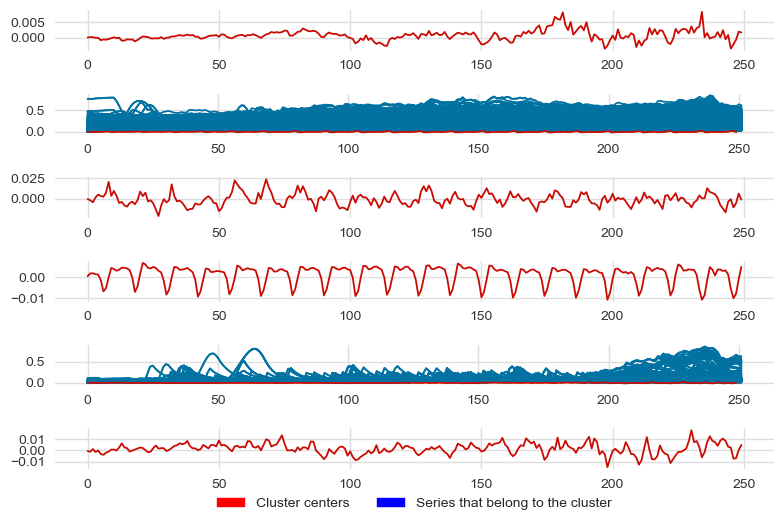

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 2.66072090400355
It took 6488 seconds to fit the clustering algorithm and do the predictions.


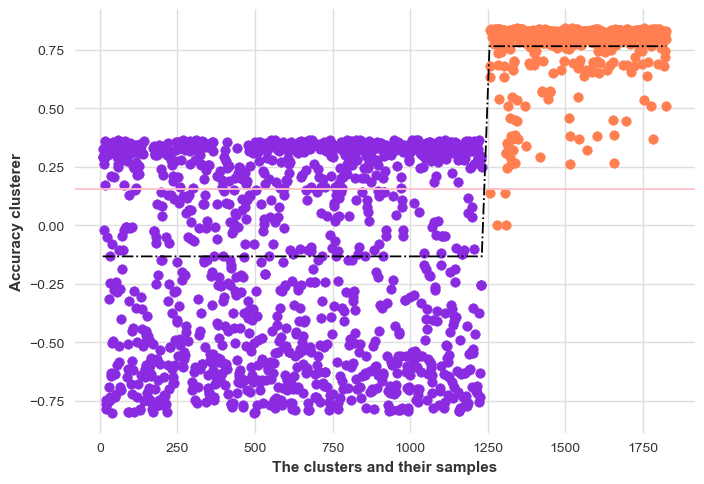

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


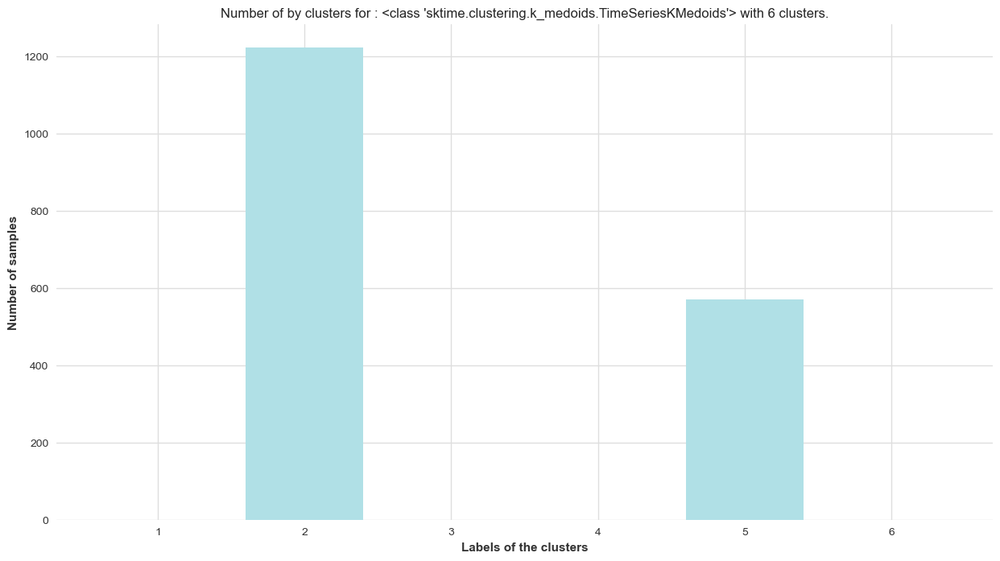

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


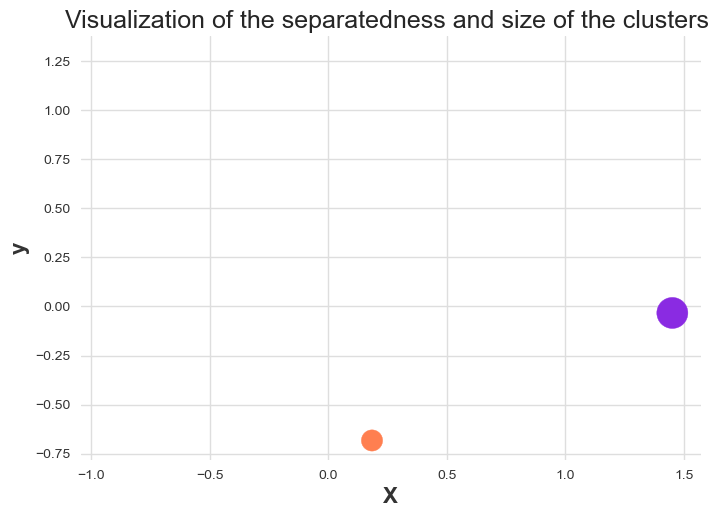

It took 8 seconds to compute visualize on a surface the clusters and the distance between the centroids.


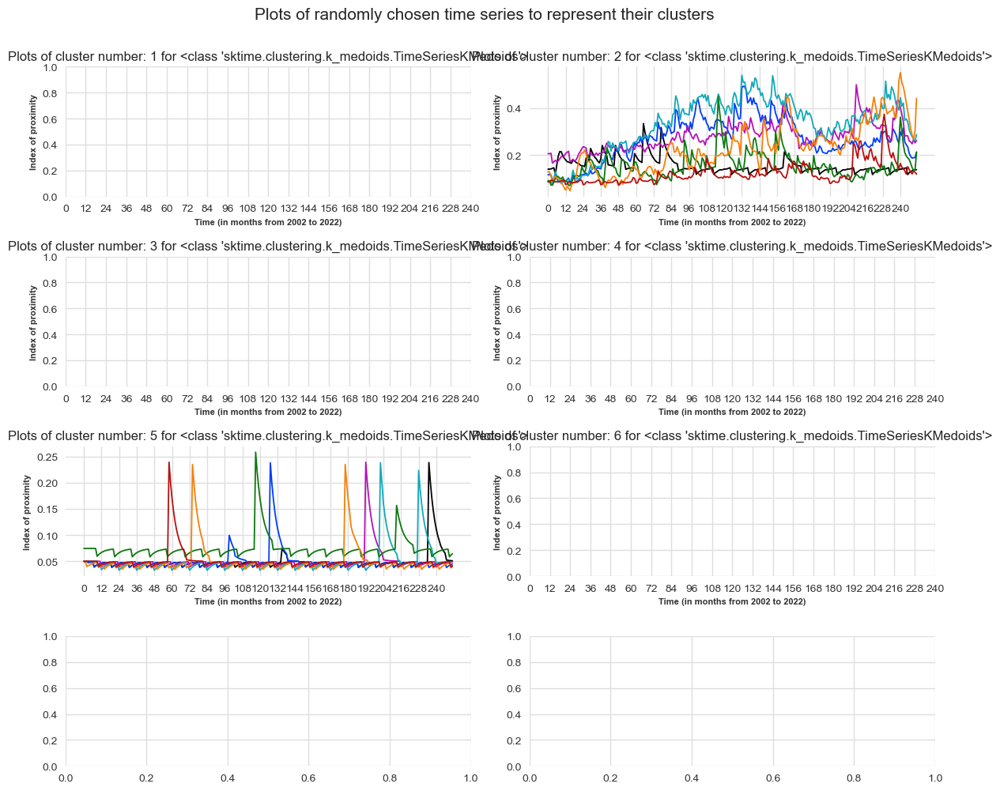

It took 1 seconds to plot the chosen time series.
 


  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 4 clusters are:
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.00033797150437902835
It took 31 seconds to fit the clustering algorithm and do the predictions.


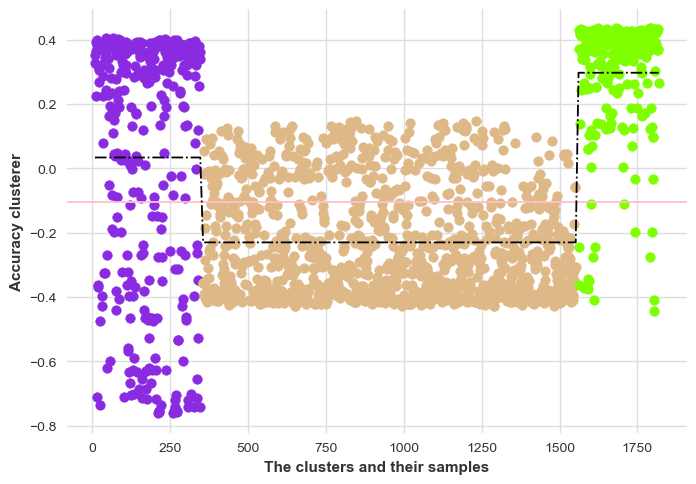

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


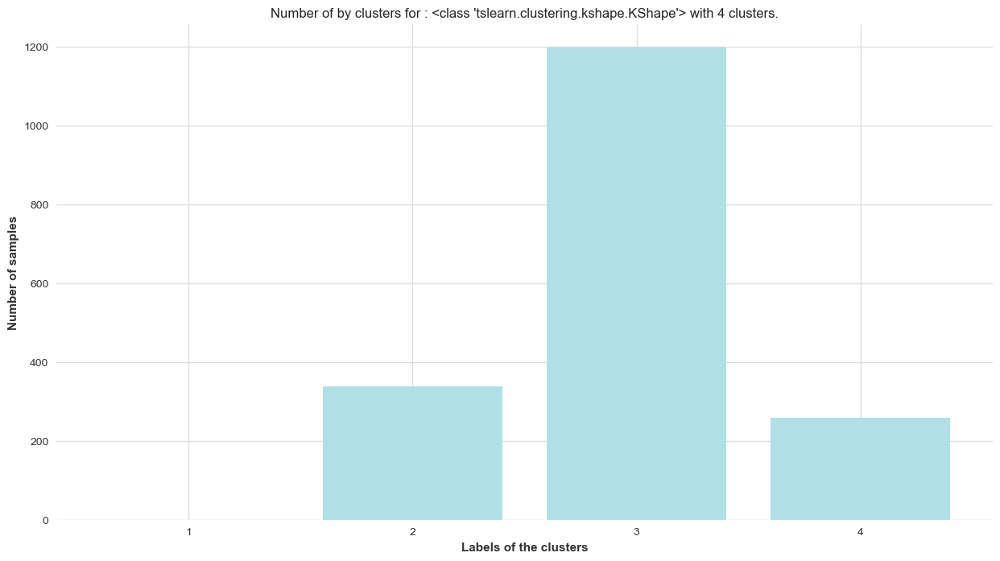

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


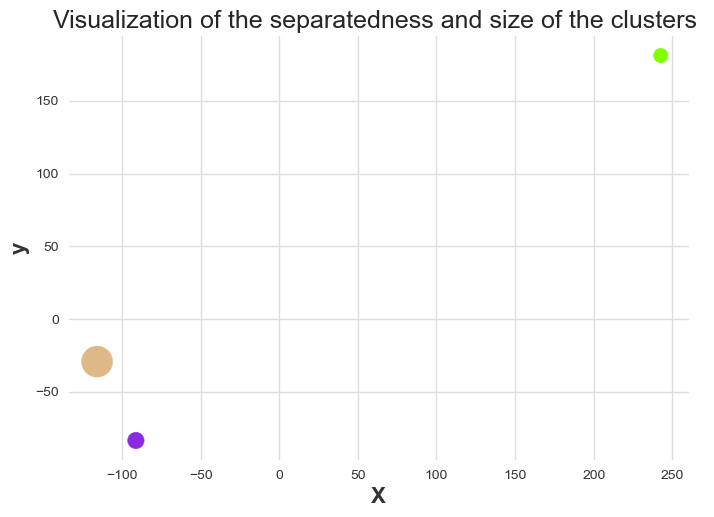

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


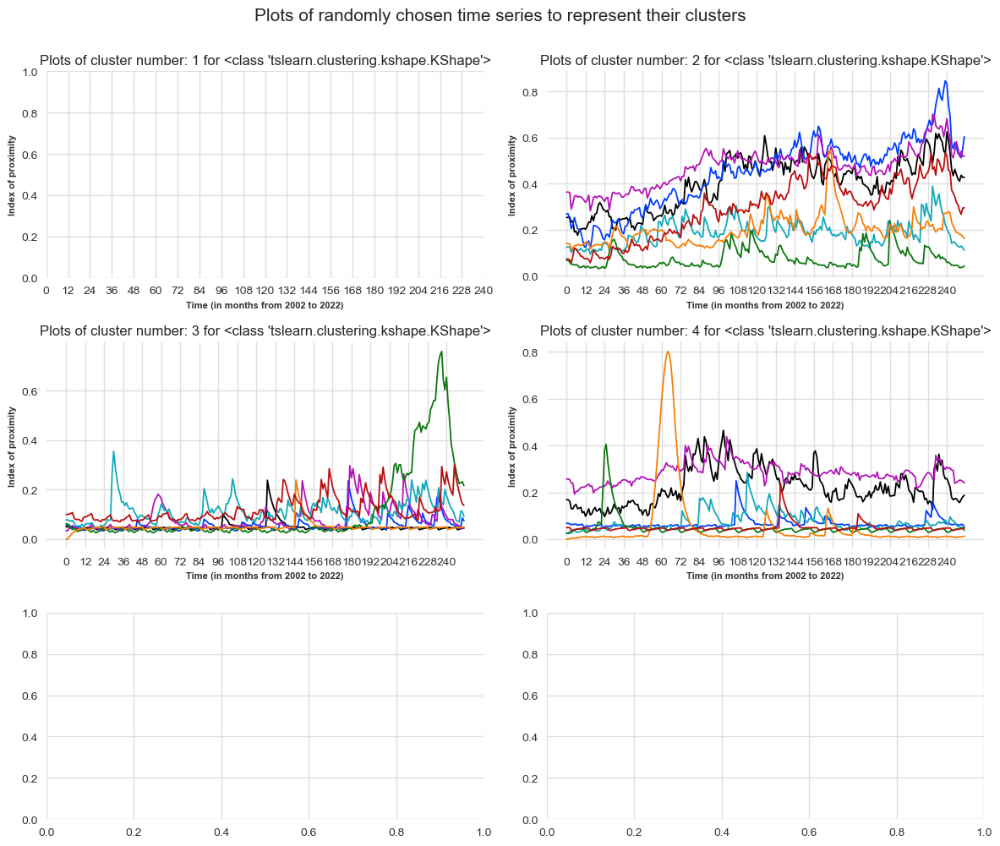

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 5 clusters are:
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.0004880957137132051
It took 37 seconds to fit the clustering algorithm and do the predictions.


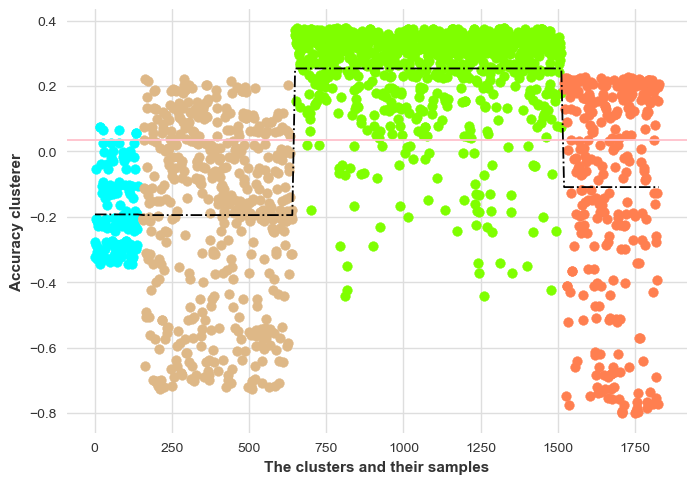

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


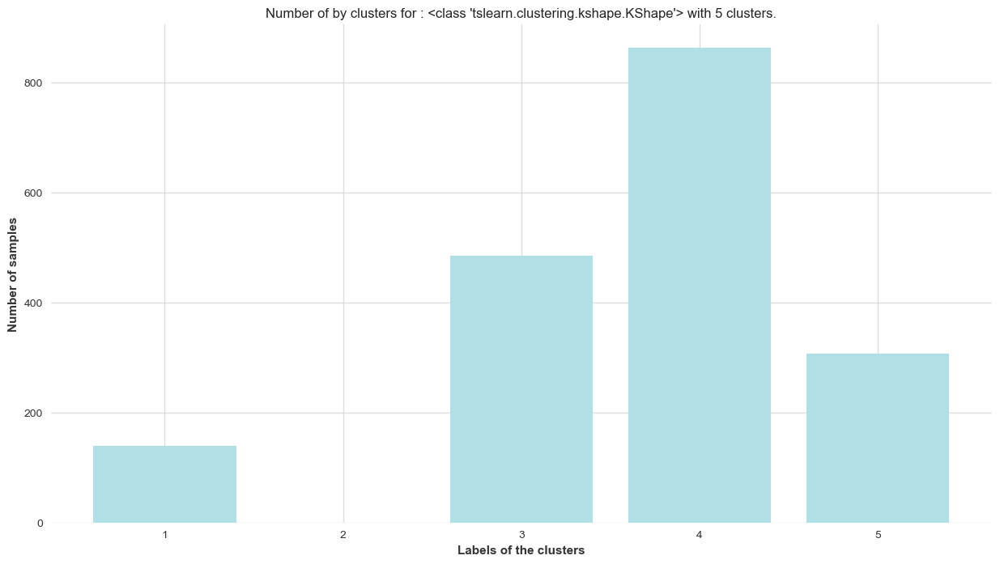

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


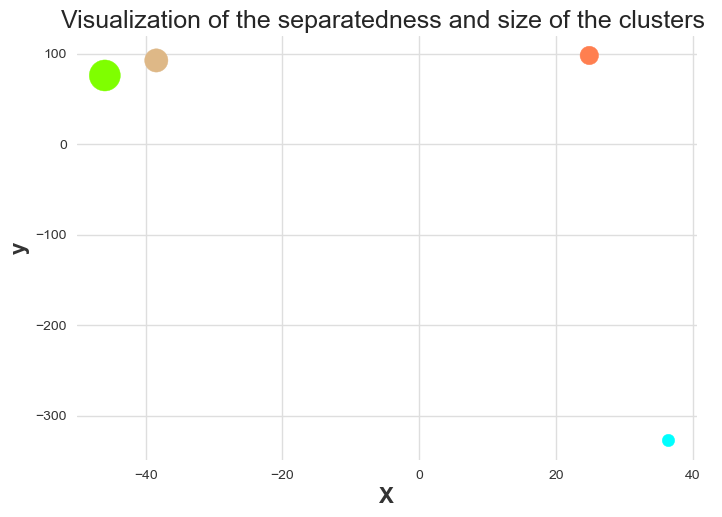

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


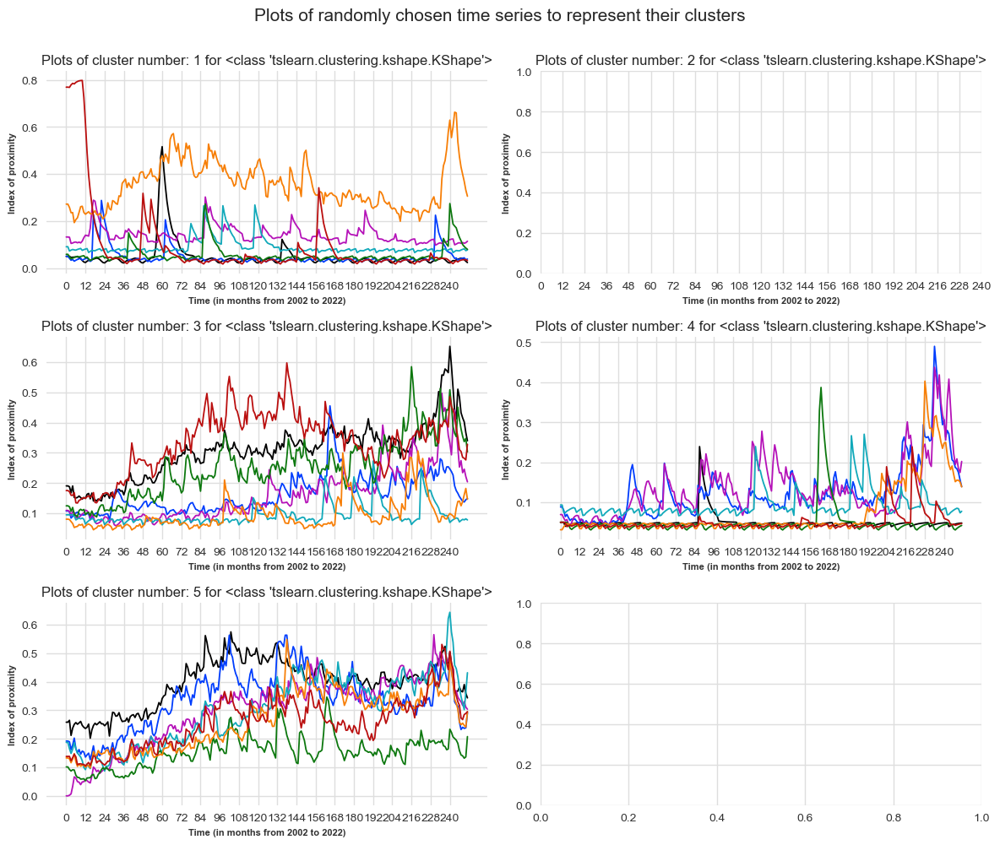

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 6 clusters are:
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.0012608930830646293
It took 44 seconds to fit the clustering algorithm and do the predictions.


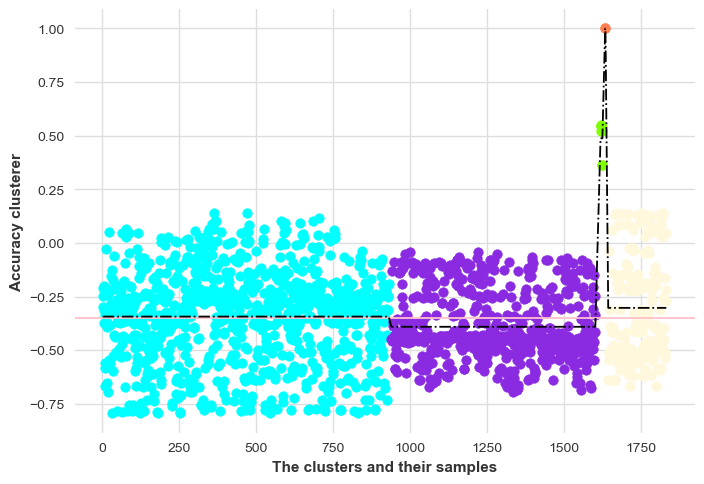

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


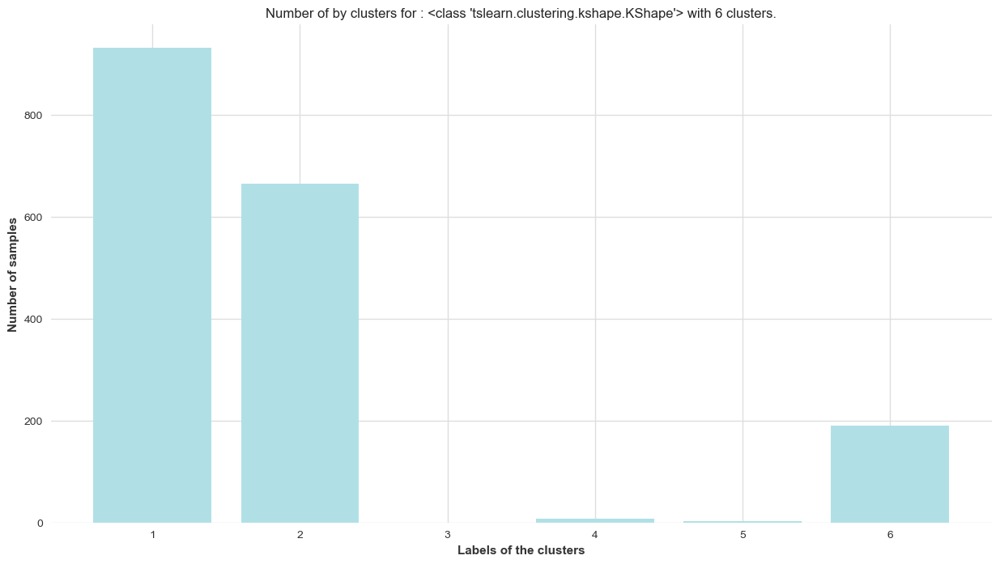

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


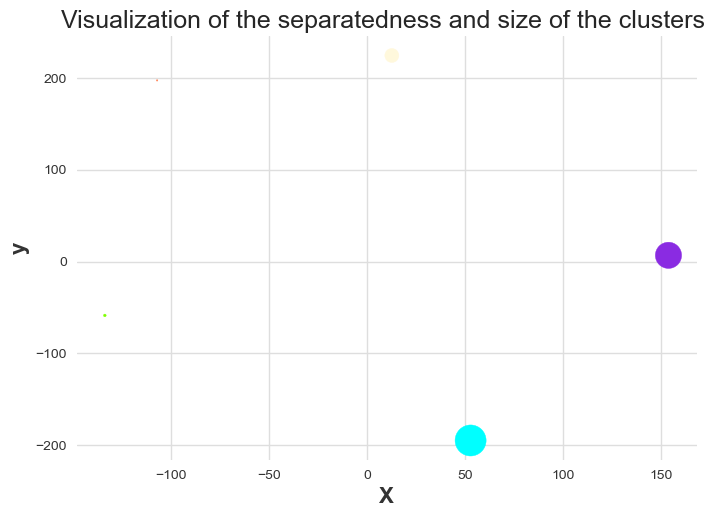

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


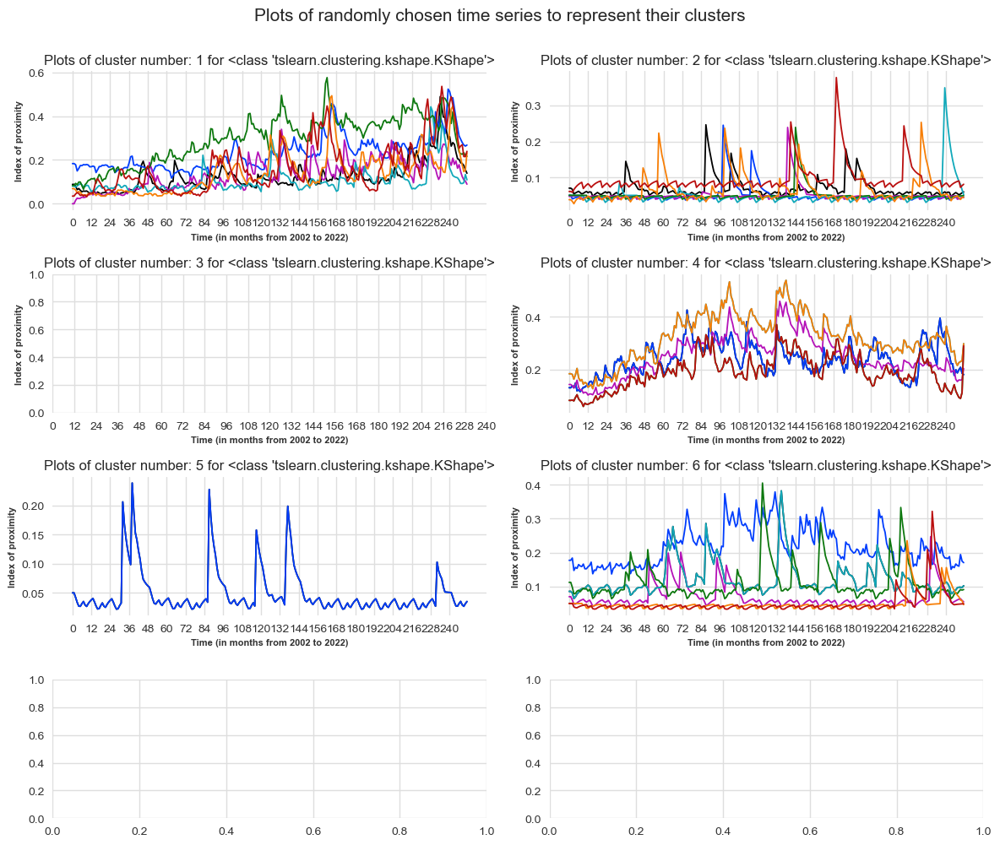

It took 1 seconds to plot the chosen time series.
 


  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 4 clusters are:
Init 1
180398.907 --> 187627.161 --> 188143.015 --> 188287.997 --> 188411.001 --> 188498.944 --> 188557.725 --> 188607.872 --> 188635.851 --> 188651.934 --> 
Init 2
185906.196 --> 188308.297 --> 188593.826 --> 188657.476 --> 188676.690 --> 188682.794 --> 188684.960 --> 188685.744 --> 188686.129 --> 188686.177 --> 
Init 3
183533.197 --> 186369.836 --> 187374.793 --> 187964.496 --> 188177.057 --> 188305.409 --> 188403.703 --> 188461.306 --> 188498.129 --> 188525.630 --> 
Init 4
183583.401 --> 187884.588 --> 188365.083 --> 188469.982 --> 188526.399 --> 188561.364 --> 188585.222 --> 188606.305 --> 188619.003 --> 188629.162 --> 
Init 5
183984.883 --> 187042.020 --> 187711.117 --> 188017.648 --> 188196.775 --> 188318.468 --> 188410.415 --> 188465.402 --> 188502.274 --> 188528.633 --> 
Init 6
185221.576 --> 188234.452 --> 188603.595 --> 188650.051 --> 188668.094 --> 188677.599 --> 188681

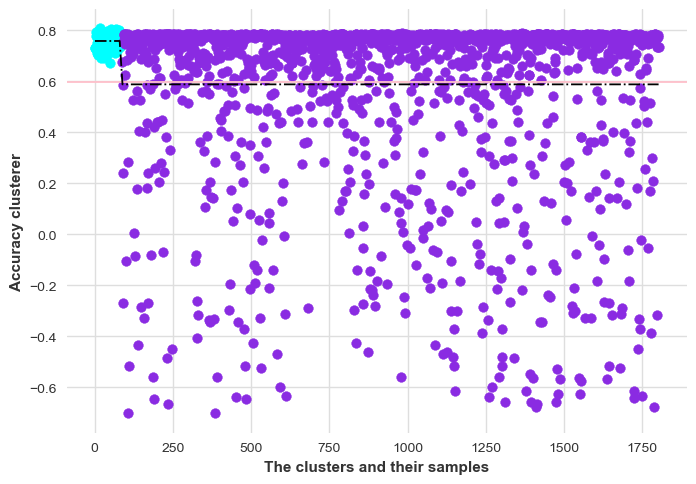

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


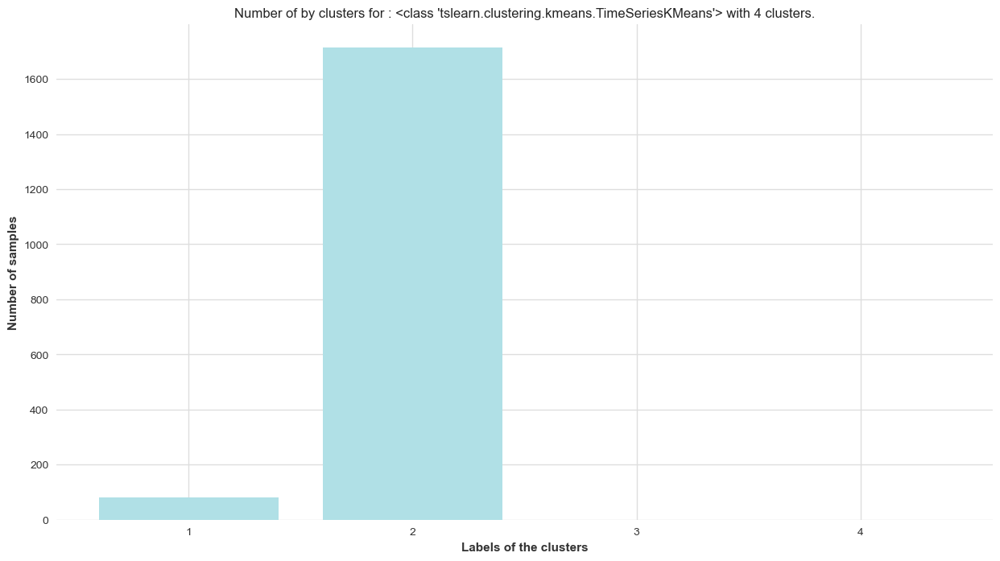

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


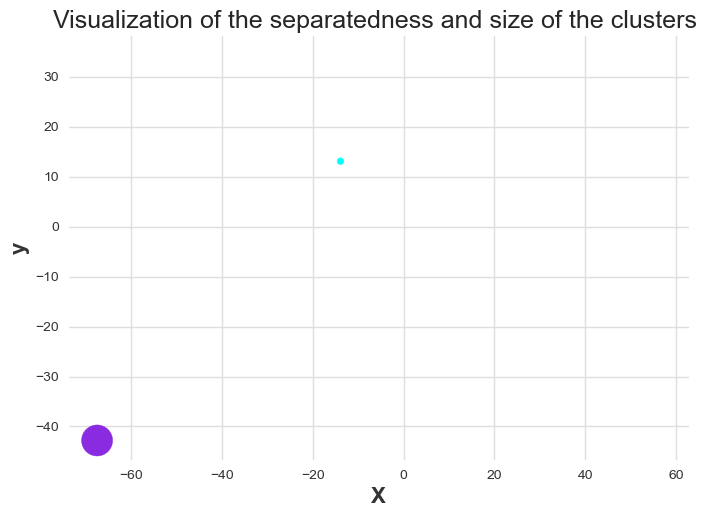

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


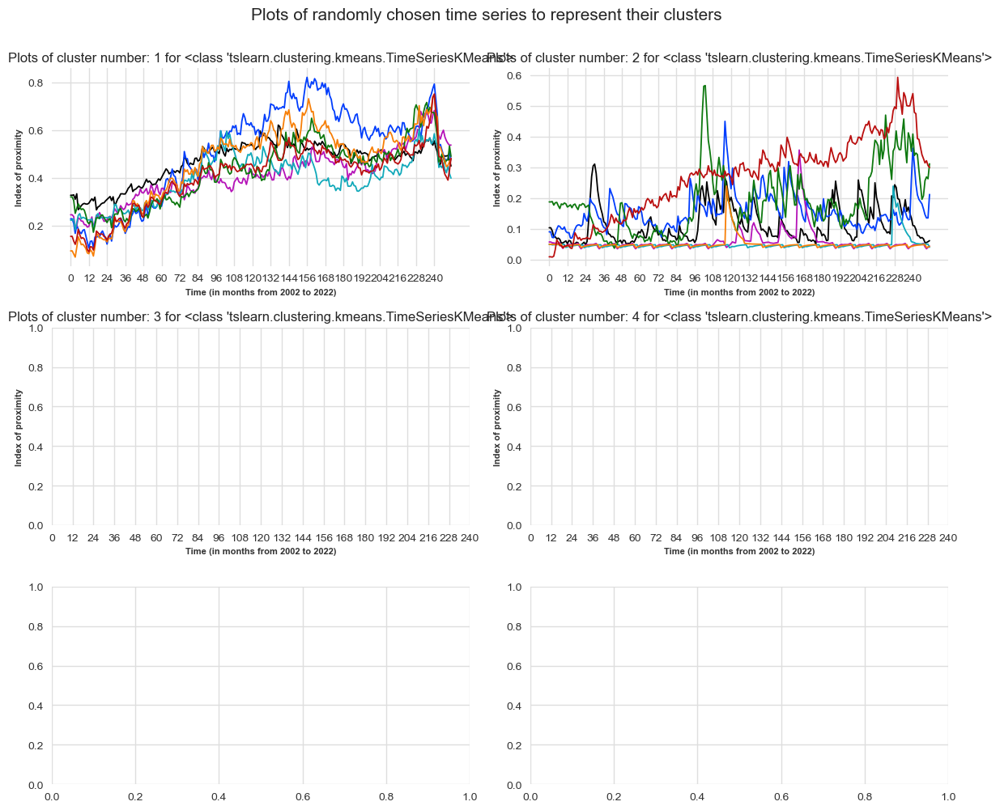

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 5 clusters are:
Init 1
185908.140 --> 188692.866 --> 188967.200 --> 189038.551 --> 189077.695 --> 189106.375 --> 189125.479 --> 189143.057 --> 189157.062 --> 189164.184 --> 
Init 2
185803.766 --> 188602.117 --> 189097.762 --> 189211.840 --> 189271.813 --> 189309.034 --> 189328.083 --> 189339.984 --> 189348.001 --> 189355.414 --> 
Init 3
187024.630 --> 188695.945 --> 189021.925 --> 189143.283 --> 189203.096 --> 189249.628 --> 189286.470 --> 189307.651 --> 189321.975 --> 189330.845 --> 
Init 4
179781.130 --> 187857.751 --> 188531.516 --> 188781.920 --> 188946.695 --> 189073.399 --> 189158.092 --> 189211.596 --> 189255.445 --> 189287.436 --> 
Init 5
186612.976 --> 188788.428 --> 188906.435 --> 188941.306 --> 188986.427 --> 189041.291 --> 189086.893 --> 189121.240 --> 189142.280 --> 189153.555 --> 
Init 6
185073.160 --> 187940.565 --> 188760.691 -->

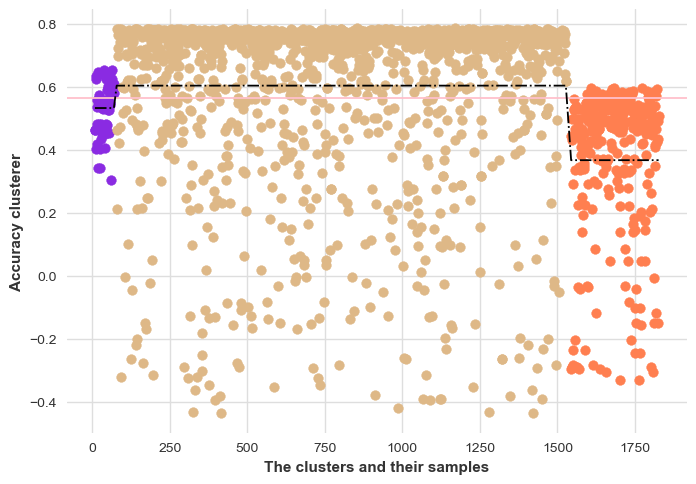

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


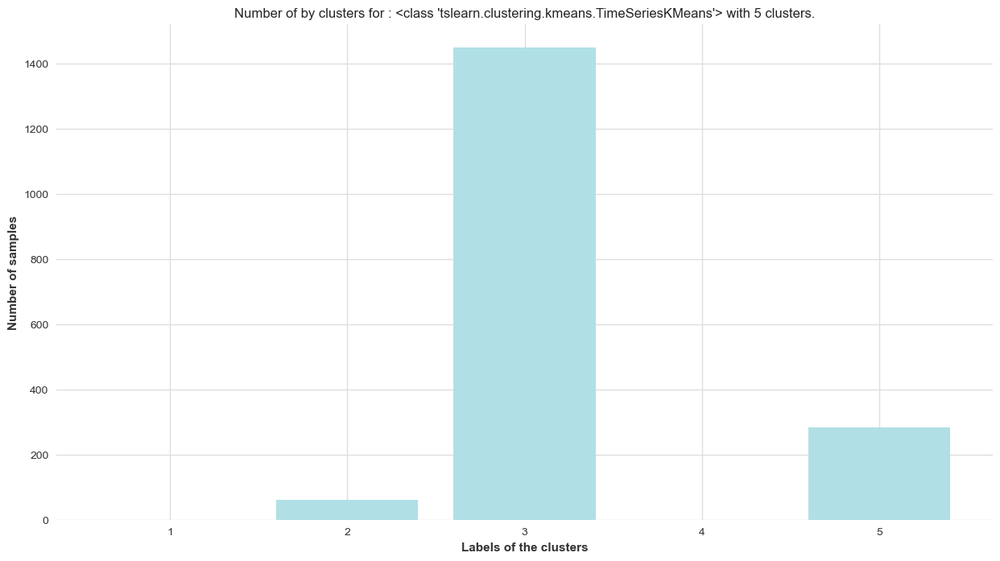

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


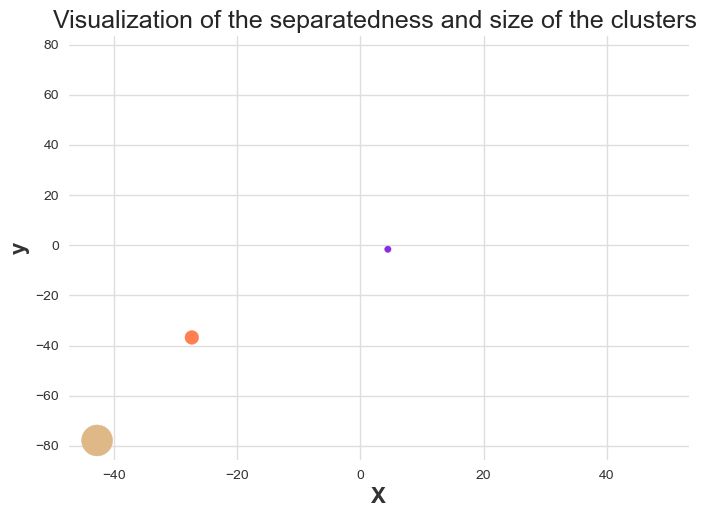

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


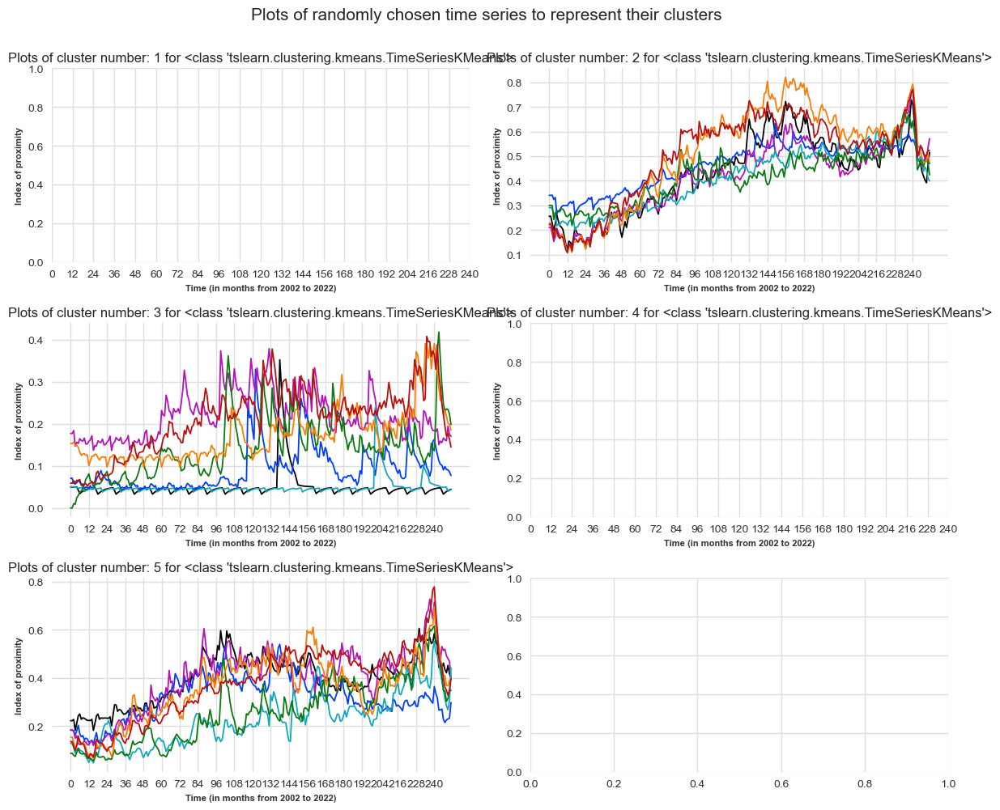

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 6 clusters are:
Init 1
186093.769 --> 189023.373 --> 189421.311 --> 189575.320 --> 189675.808 --> 189787.385 --> 189867.089 --> 189895.868 --> 189906.552 --> 189910.125 --> 
Init 2
186889.765 --> 189349.773 --> 189455.232 --> 189493.618 --> 189516.417 --> 189532.275 --> 189545.631 --> 189558.324 --> 189572.849 --> 189588.265 --> 
Init 3
188433.596 --> 189502.018 --> 189666.299 --> 189816.019 --> 189881.410 --> 189904.796 --> 189909.101 --> 189911.162 --> 189911.746 --> 189912.019 --> 
Init 4
187385.611 --> 189328.489 --> 189515.582 --> 189571.208 --> 189602.917 --> 189632.649 --> 189660.551 --> 189693.885 --> 189738.242 --> 189792.245 --> 
Init 5
186845.852 --> 189206.520 --> 189416.994 --> 189618.902 --> 189744.902 --> 189807.756 --> 189843.619 --> 189865.274 --> 189876.817 --> 189882.398 --> 
Init 6
185764.231 --> 188967.435 --> 189226.515 -->

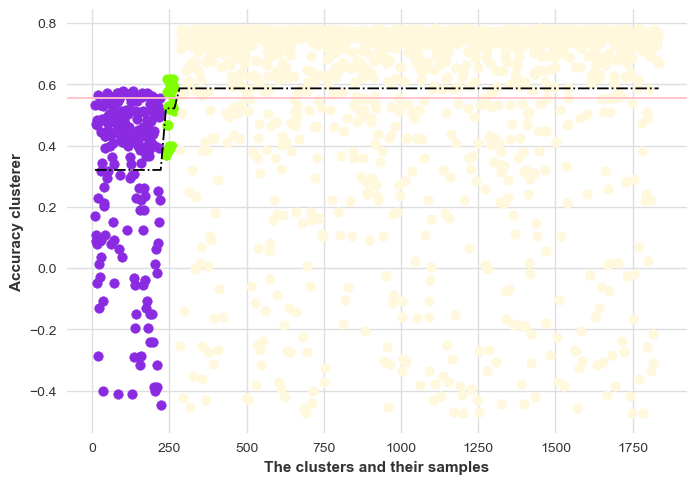

It took 2 seconds to compute the silhouette score and to visualize it as a scatter plot.


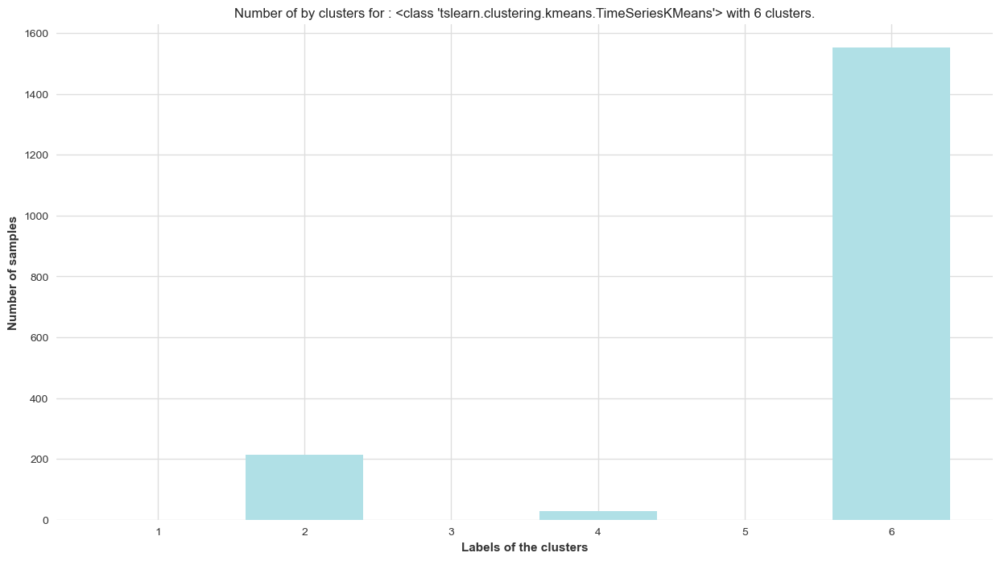

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


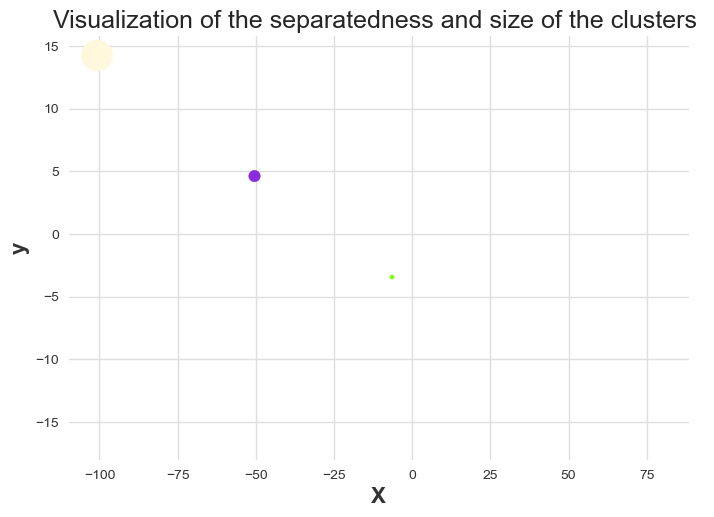

It took 9 seconds to compute visualize on a surface the clusters and the distance between the centroids.


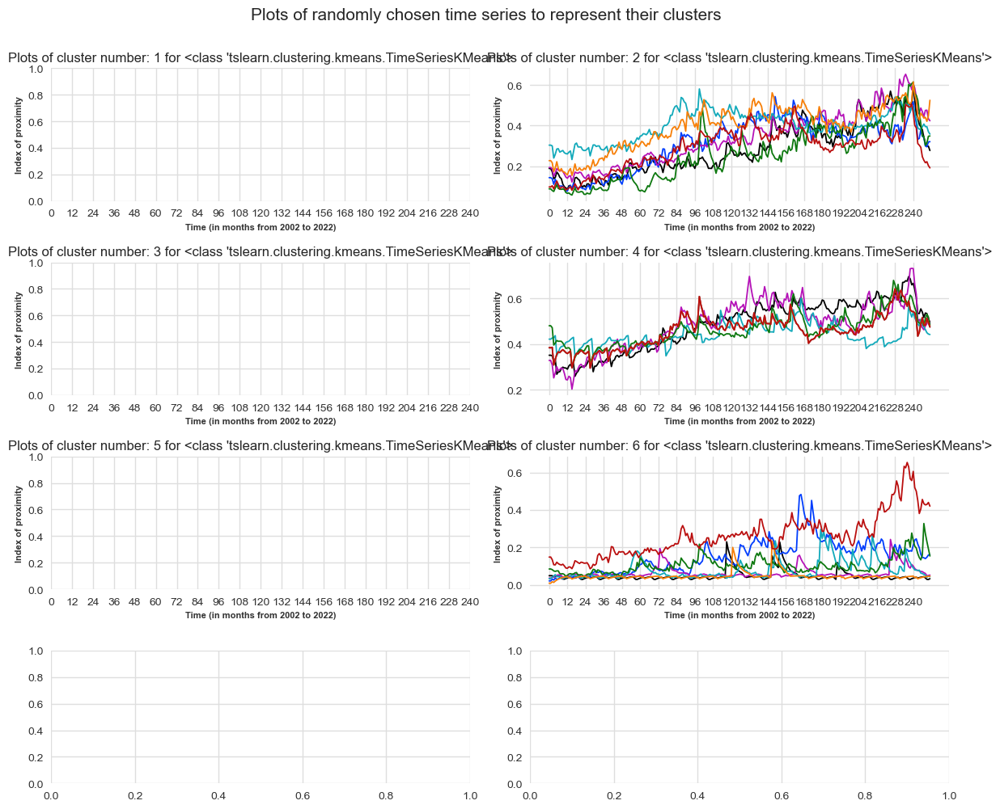

It took 2 seconds to plot the chosen time series.
 


In [227]:
for algo in listalgos:
    for num_cluster in tqdm(listclusters):
        print('The results for the algorithm : '+str(algo)+' using '+str(num_cluster)+' clusters are:')
        myclusterer = evaluate_clusterer(algo,dftraincluster[:5000], dfcluster,n_clusters=num_cluster, init_algorithm="kmeans++", max_iter=10,\
        metric="wddtw",random_state=1, n_init=10,distance_viz='l1',colors=colors)

Considering the different indicators, TimeSeriesKmedoids, TimeSeriesKmeans and KShape were all quite good (except for TimeSeriesKMedois, but this is just do to the lack of data I believe). Nevertheless, with 4 and 6 clusters the results were significantly worse for all algorithms. Once I will have checked everything with my own data, I will fit the algorithms with 5 clusters with all the data I have and see what are the results.

Using my own data to train the clusterer algorithm.

It does not seem to work better fitting the clustering algorithm with my own data actually. Fitting the algorithms with data from outside seems to work just as well, if not better than fitting the algorithms with my own data.

  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 4 clusters are:
Iteration 0, inertia 15.944089355452757.
Iteration 1, inertia 14.600080025688888.
Iteration 0, inertia 16.33592946622472.
Iteration 1, inertia 14.97393398759847.
Iteration 2, inertia 14.843631824665362.
Iteration 0, inertia 15.091184214921308.
Iteration 1, inertia 14.52023342321024.
Iteration 0, inertia 16.140264231557097.
Iteration 1, inertia 14.981715319025415.
Iteration 2, inertia 14.682748806772782.
Iteration 0, inertia 16.225793650041204.
Iteration 1, inertia 15.23303067109141.
Iteration 0, inertia 16.74528969685631.
Iteration 1, inertia 15.038168354859675.
Iteration 2, inertia 14.966668720917937.
Iteration 0, inertia 16.609018374833823.
Iteration 1, inertia 15.046363470962254.
Iteration 2, inertia 14.63838292870436.
Iteration 0, inertia 15.093114145500458.
Iteration 1, inertia 14.70274241676294.
Iteration 2, inertia 14.660444410783573.
Iteration 0, inertia 19.22654217580

<Figure size 500x1000 with 0 Axes>

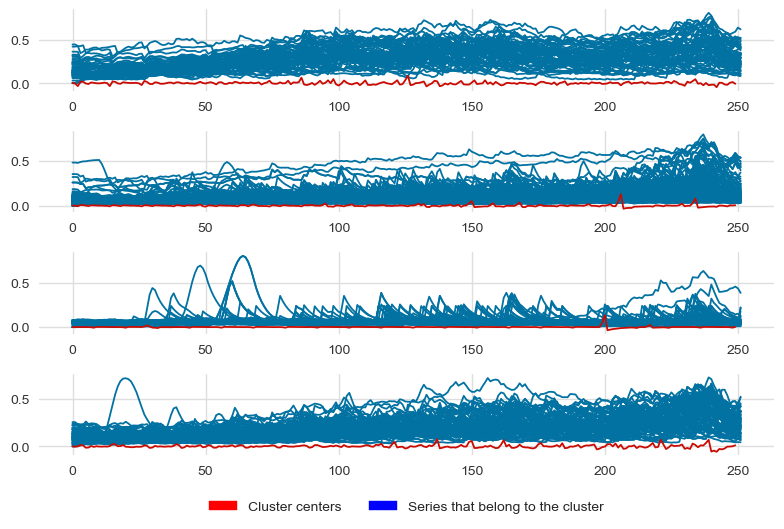

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 14.52023342321024
It took 750 seconds to fit the clustering algorithm and do the predictions.


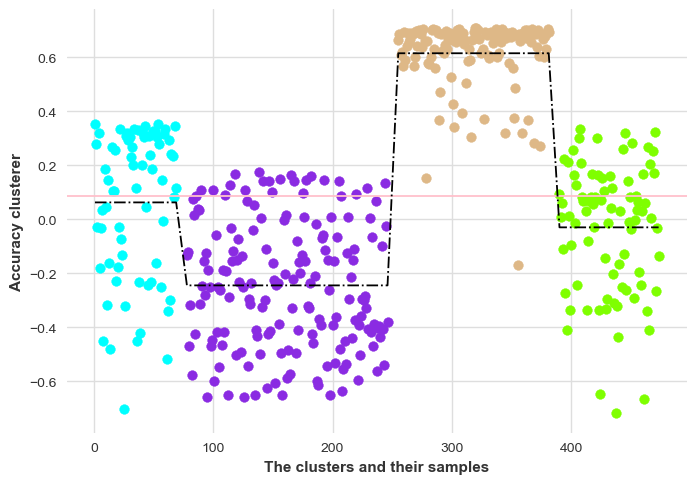

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


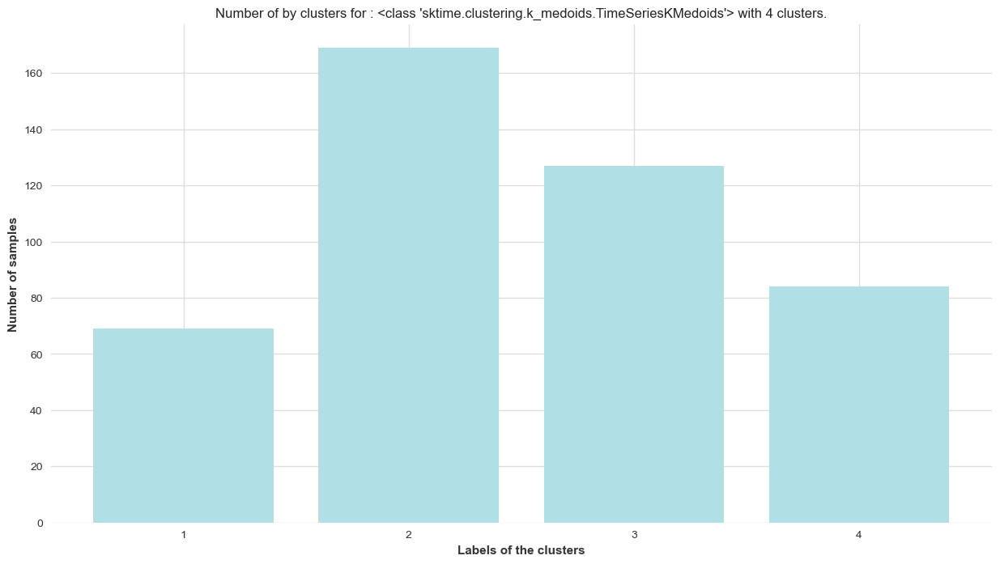

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


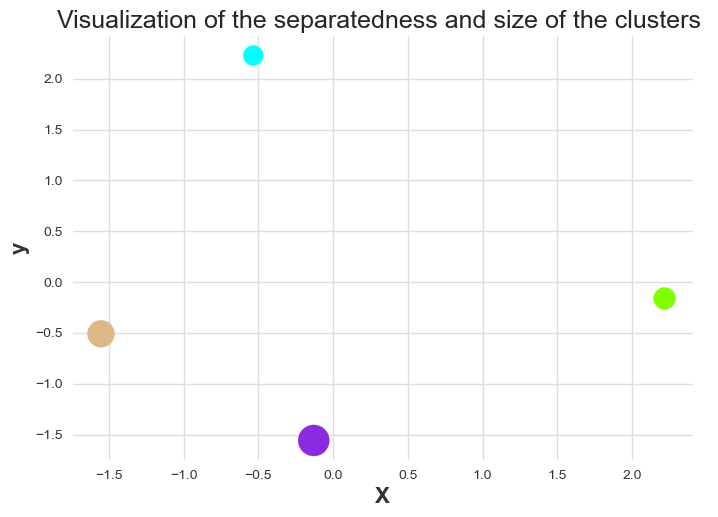

It took 10 seconds to compute visualize on a surface the clusters and the distance between the centroids.


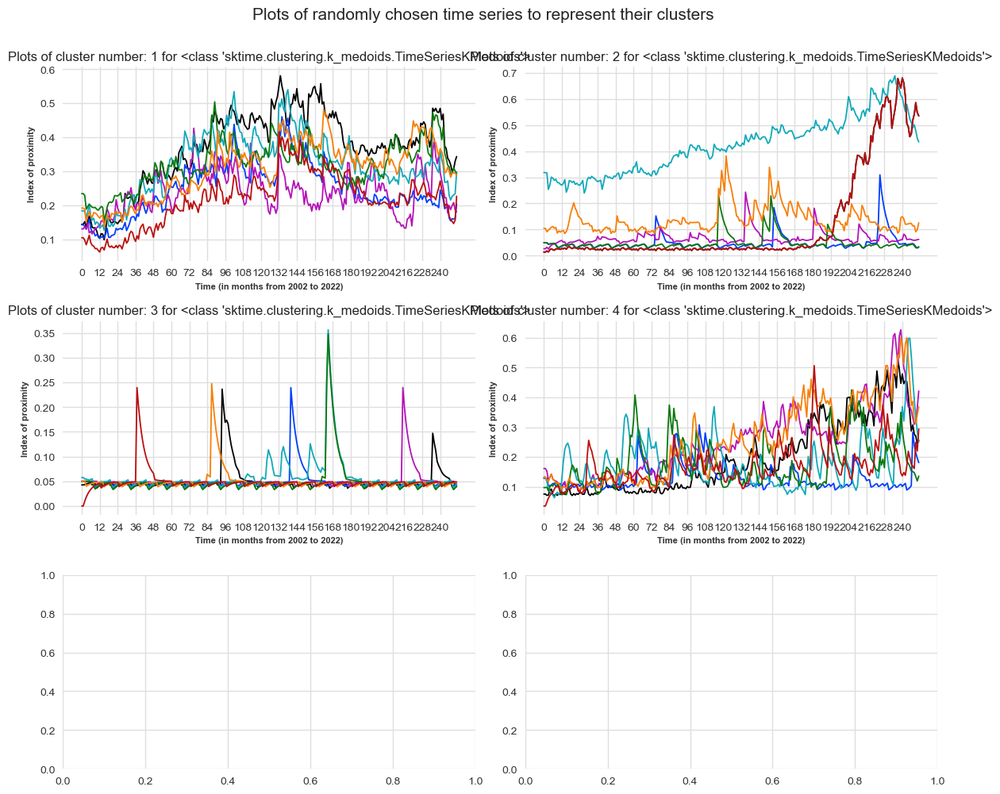

It took 2 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 5 clusters are:
Iteration 0, inertia 15.480715084141735.
Iteration 1, inertia 14.448275137795466.
Iteration 0, inertia 16.661783719130703.
Iteration 1, inertia 15.190066716191307.
Iteration 0, inertia 16.711044247313218.
Iteration 1, inertia 15.53785034985127.
Iteration 2, inertia 15.451127379285673.
Iteration 0, inertia 15.888993474070913.
Iteration 1, inertia 14.517817599555443.
Iteration 2, inertia 14.385191243231644.
Iteration 3, inertia 14.479260127166071.
Iteration 0, inertia 15.928134874214738.
Iteration 1, inertia 14.470178041515767.
Iteration 0, inertia 16.09537657008466.
Iteration 1, inertia 14.33060521967948.
Iteration 2, inertia 14.219182258502531.
Iteration 0, inertia 16.098774430918546.
Iteration 1, inertia 15.02905202687041.
Iteration 2, inertia 14.534379883465805.
Iteration 0, inertia 16.597805842743682.
Iteration 1, inertia 

<Figure size 500x1000 with 0 Axes>

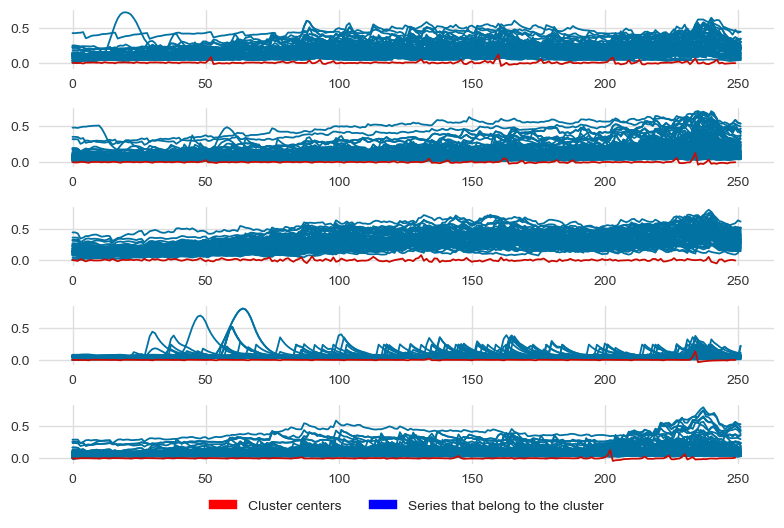

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 14.219182258502531
It took 790 seconds to fit the clustering algorithm and do the predictions.


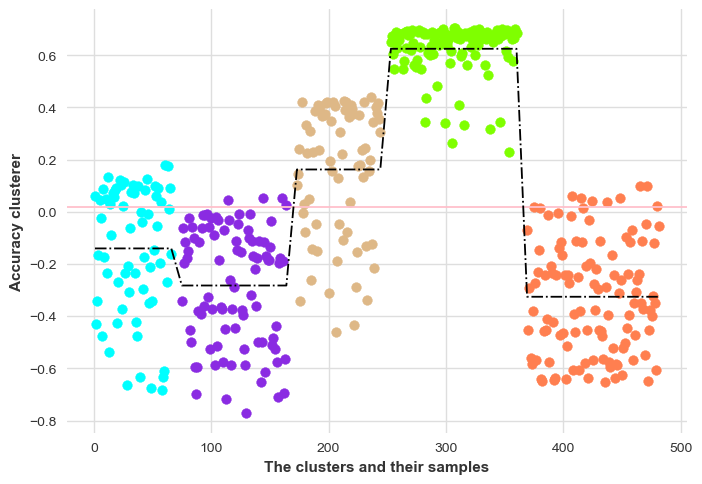

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


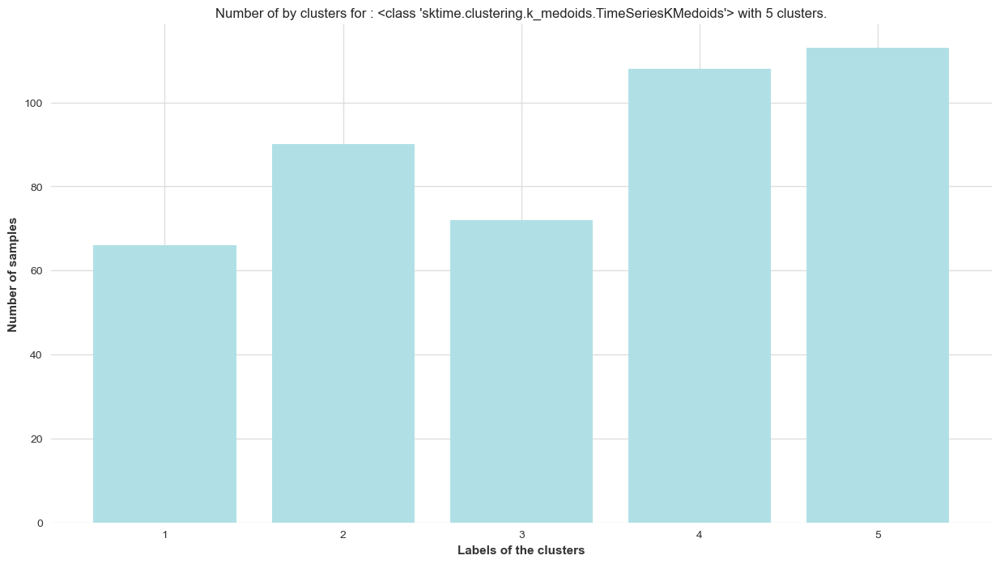

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


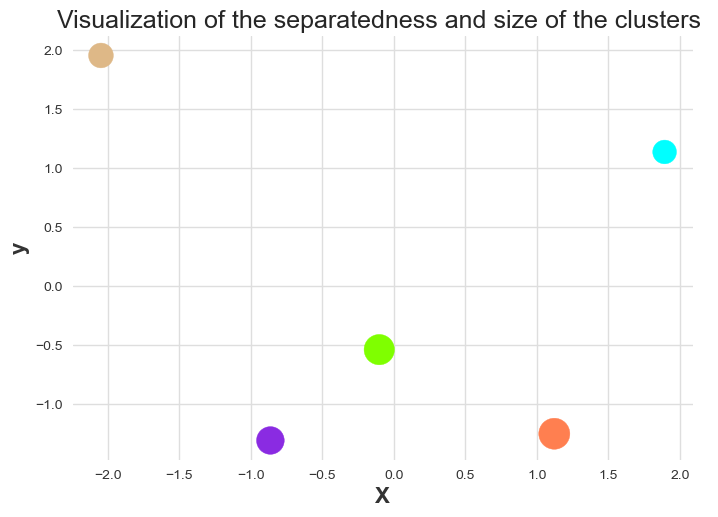

It took 8 seconds to compute visualize on a surface the clusters and the distance between the centroids.


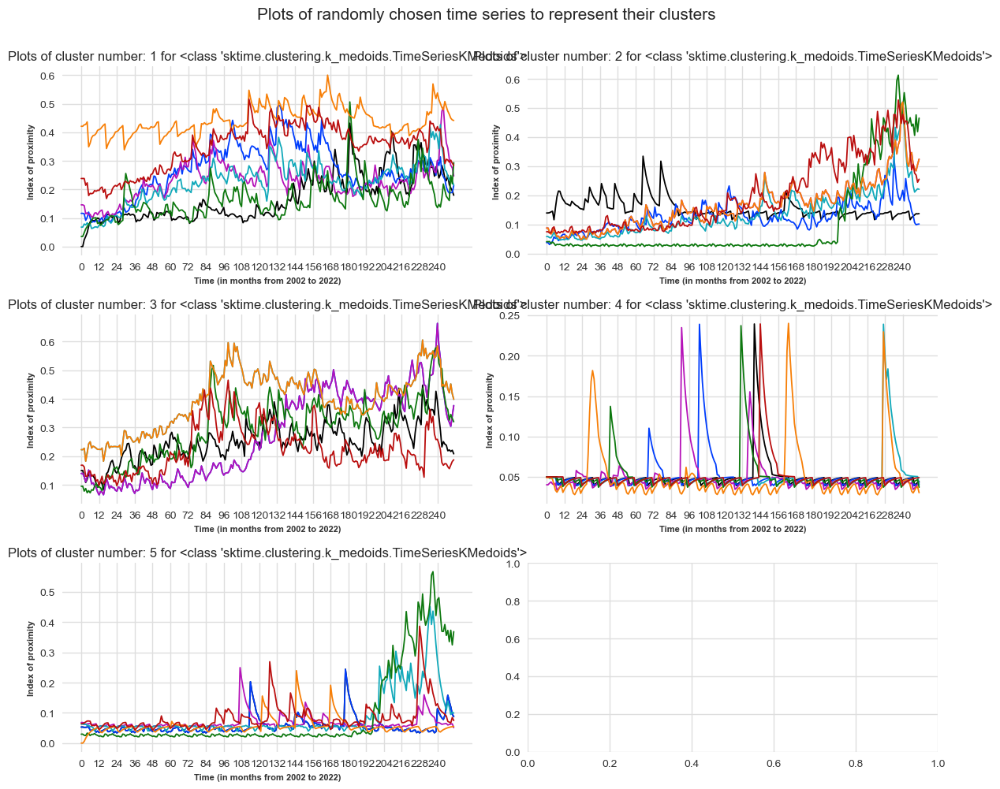

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 6 clusters are:
Iteration 0, inertia 15.312789992610627.
Iteration 1, inertia 14.092840153730354.
Iteration 0, inertia 15.402310835136033.
Iteration 1, inertia 14.08778357895179.
Iteration 0, inertia 15.097026996946438.
Iteration 1, inertia 14.353558205599715.
Iteration 2, inertia 14.226896854989363.
Iteration 0, inertia 16.30229927537728.
Iteration 1, inertia 14.248323800297939.
Iteration 2, inertia 14.183828507118871.
Iteration 0, inertia 16.65667715202678.
Iteration 1, inertia 14.093054315852678.
Iteration 2, inertia 13.863320408904062.
Iteration 0, inertia 16.926818243277992.
Iteration 1, inertia 14.645976292722853.
Iteration 2, inertia 14.454903820319265.
Iteration 3, inertia 14.325742205583092.
Iteration 0, inertia 15.92122596155021.
Iteration 1, inertia 14.220828966744293.
Iteration 2, inertia 14.146265299365332.
Iteration 3, inertia 

<Figure size 500x1000 with 0 Axes>

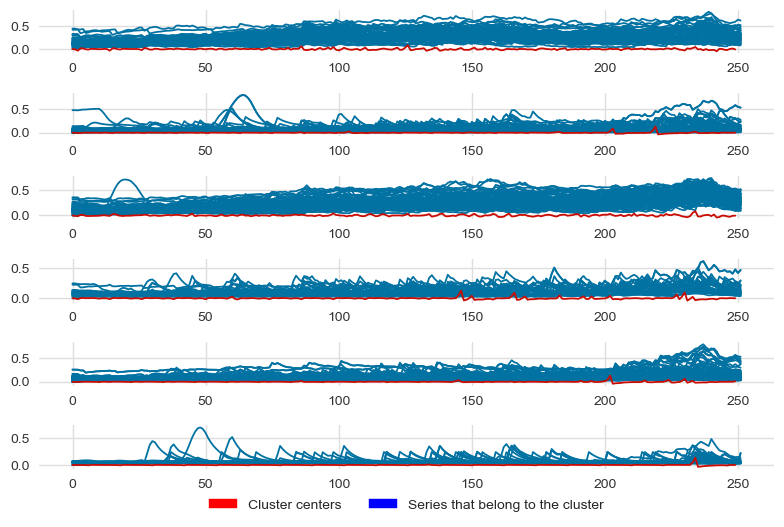

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 13.863320408904062
It took 974 seconds to fit the clustering algorithm and do the predictions.


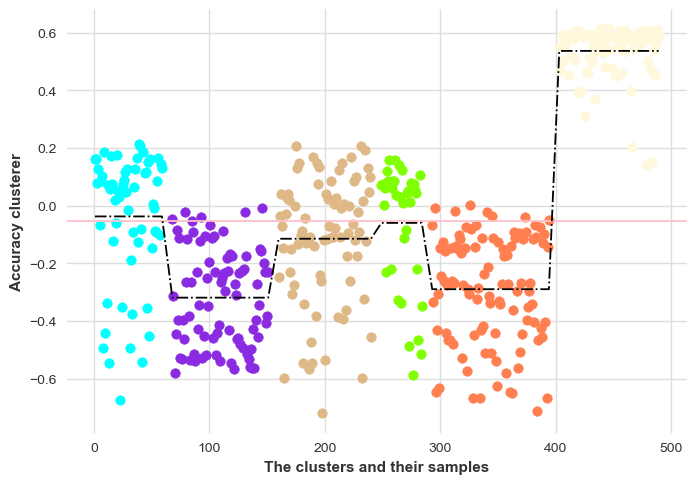

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


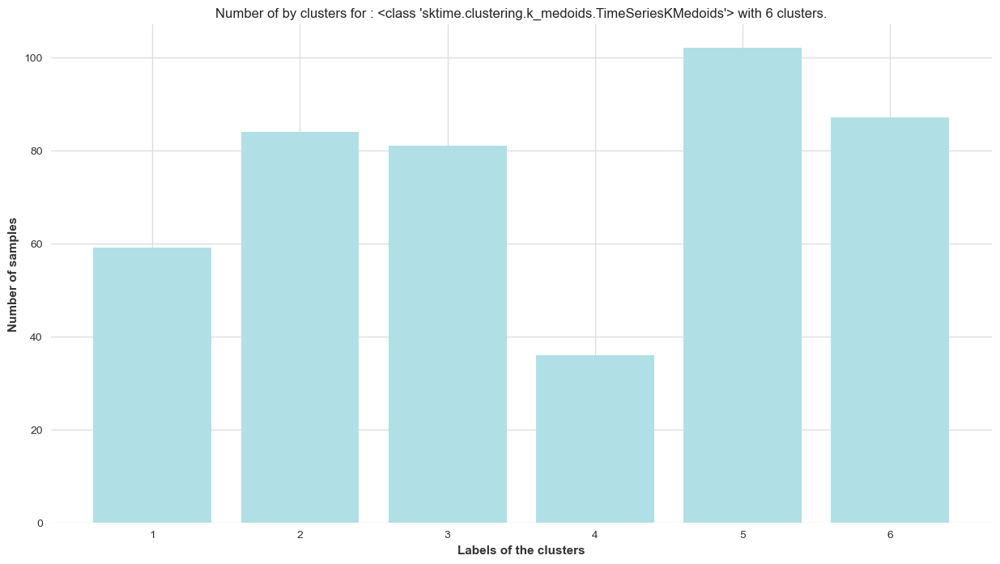

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


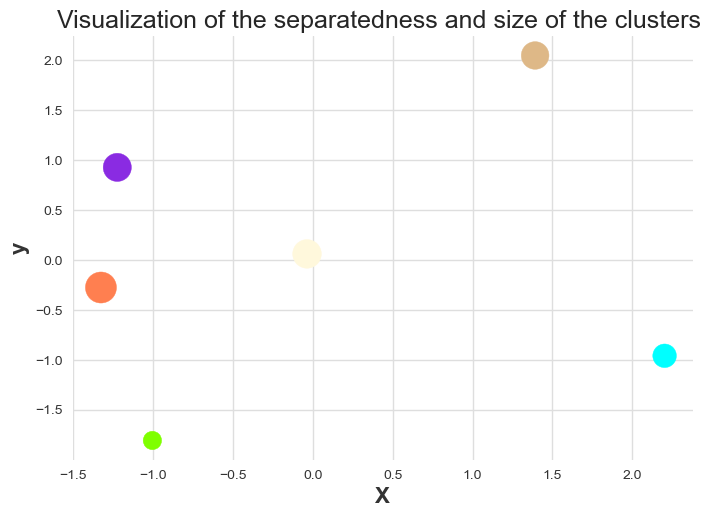

It took 8 seconds to compute visualize on a surface the clusters and the distance between the centroids.


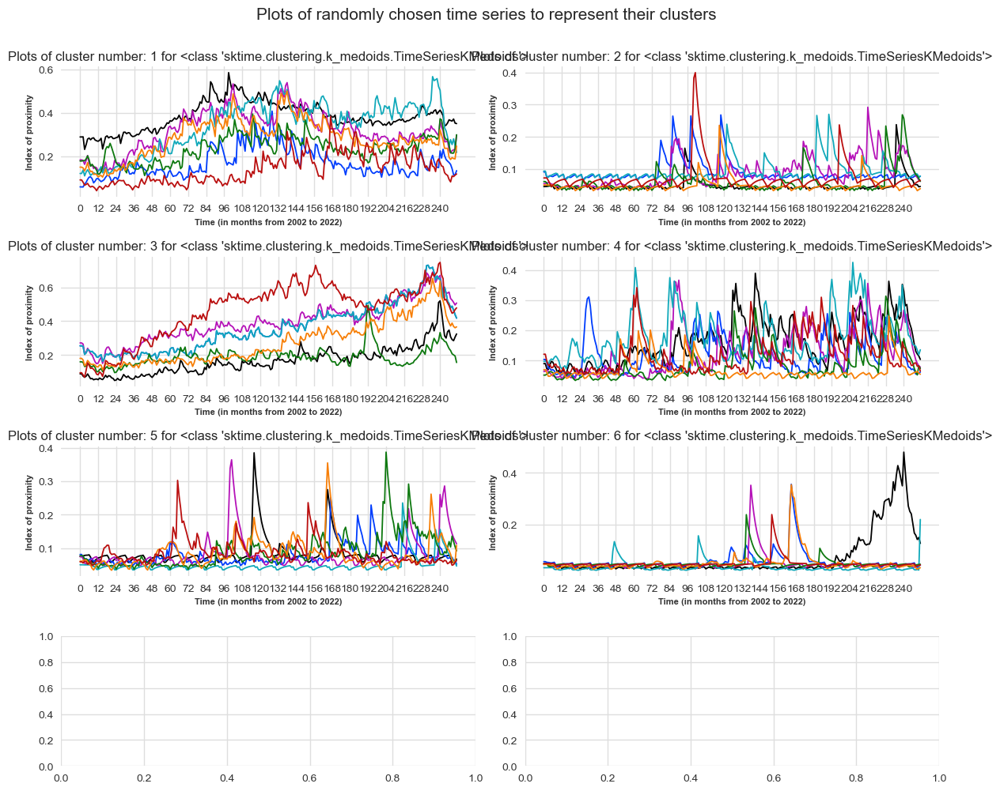

It took 2 seconds to plot the chosen time series.
 


  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 4 clusters are:
Init 1
Resumed because of empty cluster
Init 1
0.298 --> 0.201 --> 0.184 --> 0.184 --> 0.187 --> 
Init 2
0.325 --> 0.296 --> 0.282 --> 0.260 --> 0.248 --> 0.245 --> 0.244 --> 0.243 --> 0.242 --> 0.241 --> 
Init 3
0.305 --> 0.218 --> 0.192 --> 0.191 --> 0.191 --> 0.190 --> 0.190 --> 
Init 4
0.301 --> 0.251 --> 0.215 --> 0.209 --> 0.208 --> 0.207 --> 0.207 --> 0.206 --> 0.205 --> 0.205 --> 
Init 5
0.292 --> 0.228 --> 0.211 --> 0.204 --> 0.197 --> 0.191 --> 0.190 --> 0.190 --> 
Init 6
0.309 --> 0.287 --> 0.271 --> 0.268 --> 0.267 --> 0.267 --> 0.266 --> 0.266 --> 0.265 --> 0.265 --> 
Init 7
0.306 --> 0.285 --> 0.277 --> 0.275 --> 0.277 --> 
Init 8
0.295 --> 0.226 --> 0.223 --> 0.221 --> 0.220 --> 0.220 --> 0.219 --> 0.219 --> 0.218 --> 0.218 --> 
Init 9
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.1836

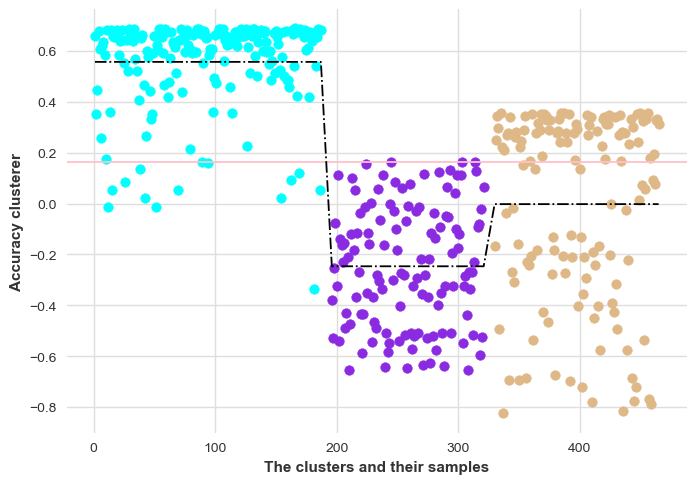

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


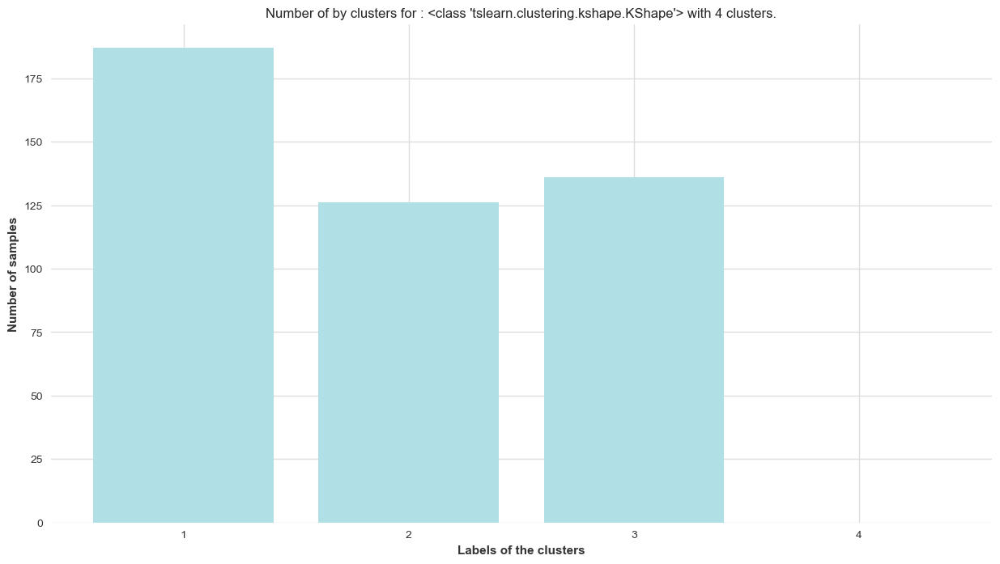

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


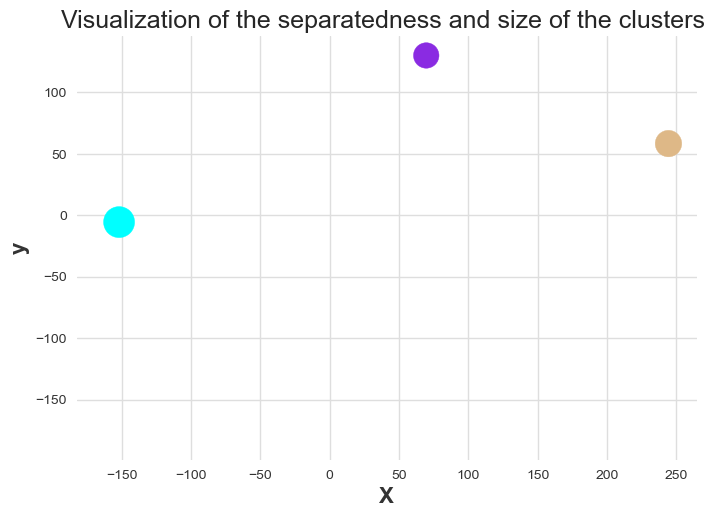

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


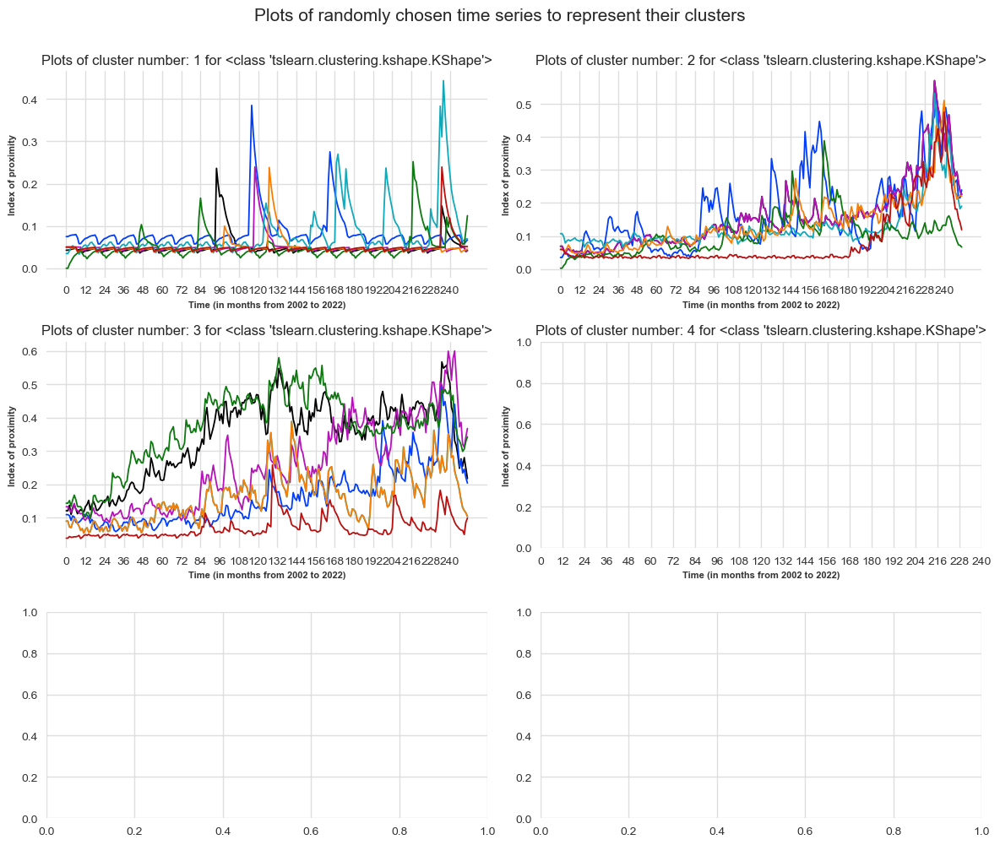

It took 2 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 5 clusters are:
Init 1
Resumed because of empty cluster
Init 1
0.307 --> 0.232 --> 0.199 --> 0.193 --> 0.188 --> 0.185 --> 0.186 --> 
Init 2
0.301 --> 0.229 --> 0.189 --> 0.187 --> 0.187 --> 0.187 --> 0.187 --> 
Init 3
0.298 --> Resumed because of empty cluster
Init 3
0.287 --> 0.232 --> 0.211 --> 0.198 --> 0.190 --> 0.189 --> 0.190 --> 
Init 4
0.307 --> 0.279 --> 0.270 --> 0.269 --> 0.268 --> 0.266 --> 0.265 --> 0.265 --> 0.264 --> 0.263 --> 
Init 5
0.293 --> 0.225 --> 0.224 --> 0.222 --> 0.221 --> 0.220 --> 0.219 --> 0.219 --> 0.218 --> 0.218 --> 
Init 6
Resumed because of empty cluster
Init 6
0.307 --> Resumed because of empty cluster
Init 6
0.306 --> 0.229 --> 0.200 --> 0.196 --> 0.195 --> 0.194 --> 0.193 --> 0.193 --> 0.192 --> 0.192 --> 
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.18536369

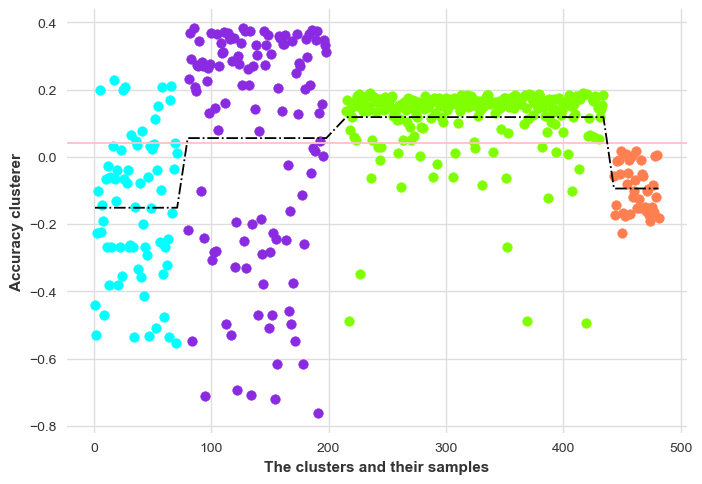

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


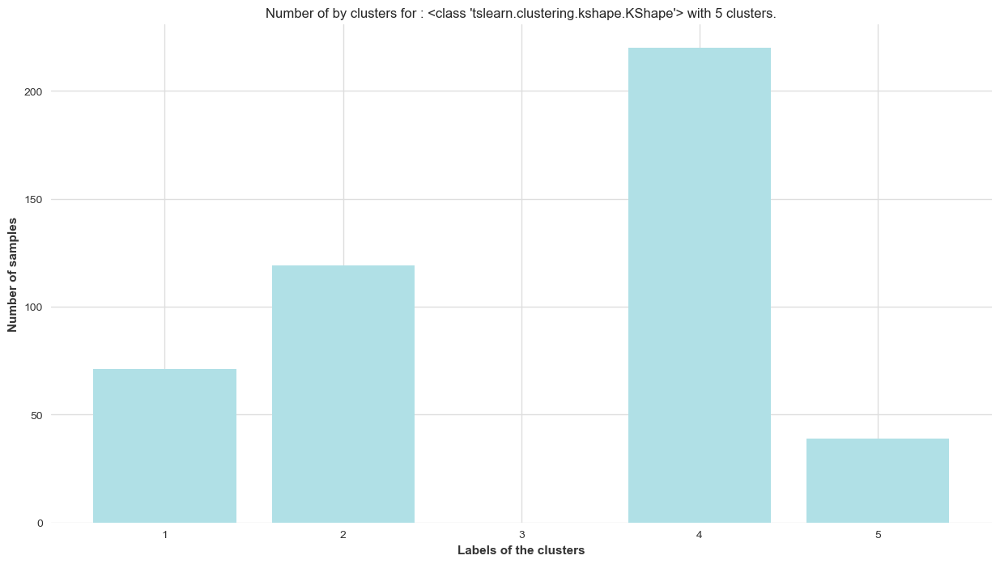

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


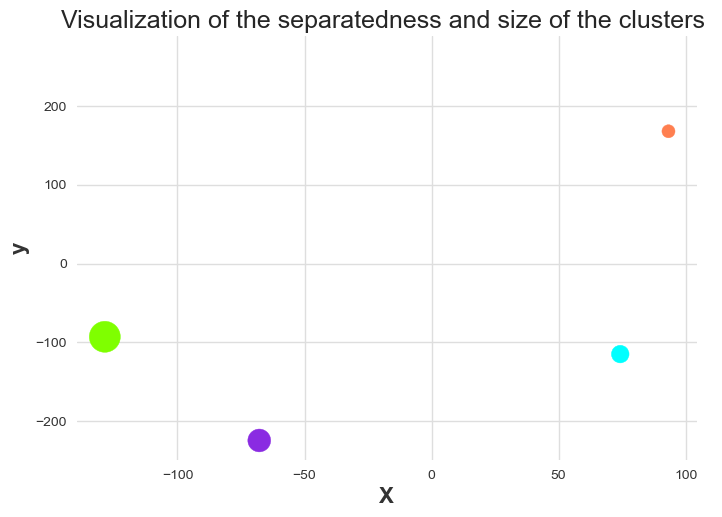

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


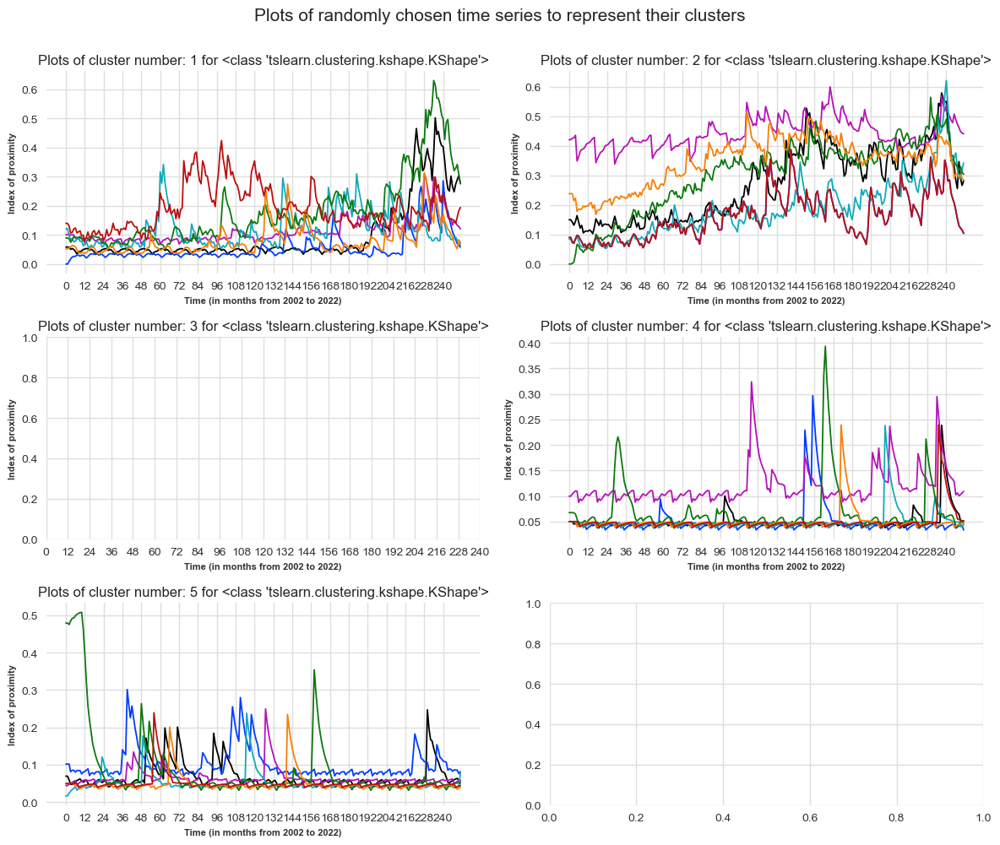

It took 9 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 6 clusters are:
Init 1
Resumed because of empty cluster
Init 1
0.308 --> 0.234 --> 0.195 --> 0.191 --> 0.190 --> 0.189 --> 0.189 --> 0.189 --> 0.188 --> 0.188 --> 
Init 2
0.298 --> 0.213 --> 0.192 --> 0.191 --> 0.190 --> 0.190 --> 0.188 --> 0.188 --> 0.187 --> 0.187 --> 
Init 3
0.290 --> 0.235 --> 0.206 --> 0.197 --> 0.191 --> 0.192 --> 
Init 4
0.299 --> 0.276 --> 0.267 --> 0.265 --> 0.263 --> 0.261 --> 0.256 --> 0.255 --> 0.254 --> 0.254 --> 
Init 5
0.287 --> 0.226 --> 0.224 --> 0.221 --> 0.220 --> 0.219 --> 0.218 --> 0.217 --> 0.217 --> 0.216 --> 
Init 6
Resumed because of empty cluster
Init 6
0.305 --> 0.223 --> 0.202 --> 0.200 --> 0.199 --> 0.199 --> 0.199 --> 0.199 --> 0.199 --> 0.199 --> 
Init 7
Resumed because of empty cluster
Init 7
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids o

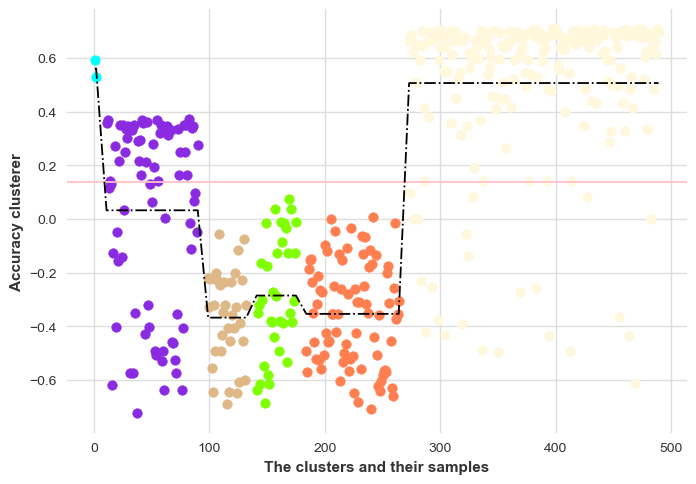

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


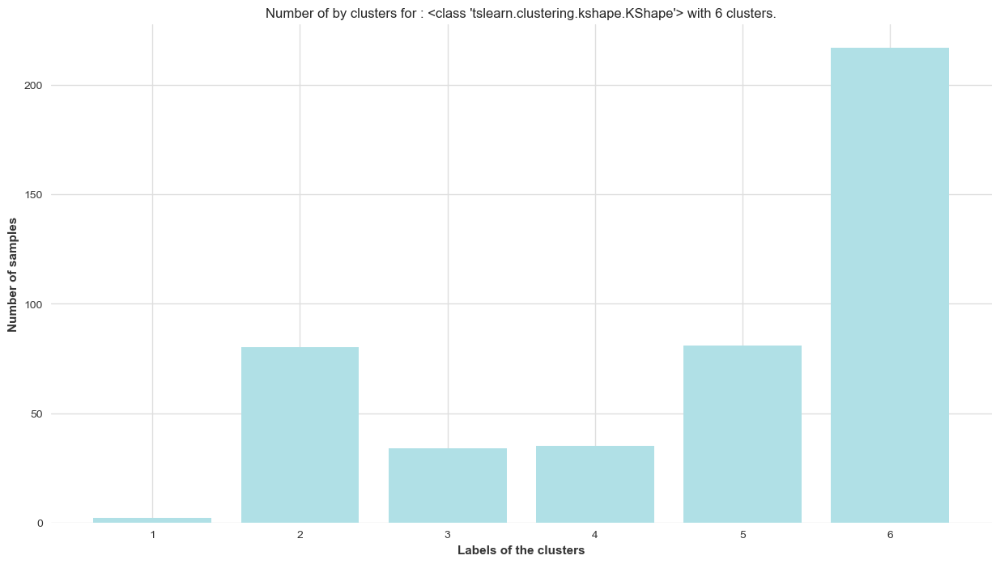

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


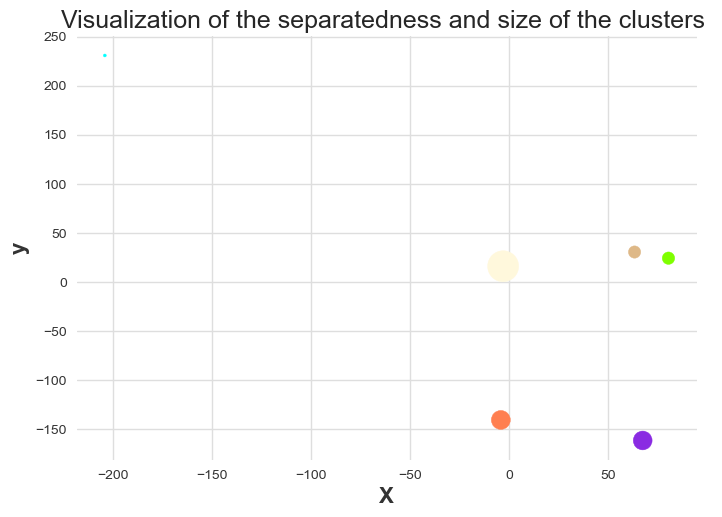

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


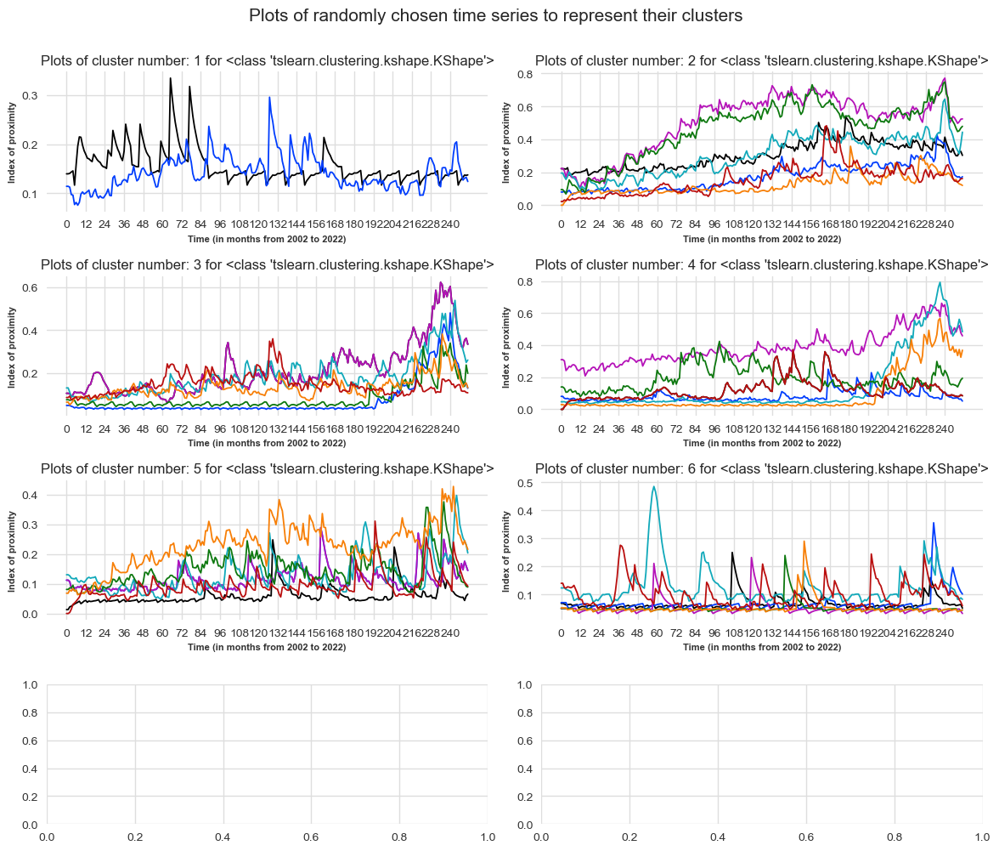

It took 3 seconds to plot the chosen time series.
 


  0%|          | 0/3 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 4 clusters are:
Init 1
190184.362 --> 191172.999 --> 191243.439 --> 191273.592 --> 191286.249 --> 191292.053 --> 191297.601 --> 191302.215 --> 191309.771 --> 191318.290 --> 
Init 2
190341.684 --> 191229.188 --> 191270.422 --> 191305.098 --> 191329.427 --> 191350.414 --> 191366.047 --> 191375.746 --> 191390.357 --> 191404.120 --> 
Init 3
189735.220 --> 191165.352 --> 191244.346 --> 191284.020 --> 191308.321 --> 191334.391 --> 191357.299 --> 191370.820 --> 191381.643 --> 191396.560 --> 
Init 4
190220.833 --> 191175.161 --> 191180.493 --> 191181.825 --> 191182.408 --> 191182.729 --> 191183.292 --> 191184.236 --> 191184.706 --> 191184.942 --> 
Init 5
190197.861 --> 191092.873 --> 191217.880 --> 191271.364 --> 191289.822 --> 191305.302 --> 191319.106 --> 191328.636 --> 191338.807 --> 191347.232 --> 
Init 6
189678.144 --> 191126.411 --> 191224.501 --> 191265.722 --> 191295.044 --> 191307.076 --> 191317

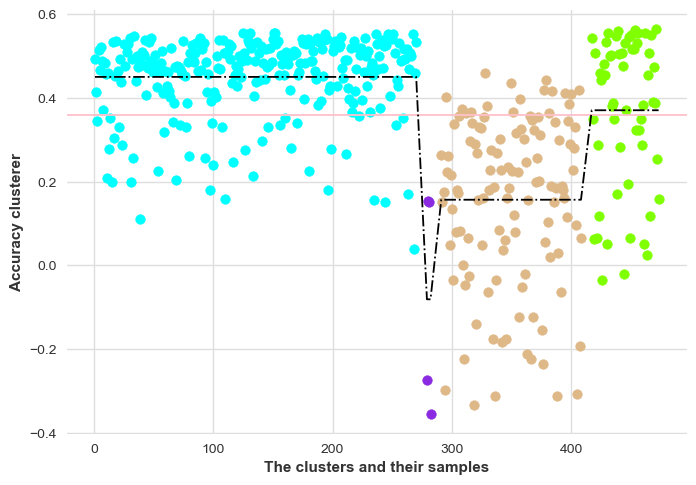

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


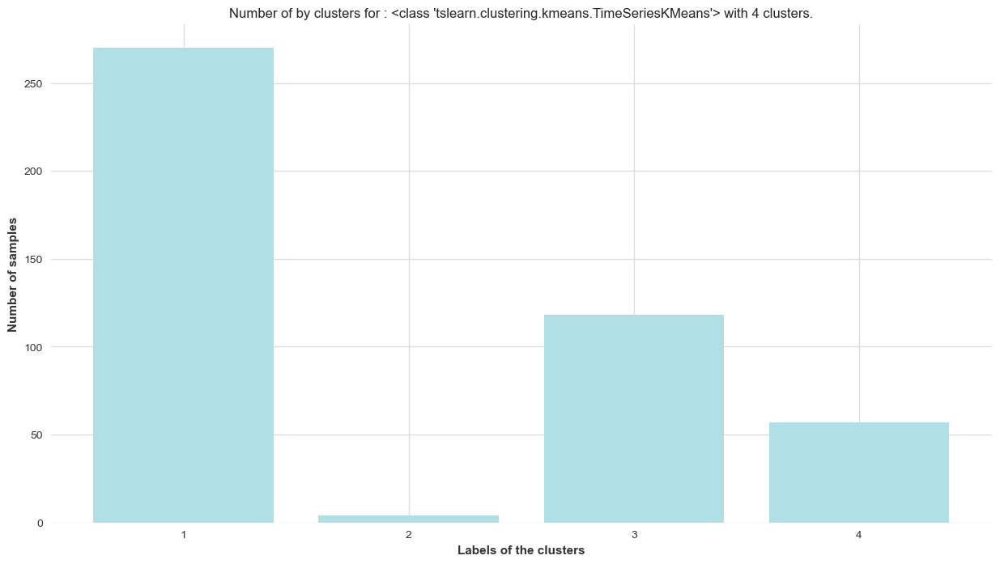

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


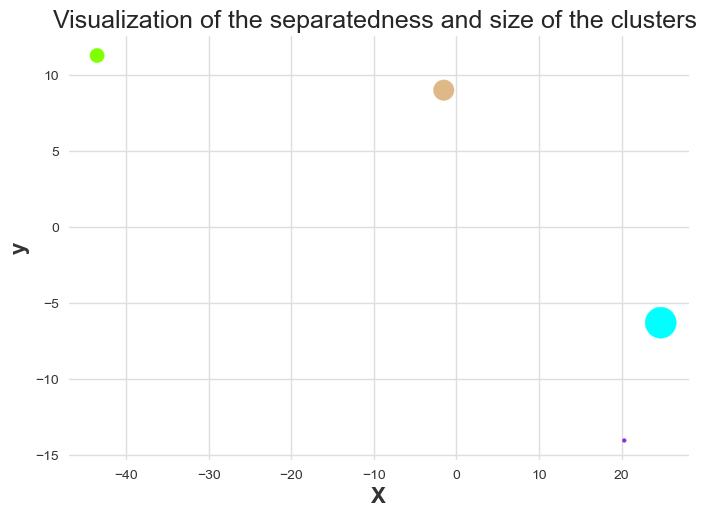

It took 9 seconds to compute visualize on a surface the clusters and the distance between the centroids.


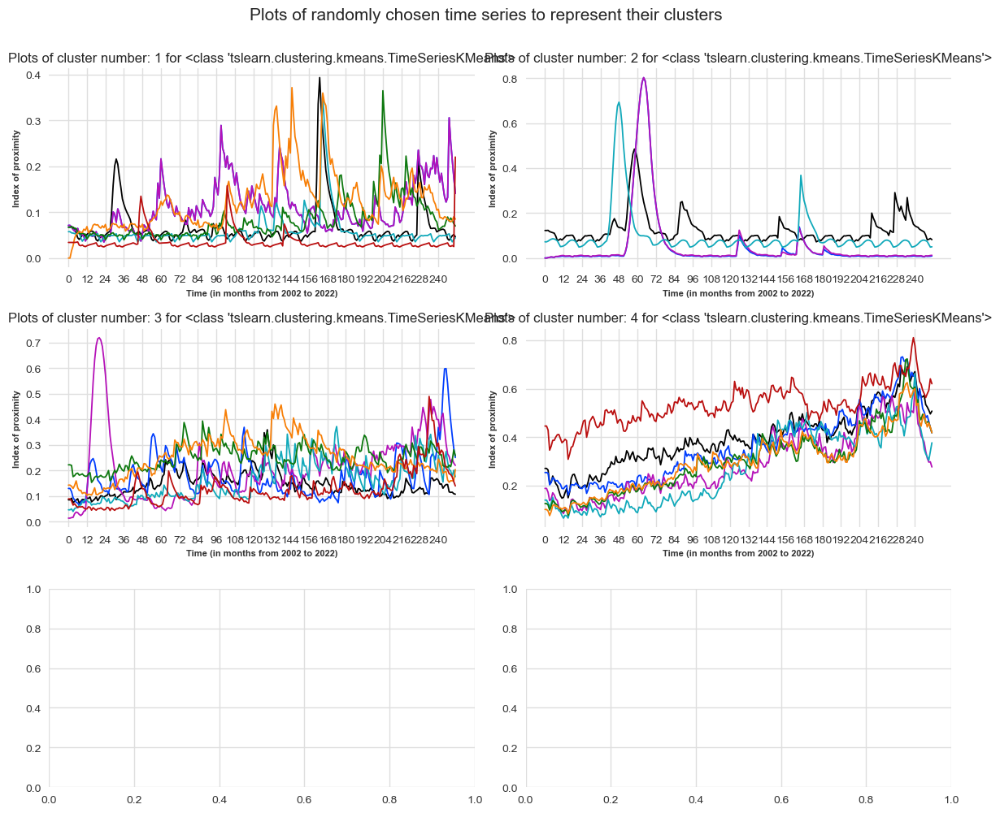

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 5 clusters are:
Init 1
190609.504 --> 191269.064 --> 191533.678 --> 191593.895 --> 191607.518 --> 191612.378 --> 191616.947 --> 191621.455 --> 191624.797 --> 191626.845 --> 
Init 2
189888.063 --> 191103.790 --> 191338.581 --> 191382.892 --> 191410.705 --> 191428.576 --> 191447.325 --> 191482.261 --> 191513.120 --> 191541.244 --> 
Init 3
190254.181 --> 191234.352 --> 191437.485 --> 191502.294 --> 191534.289 --> 191550.019 --> 191560.752 --> 191573.636 --> 191589.019 --> 191605.462 --> 
Init 4
190585.297 --> 191548.236 --> 191589.874 --> 191602.158 --> 191609.598 --> 191613.737 --> 191617.837 --> 191622.859 --> 191625.920 --> 191627.049 --> 
Init 5
190087.658 --> 191386.982 --> 191517.866 --> 191576.460 --> 191610.332 --> 191620.907 --> 191624.526 --> 191627.412 --> 191628.019 --> 191628.177 --> 
Init 6
189889.060 --> 191063.883 --> 191220.181 -->

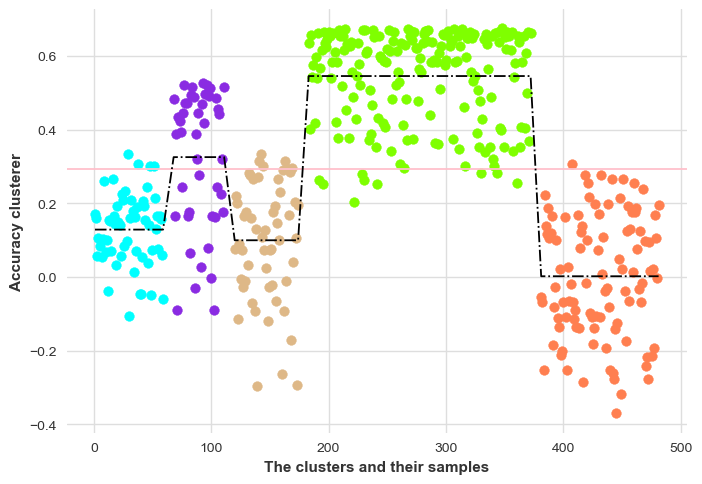

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


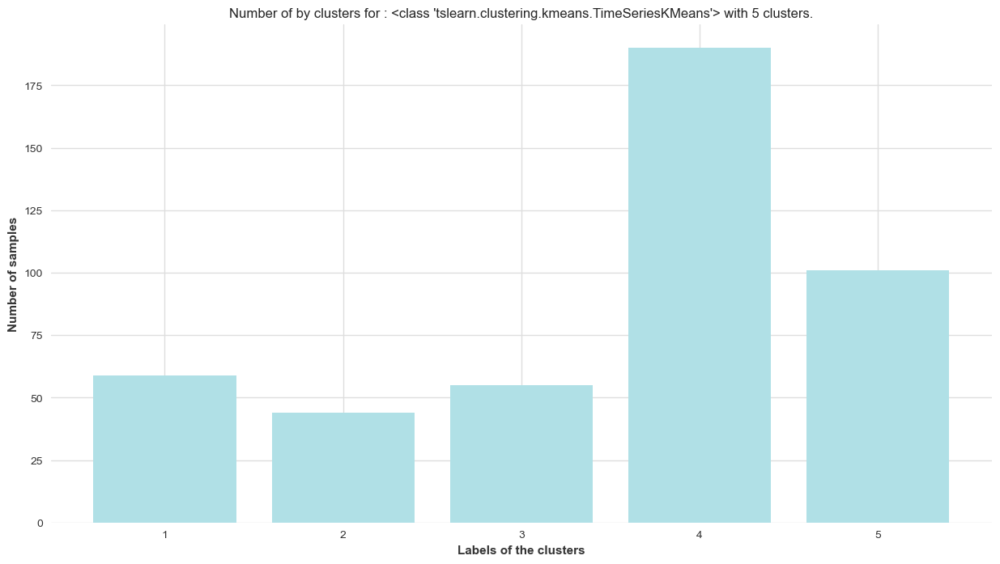

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


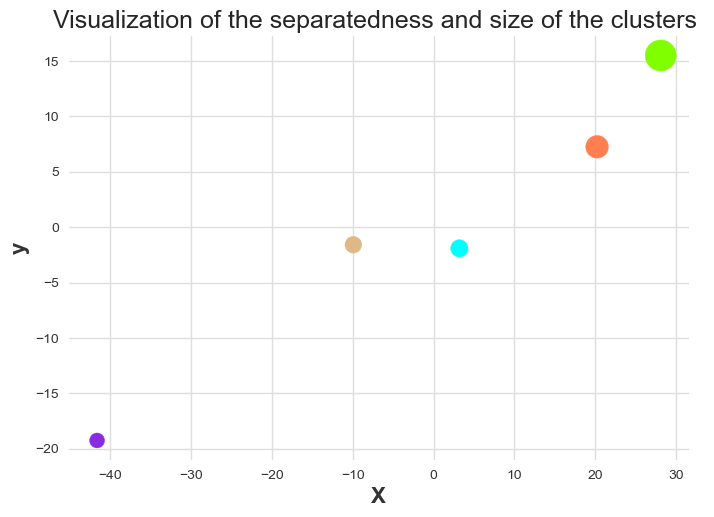

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


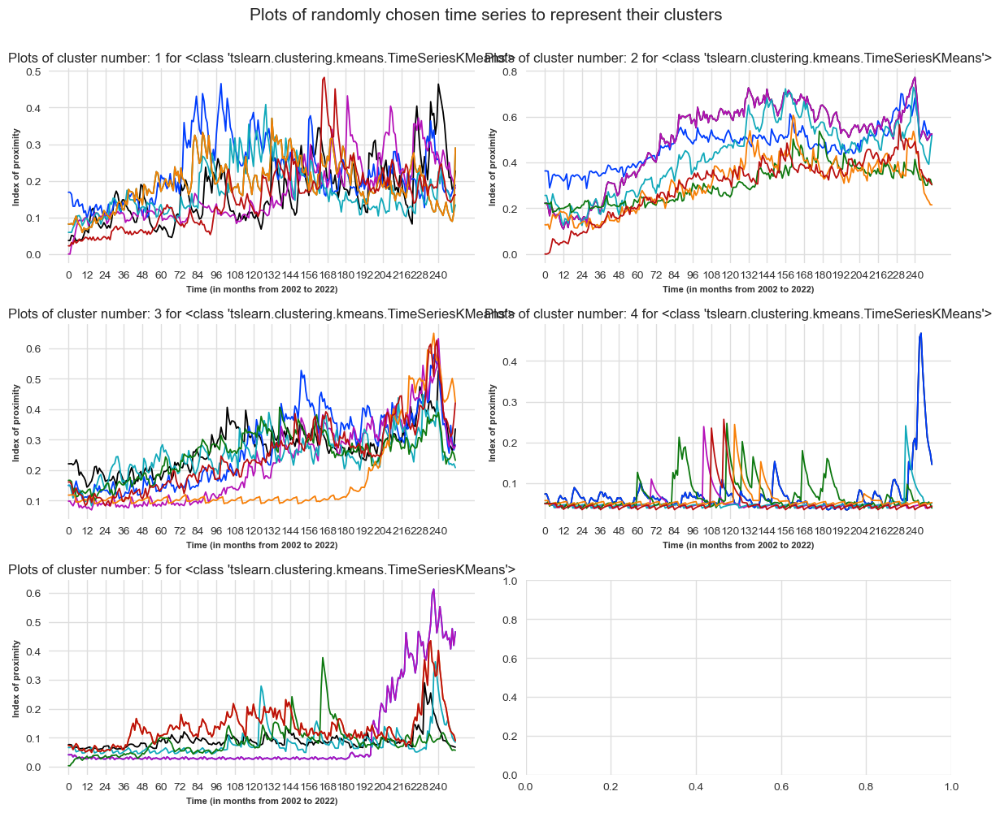

It took 1 seconds to plot the chosen time series.
 
The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 6 clusters are:
Init 1
190628.324 --> 191294.676 --> 191564.243 --> 191628.848 --> 191660.161 --> 191681.294 --> 191695.944 --> 191705.482 --> 191712.425 --> 191715.693 --> 
Init 2
190698.957 --> 191379.927 --> 191472.440 --> 191512.356 --> 191546.030 --> 191564.656 --> 191584.615 --> 191599.577 --> 191623.887 --> 191646.712 --> 
Init 3
190031.072 --> 191358.095 --> 191468.065 --> 191558.971 --> 191592.996 --> 191613.911 --> 191630.955 --> 191651.805 --> 191679.780 --> 191692.267 --> 
Init 4
190705.985 --> 191501.849 --> 191580.214 --> 191614.945 --> 191636.398 --> 191654.579 --> 191666.695 --> 191680.692 --> 191692.719 --> 191700.351 --> 
Init 5
190450.409 --> 191609.639 --> 191682.704 --> 191709.491 --> 191718.574 --> 191722.699 --> 191724.110 --> 191724.945 --> 191725.199 --> 191725.407 --> 
Init 6
190312.413 --> 191313.227 --> 191516.052 -->

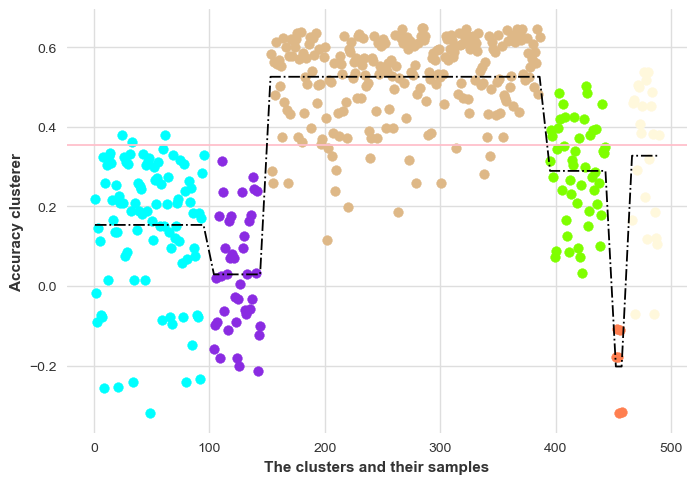

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


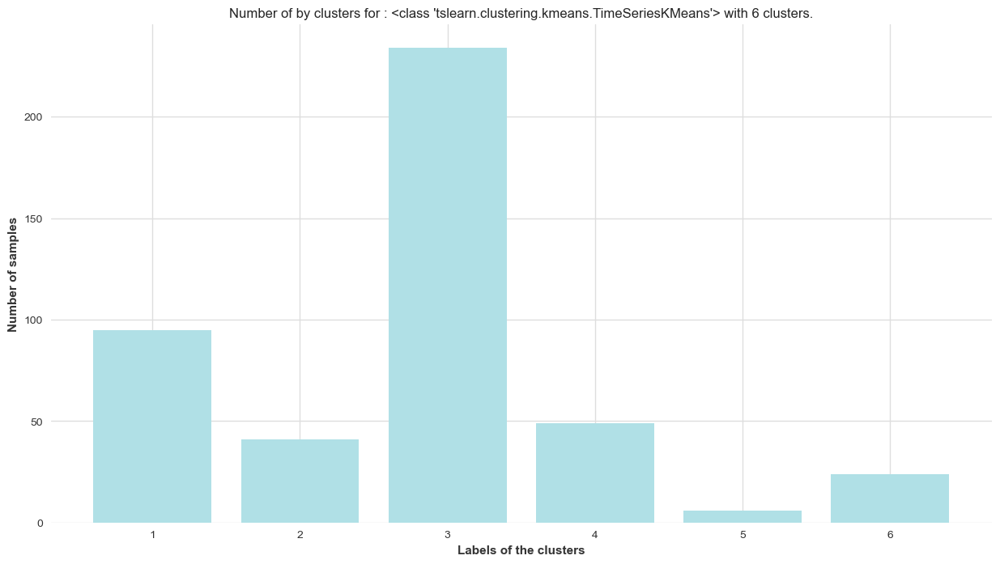

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


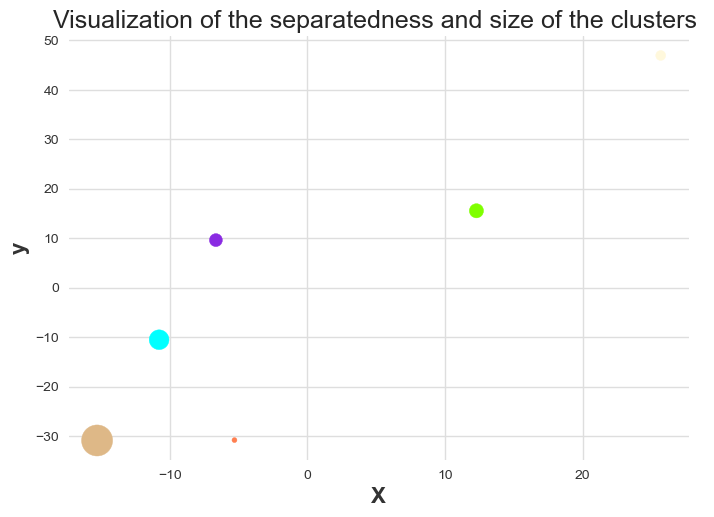

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


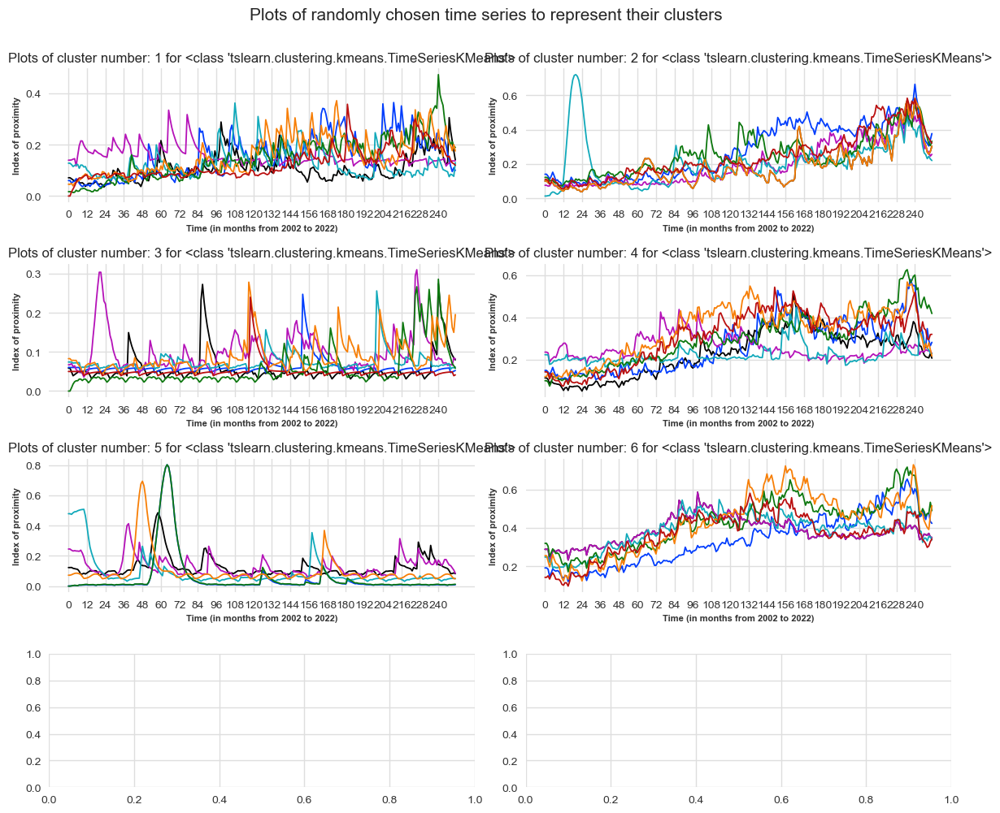

It took 1 seconds to plot the chosen time series.
 


In [228]:
for algo in listalgos:
    for num_cluster in tqdm(listclusters):
        print('The results for the algorithm : '+str(algo)+' using '+str(num_cluster)+' clusters are:')
        myclusterer = evaluate_clusterer(algo,X_train, X_test,n_clusters=num_cluster, init_algorithm="kmeans++", max_iter=10,\
        metric="wddtw",random_state=1, n_init=10,distance_viz='l1',colors=colors)

<div class="alert-info">
8. Comparing the best clusterers with the best number of clusters
</div>

In [229]:
listclusters=[5]
listalgos = [TimeSeriesKMedoids,KShape,TimeSeriesKMeans]

  0%|          | 0/1 [00:00<?, ?it/s]

The results for the algorithm : <class 'sktime.clustering.k_medoids.TimeSeriesKMedoids'> using 5 clusters are:
Iteration 0, inertia 4.683123160015171.
Iteration 1, inertia 4.563849684345967.
Iteration 2, inertia 4.602105557424998.
Iteration 3, inertia 4.602762924006069.
Iteration 0, inertia 4.370975106026913.
Iteration 1, inertia 4.282630572406202.
Iteration 2, inertia 4.222822079656583.
Iteration 3, inertia 4.254078766520826.
Iteration 4, inertia 4.501874152090345.
Iteration 5, inertia 4.499742510098486.
Iteration 6, inertia 4.529659188604306.
Iteration 7, inertia 4.56411749064671.
Iteration 8, inertia 4.587018914725102.
Iteration 0, inertia 4.7287659342521415.
Iteration 1, inertia 4.610955874706861.
Iteration 2, inertia 4.594961196477807.
Iteration 3, inertia 4.563892637052456.
Iteration 0, inertia 5.266814443502424.
Iteration 1, inertia 4.30529960351431.
Iteration 2, inertia 4.282209105628707.
Iteration 3, inertia 4.296983979479352.
Iteration 4, inertia 4.270515177597598.
Iteration 

<Figure size 500x1000 with 0 Axes>

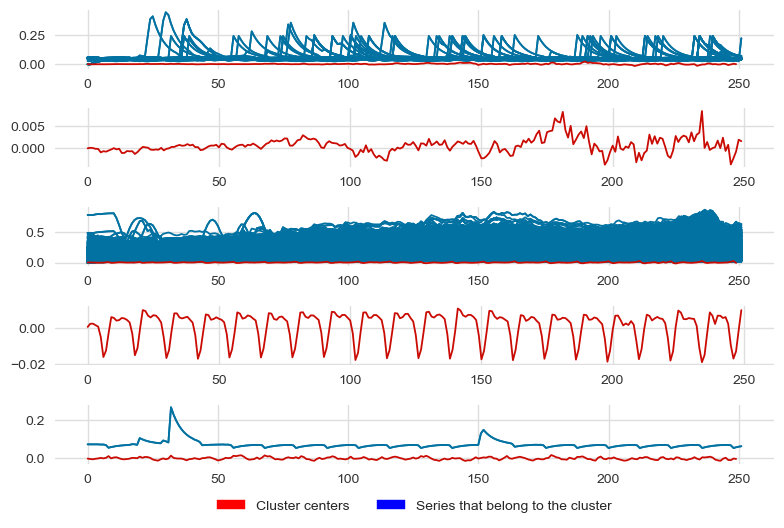

The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 4.136495027204223
It took 24826 seconds to fit the clustering algorithm and do the predictions.


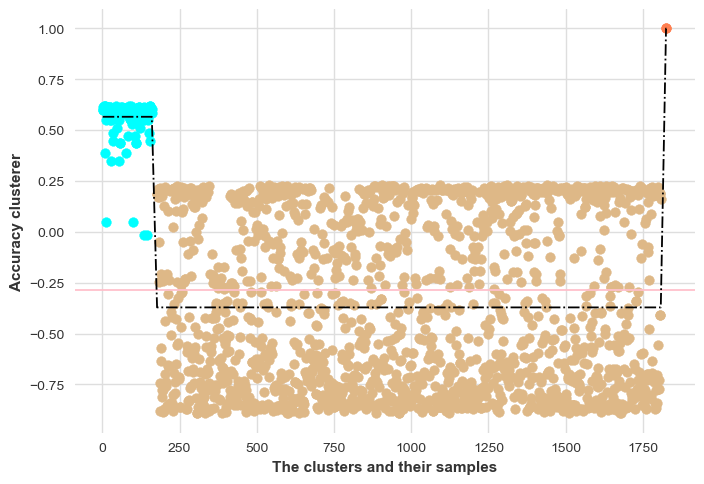

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


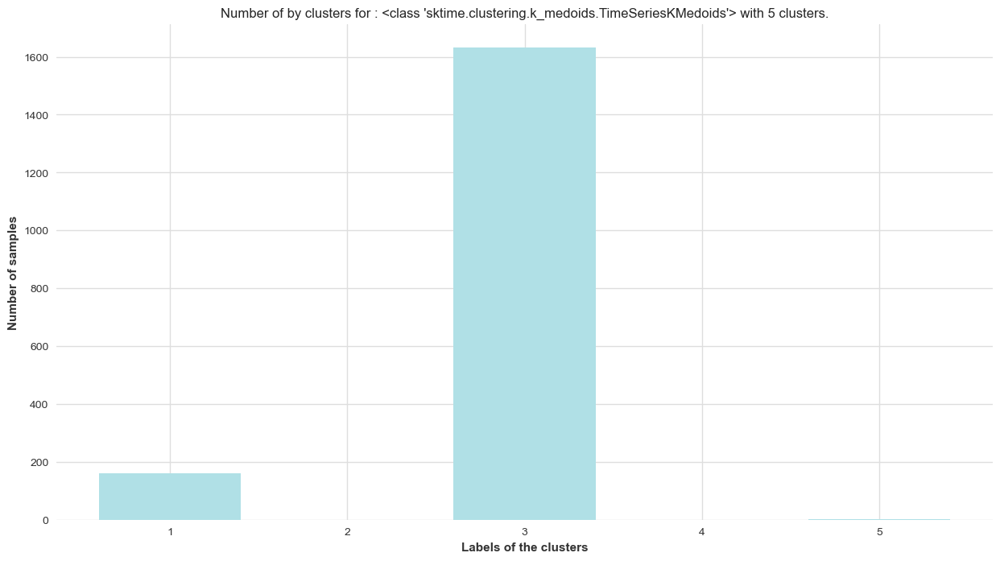

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


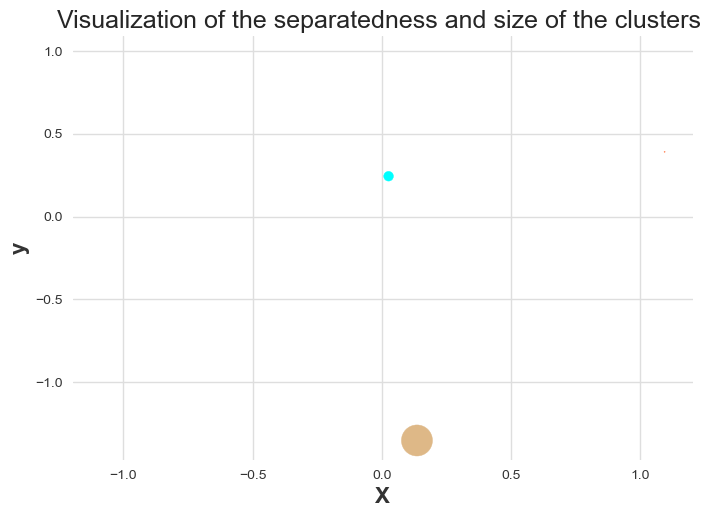

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


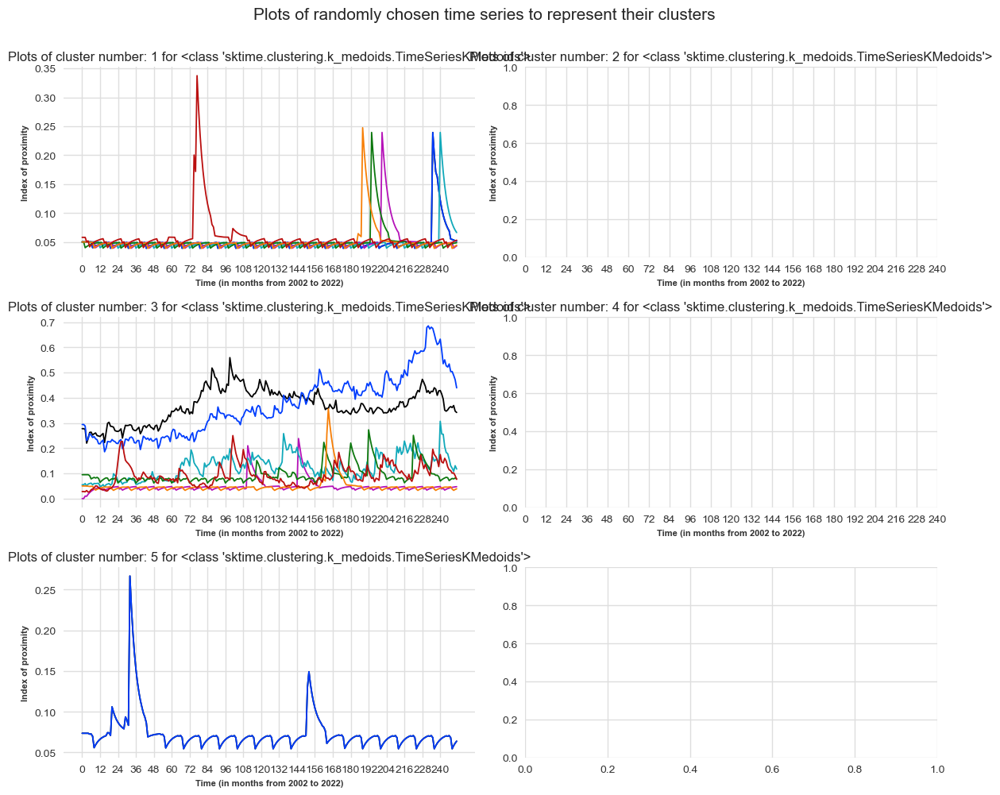

It took 1 seconds to plot the chosen time series.
 


  0%|          | 0/1 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kshape.KShape'> using 5 clusters are:
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
The inertia of the algorithm (the sum of the distance to the respective centroids of all samples) is : 0.0004780745531125499
It took 73 seconds to fit the clustering algorithm and do the predictions.


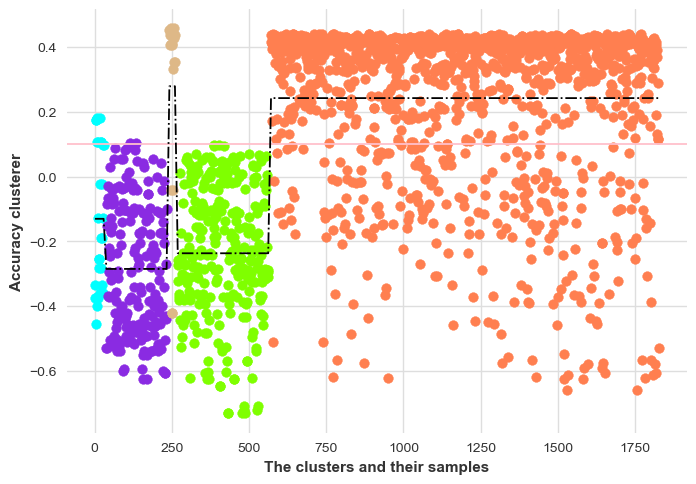

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


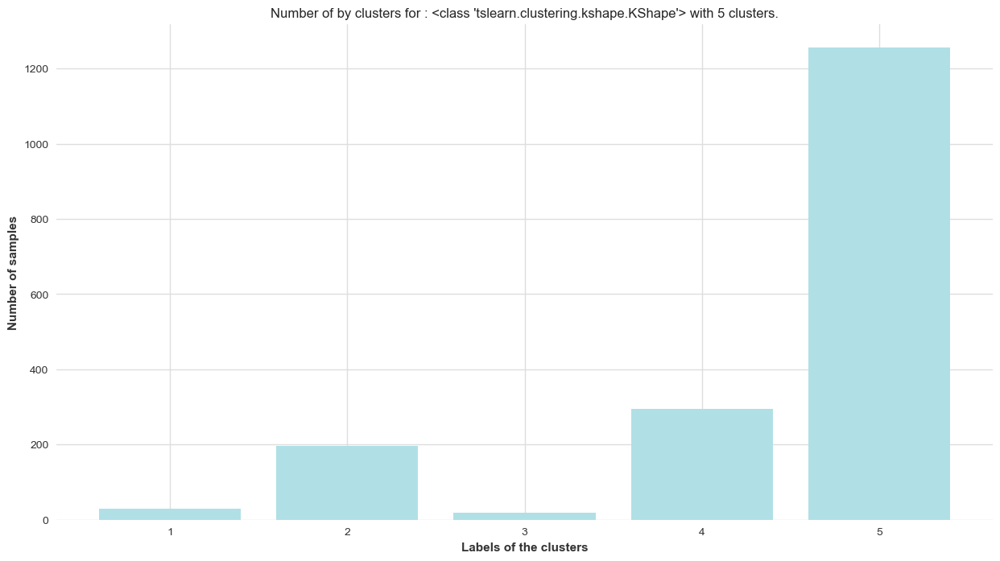

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


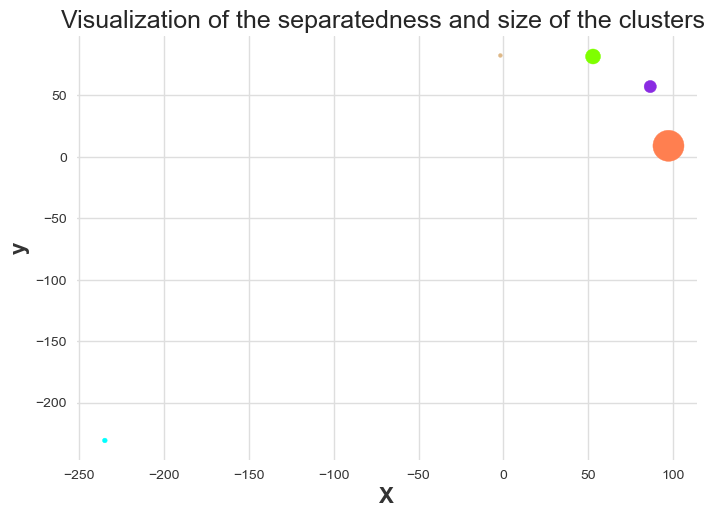

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


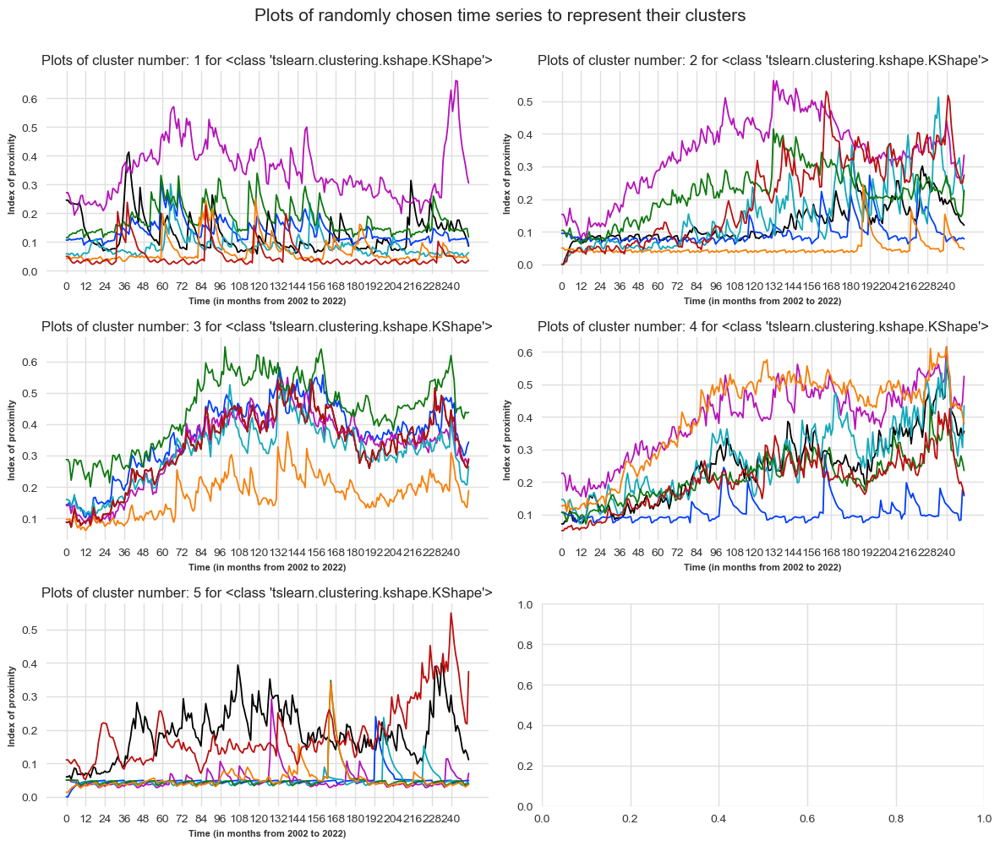

It took 1 seconds to plot the chosen time series.
 


  0%|          | 0/1 [00:00<?, ?it/s]

The results for the algorithm : <class 'tslearn.clustering.kmeans.TimeSeriesKMeans'> using 5 clusters are:
Init 1
186872.385 --> 188659.512 --> 189214.362 --> 189323.345 --> 189353.455 --> 189368.347 --> 189377.455 --> 189383.047 --> 189385.924 --> 189387.010 --> 
Init 2
186409.282 --> 188608.849 --> 188809.489 --> 188896.700 --> 188954.057 --> 189001.941 --> 189050.005 --> 189096.924 --> 189134.822 --> 189167.274 --> 
Init 3
183511.620 --> 188727.394 --> 189151.201 --> 189237.632 --> 189258.875 --> 189272.214 --> 189280.723 --> 189286.213 --> 189288.812 --> 189290.586 --> 
Init 4
186611.959 --> 188354.803 --> 188788.650 --> 188916.970 --> 188985.868 --> 189040.770 --> 189088.646 --> 189129.610 --> 189161.490 --> 189190.038 --> 
Init 5
178536.745 --> 188065.249 --> 188910.904 --> 189075.949 --> 189143.638 --> 189184.972 --> 189212.121 --> 189236.357 --> 189254.976 --> 189267.501 --> 
Init 6
187089.932 --> 189021.287 --> 189169.508 --> 189224.578 --> 189259.843 --> 189291.167 --> 189316

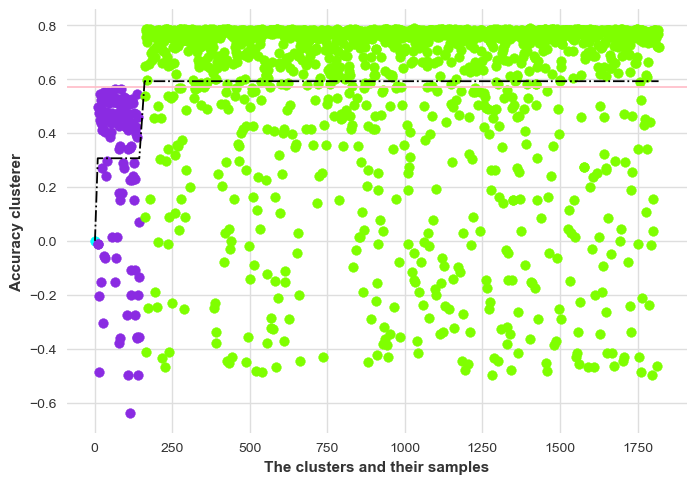

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


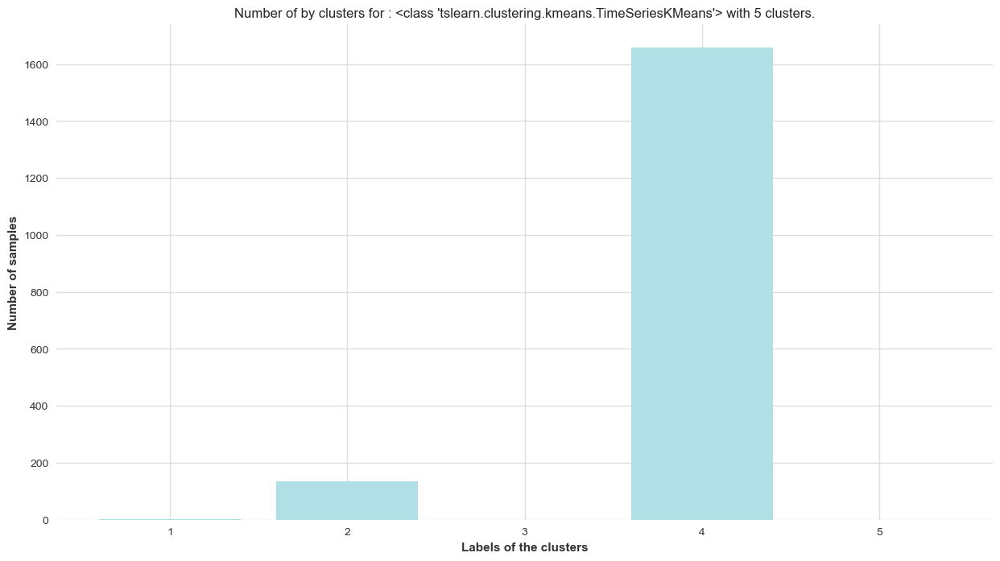

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


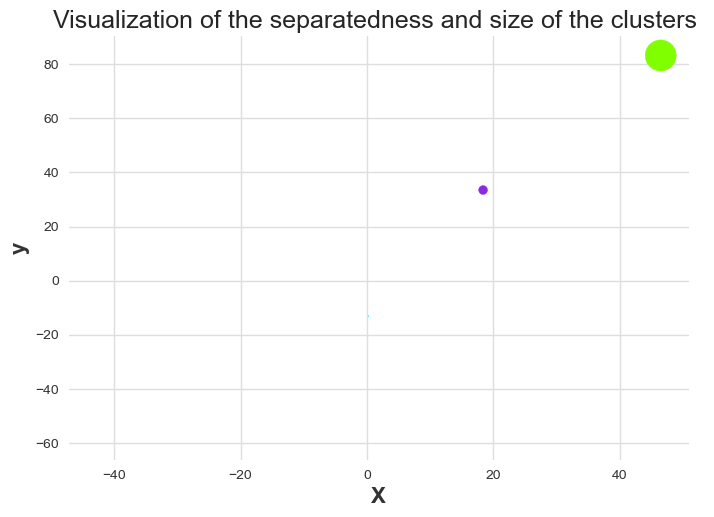

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


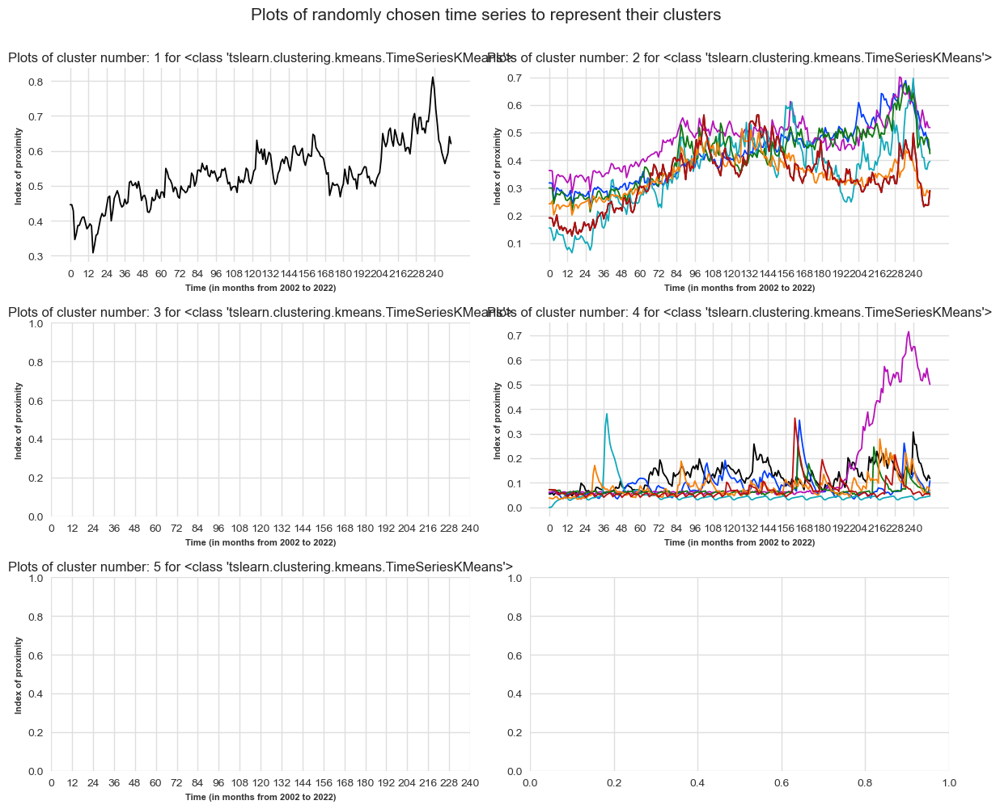

It took 1 seconds to plot the chosen time series.
 


In [230]:
for algo in listalgos:
    for num_cluster in tqdm(listclusters):
        print('The results for the algorithm : '+str(algo)+' using '+str(num_cluster)+' clusters are:')
        myclusterer = evaluate_clusterer(algo,dftraincluster[:10000], dfcluster,n_clusters=num_cluster, init_algorithm="kmeans++", max_iter=10,\
        metric="wddtw",random_state=1, n_init=10,distance_viz='l1',colors=colors)

It seems that KShape with 5 clusters is the algorithm working the best: for the silhouette score, the distance between the centroids, the proportion of samples by clusterer and the plot of the samples in the cluster.

Nevertheless, we want to be sure and try all possible clustering between 2 and 20 with KShape to see what is the best number of clusters.

<div class="alert-info">
9. Checking best number of clusters KShape
</div>

In [231]:
numbercluster = np.arange(2,16)

Init 1
0.349 --> 0.294 --> 0.290 --> 0.289 --> 0.289 --> 0.289 --> 
Init 2
0.334 --> 0.299 --> 0.290 --> 0.288 --> 0.288 --> 0.288 --> 0.288 --> 
Init 3
Resumed because of empty cluster
Init 3
0.272 --> 0.203 --> 0.197 --> 0.195 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 
Init 4
0.327 --> 0.292 --> 0.289 --> 0.288 --> 0.287 --> 0.287 --> 0.287 --> 
Init 5
0.250 --> 0.202 --> 0.195 --> 0.194 --> 0.194 --> 0.194 --> 
Init 6
0.336 --> 0.295 --> 0.293 --> 0.293 --> 0.293 --> 0.293 --> 0.292 --> 0.292 --> 0.292 --> 0.292 --> 0.292 --> 0.291 --> 0.291 --> 0.290 --> 0.290 --> 0.290 --> 0.289 --> 0.289 --> 0.288 --> 0.288 --> 0.288 --> 0.288 --> 0.288 --> 0.288 --> 0.288 --> 
Init 7
0.330 --> 0.301 --> 0.292 --> 0.289 --> 0.288 --> 0.288 --> 0.288 --> 
Init 8
0.334 --> 0.297 --> 0.286 --> 0.283 --> 0.282 --> 0.281 --> 0.281 --> 0.280 --> 0.280 --> 0.280 --> 0.279 --> 0.279 --> 0.278 --> 0.278 --> 0.278 --> 0.277 --> 0.277 --> 0.277 --> 0.277 --> 0.276 --> 0.276 --> 0.276 --> 0.276 -

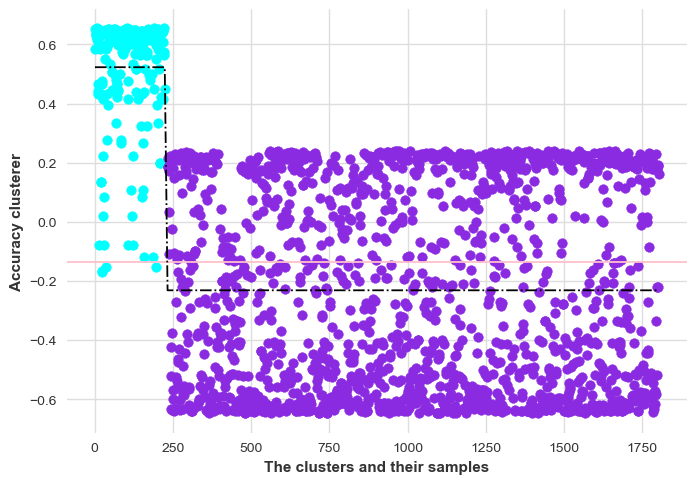

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


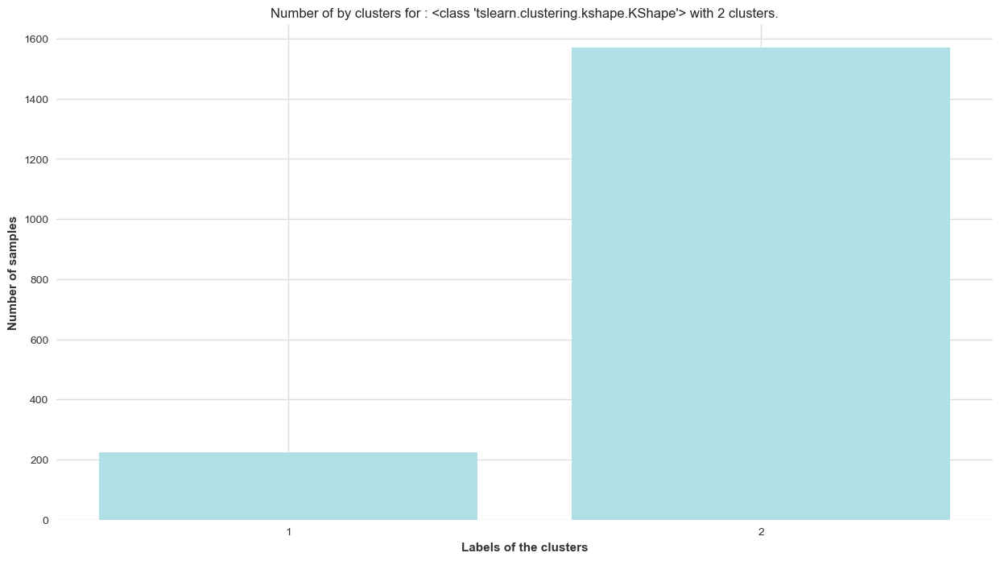

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


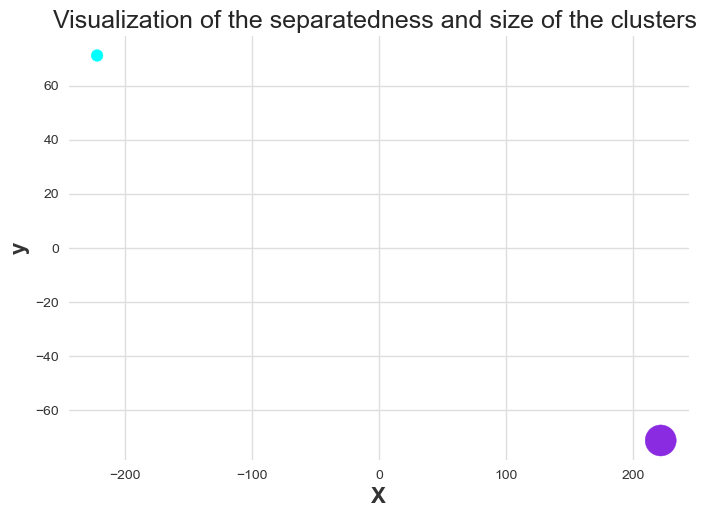

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


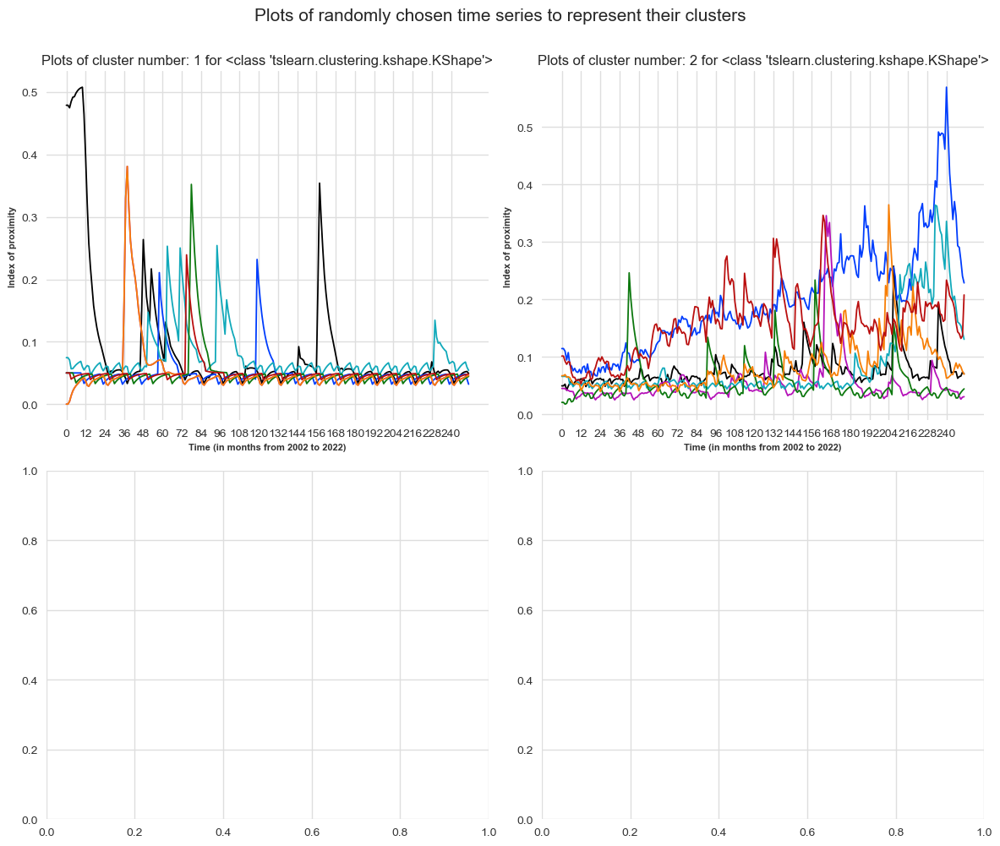

It took 1 seconds to plot the chosen time series.
 
Init 1
0.277 --> 0.203 --> 0.196 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 
Init 2
0.332 --> 0.298 --> 0.290 --> 0.287 --> 0.284 --> 0.284 --> 0.284 --> 0.284 --> 
Init 3
0.268 --> 0.202 --> 0.196 --> 0.194 --> 0.194 --> 0.193 --> 0.193 --> 0.193 --> 0.193 --> 
Init 4
Resumed because of empty cluster
Init 4
0.317 --> 0.293 --> 0.287 --> 0.286 --> 0.285 --> 0.285 --> 
Init 5
0.330 --> 0.299 --> 0.295 --> 0.292 --> 0.287 --> 0.286 --> 0.286 --> 0.285 --> 0.285 --> 0.285 --> 
Init 6
Resumed because of empty cluster
Init 6
0.270 --> 0.201 --> 0.195 --> 0.194 --> 0.193 --> 0.193 --> 
Init 7
Resumed because of empty cluster
Init 7
0.250 --> 0.203 --> 0.196 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 0.194 --> 
Init 8
Resumed because of empty cluster
Init 8
Resumed because of empty cluster
Init 8
Resumed because of empty cluster
Init 8
Resumed because of empty cluster
Init 8
0.321 --> 0.291 --> 0.287 --> 0.286 --> 0.286

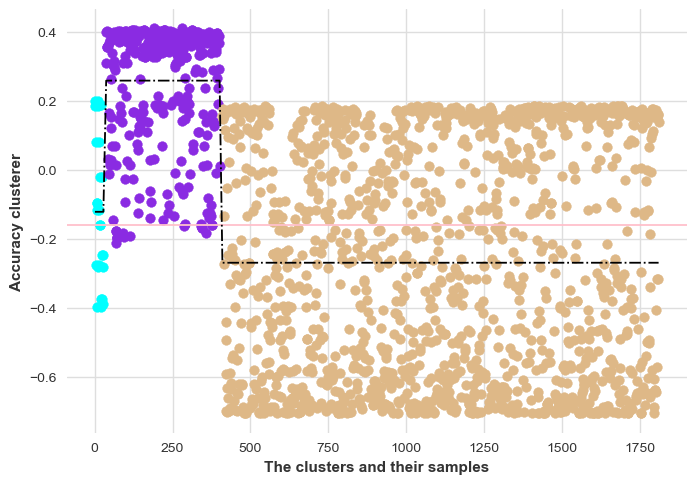

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


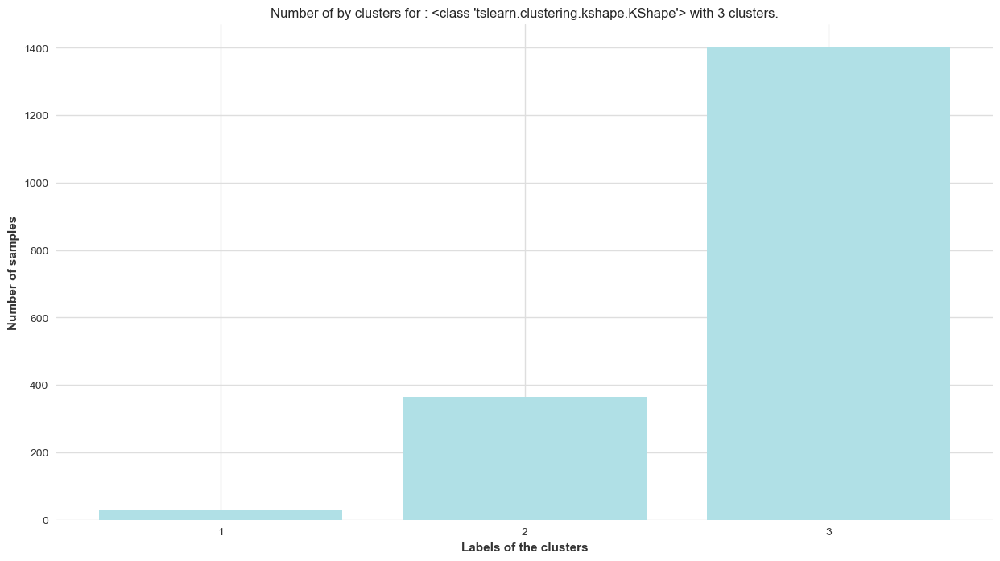

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


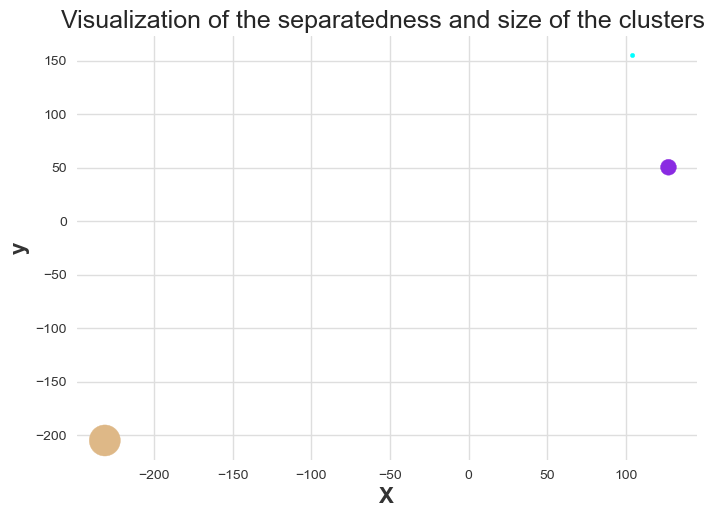

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


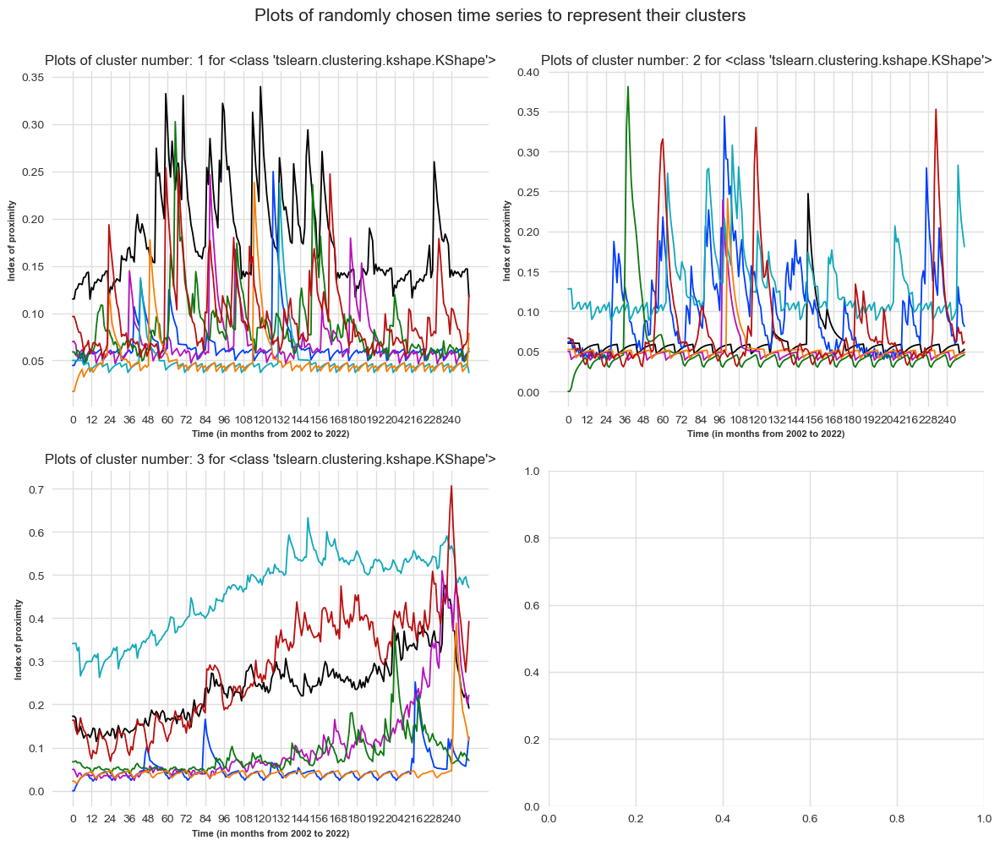

It took 1 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
0.226 --> 0.198 --> 0.193 --> 0.192 --> 0.191 --> 0.191 --> 0.191 --> 0.191 --> 0.191 --> 0.191 --> 0.190 --> 0.190 --> 0.190 --> 
Init 2
Resumed because of empty cluster
Init 2
Resumed because of empty cluster
Init 2
Resumed because of empty cluster
Init 2
0.270 --> 0.200 --> 0.194 --> 0.193 --> 0.193 --> 0.193 --> 0.193 --> 0.193 --> 0.193 --> 
Init 3
Resumed because of empty cluster
Init 3
Resumed because of empty cluster
Init 3
Resumed because of empty cluster
Init 3
Resumed because of empty 

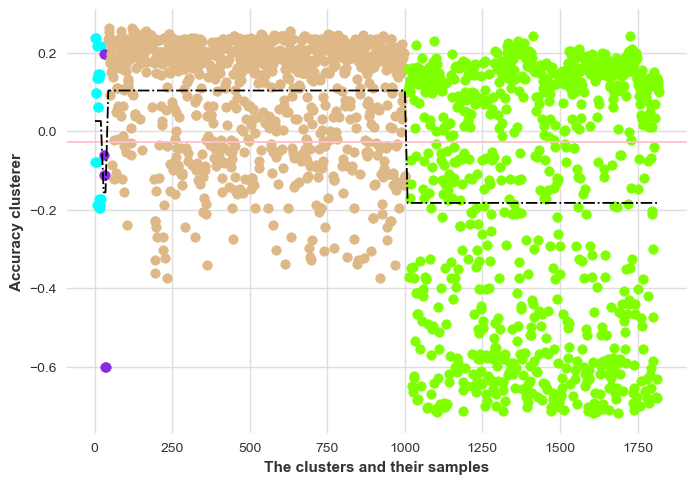

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


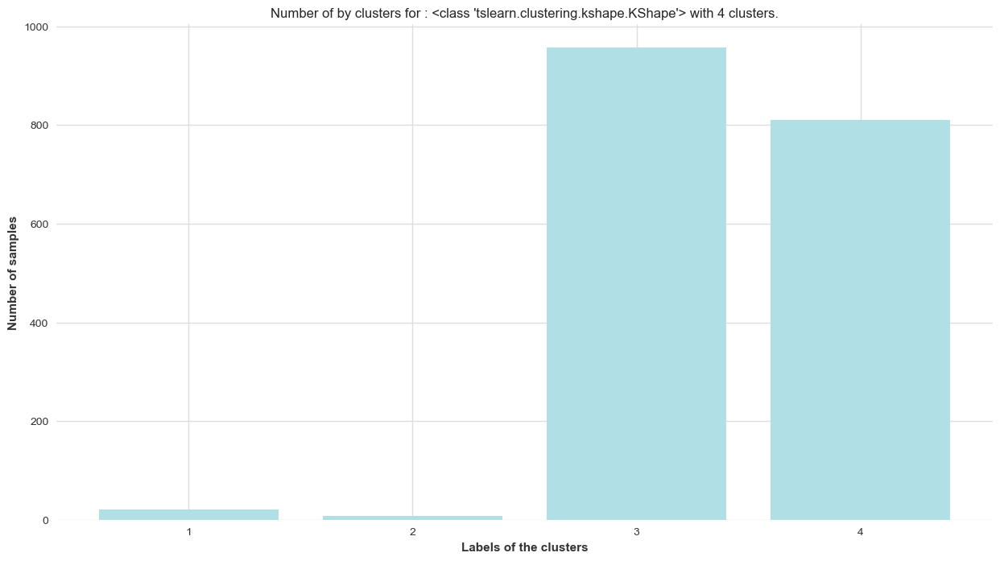

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


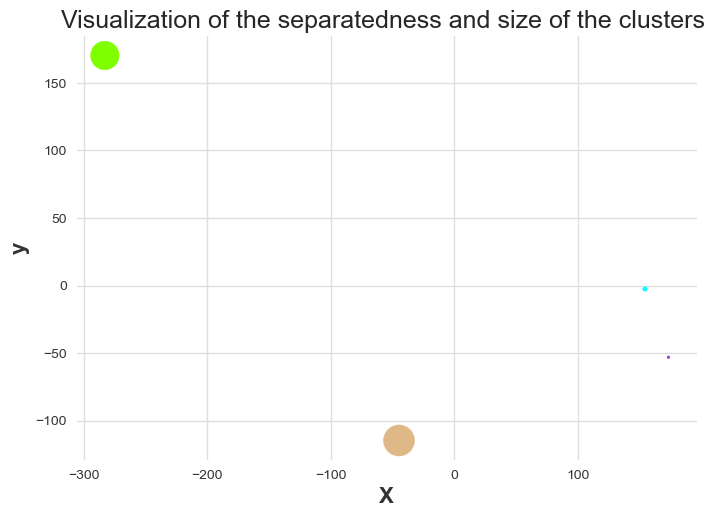

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


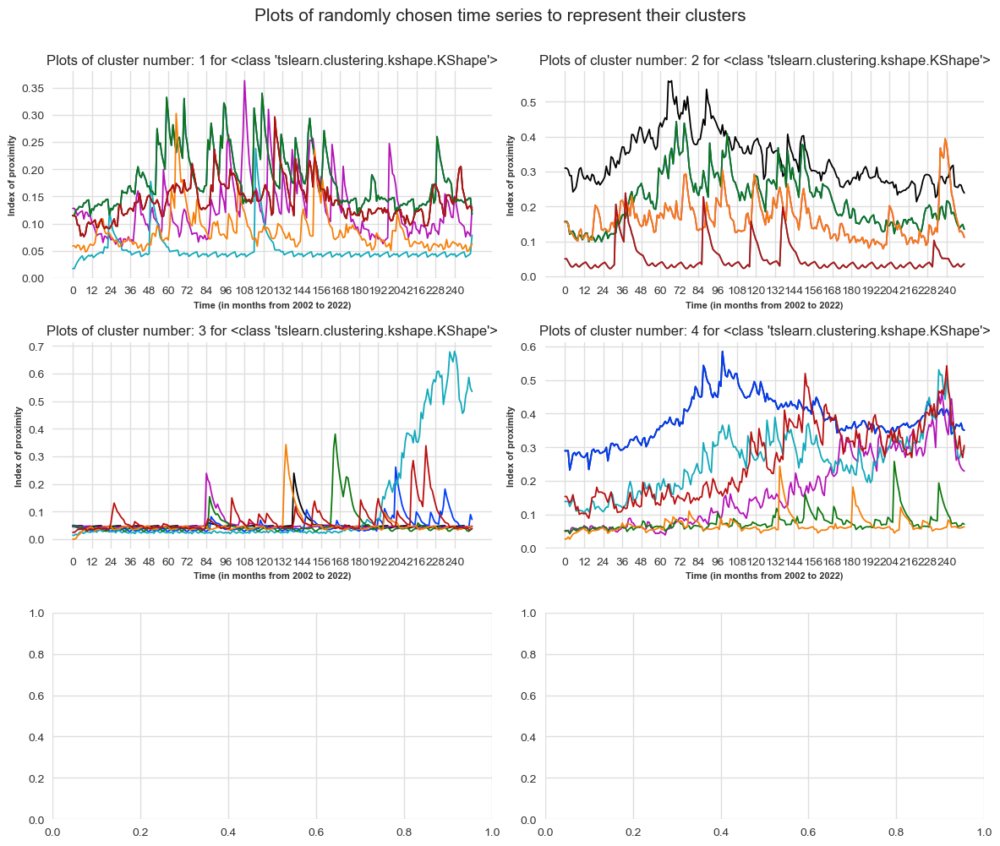

It took 3 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

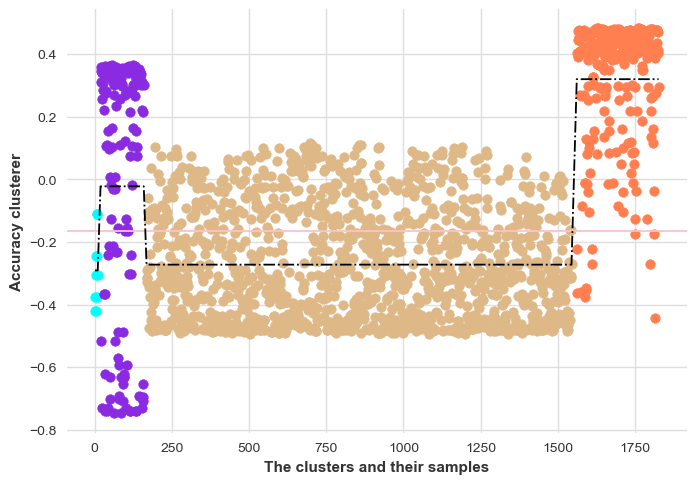

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


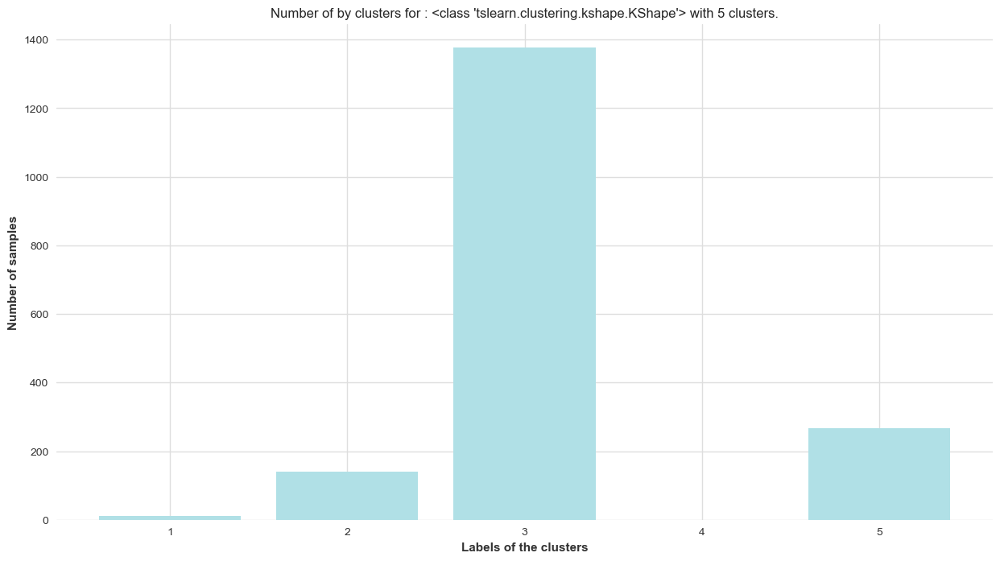

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


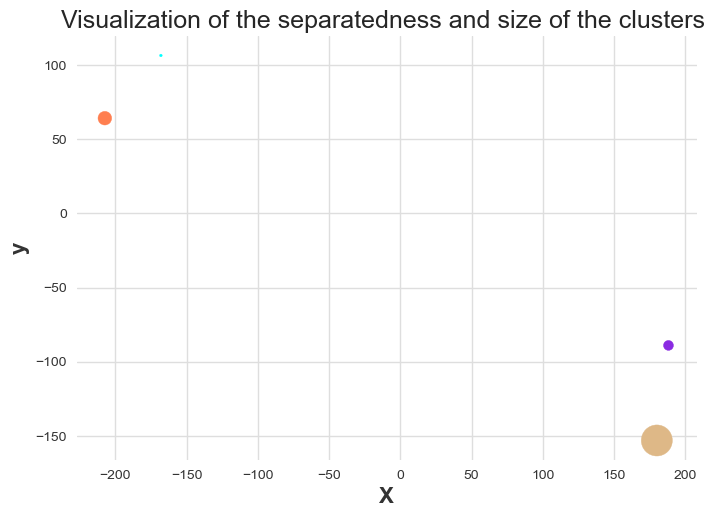

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


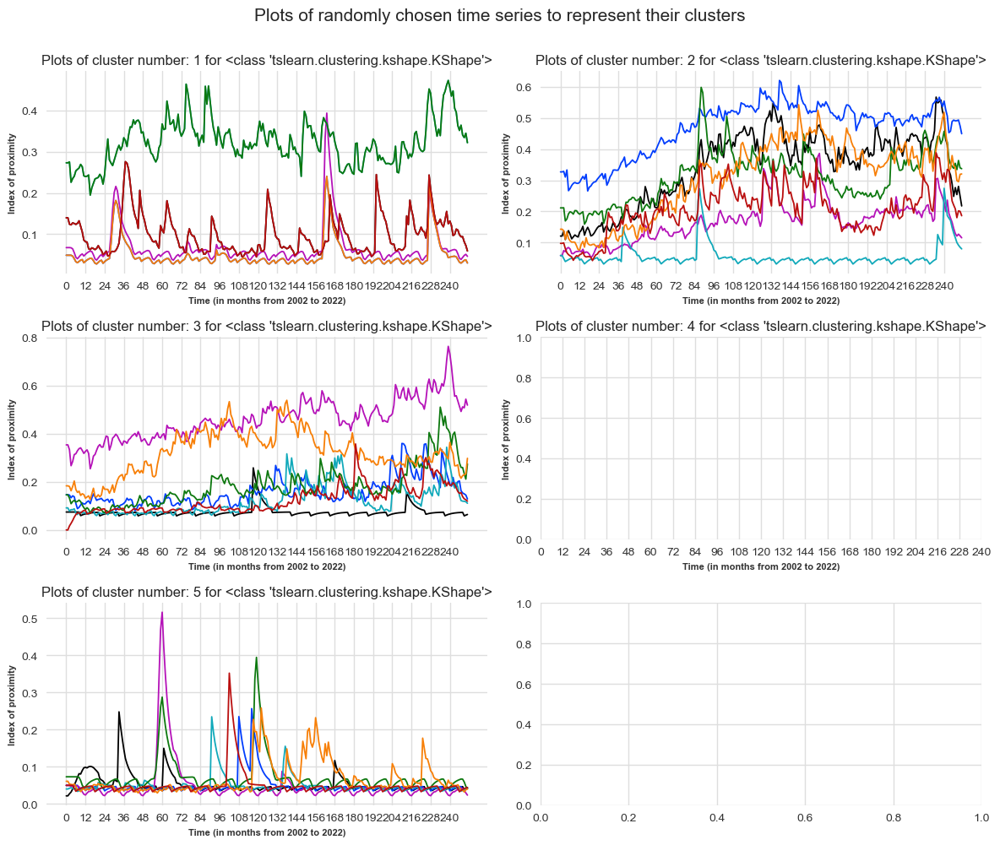

It took 1 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
0.322 --> Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed bec

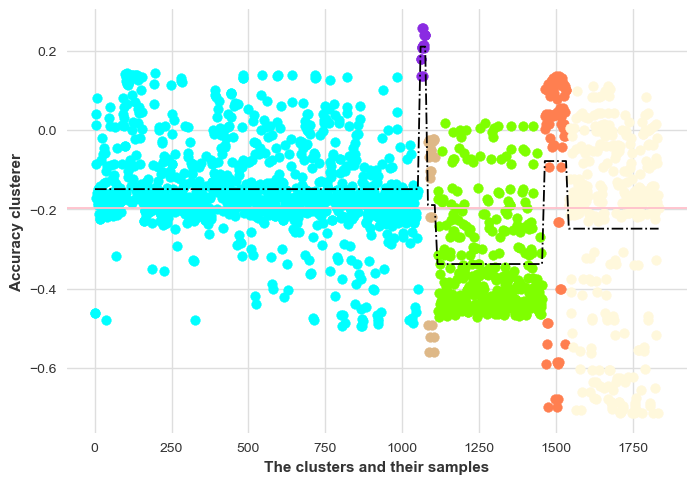

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


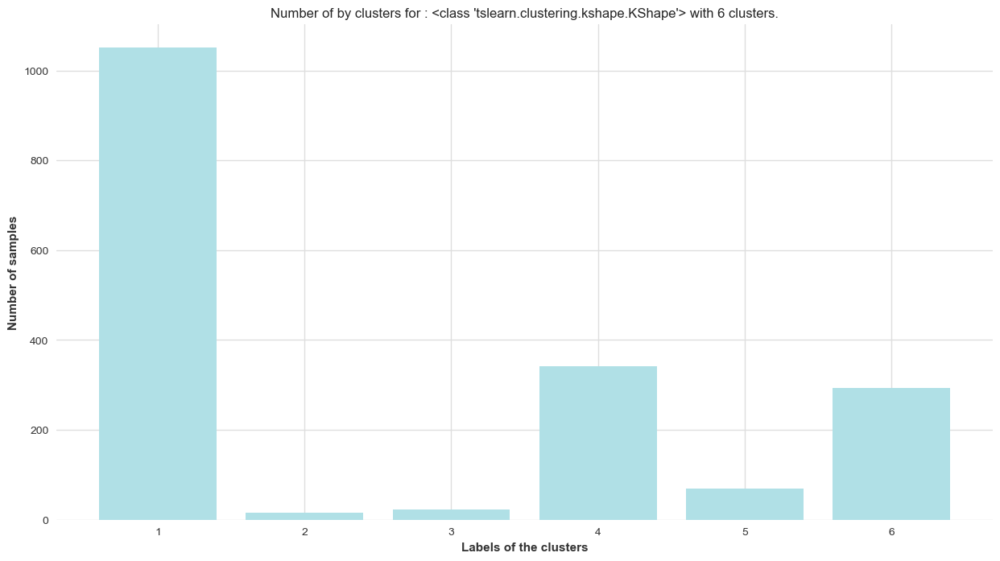

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


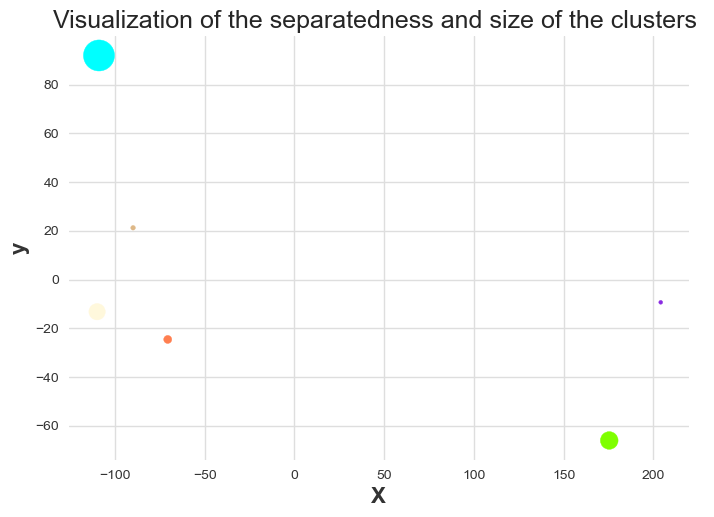

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


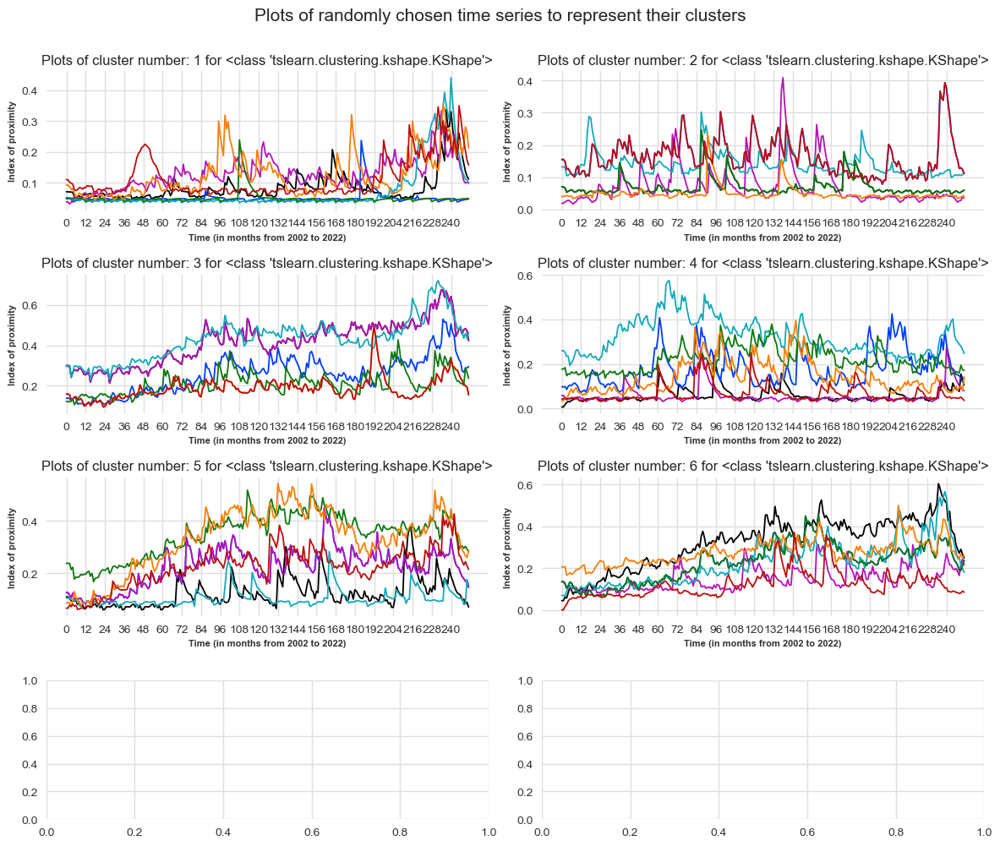

It took 1 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

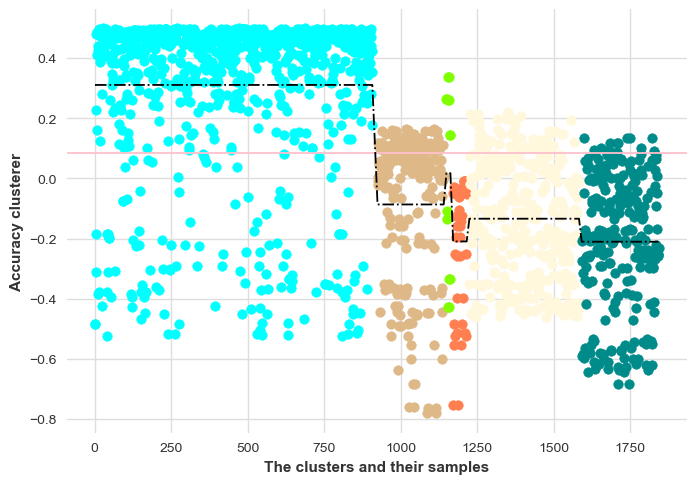

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


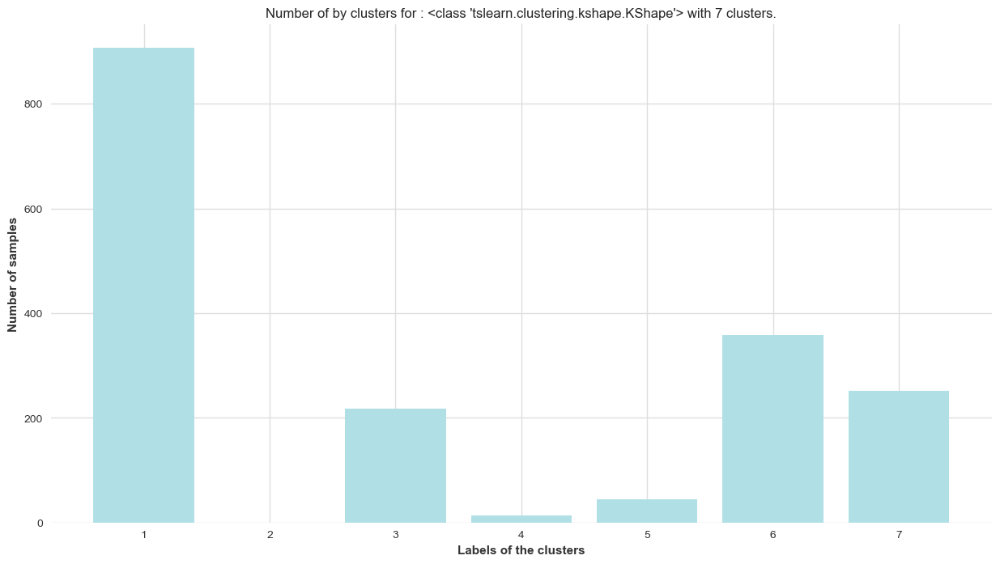

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


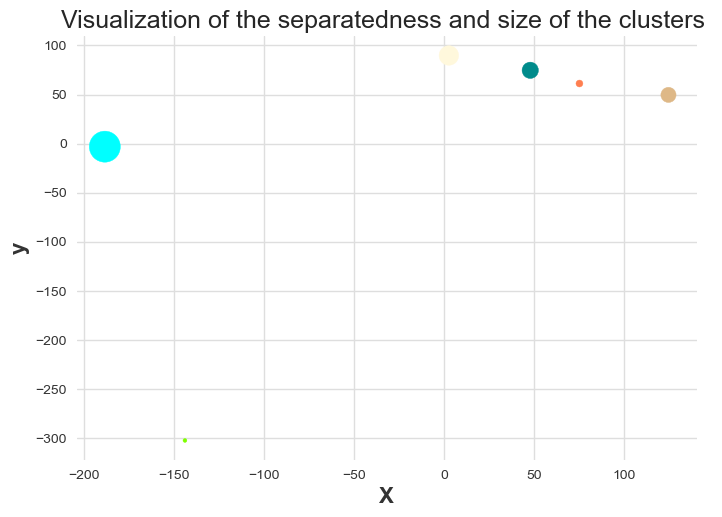

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


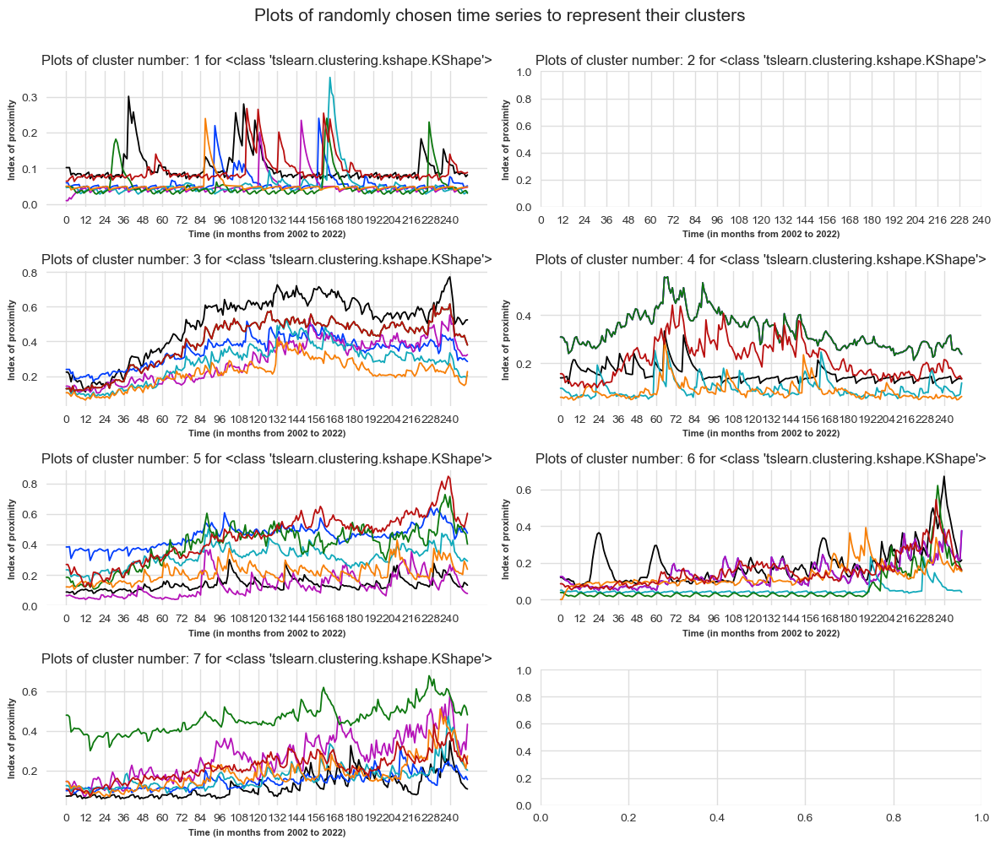

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

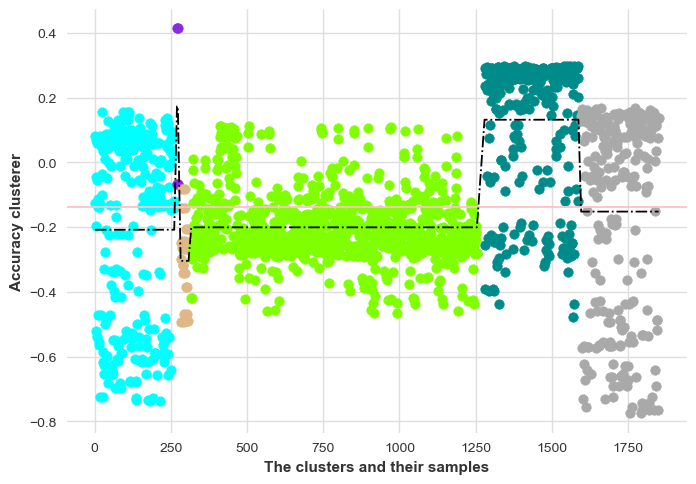

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


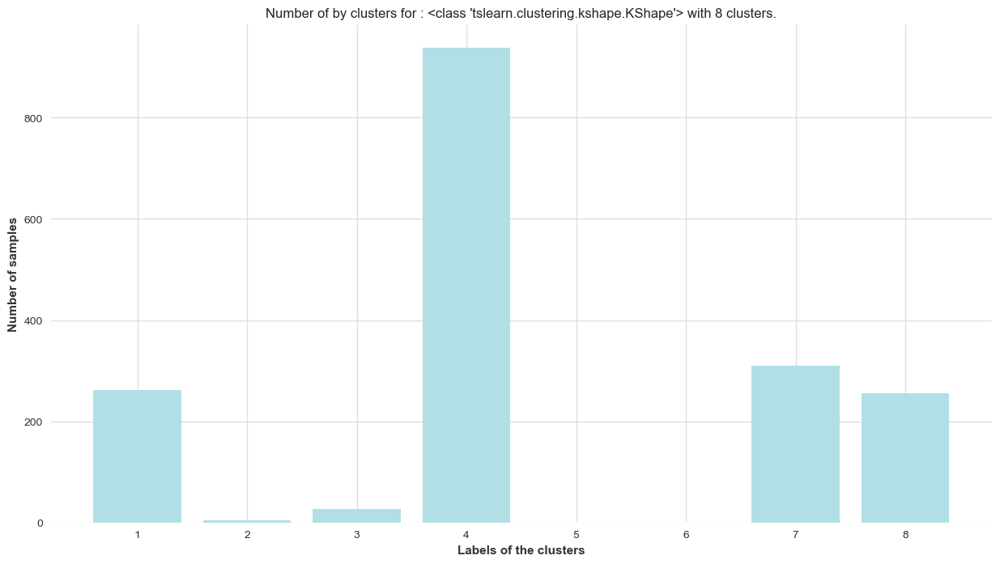

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


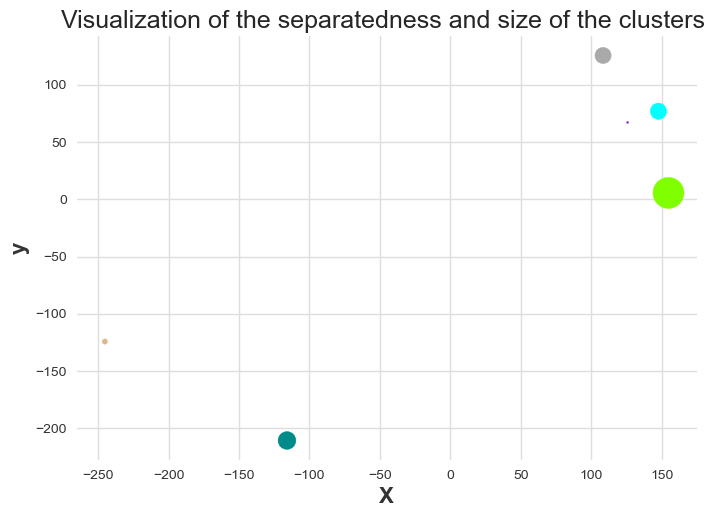

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


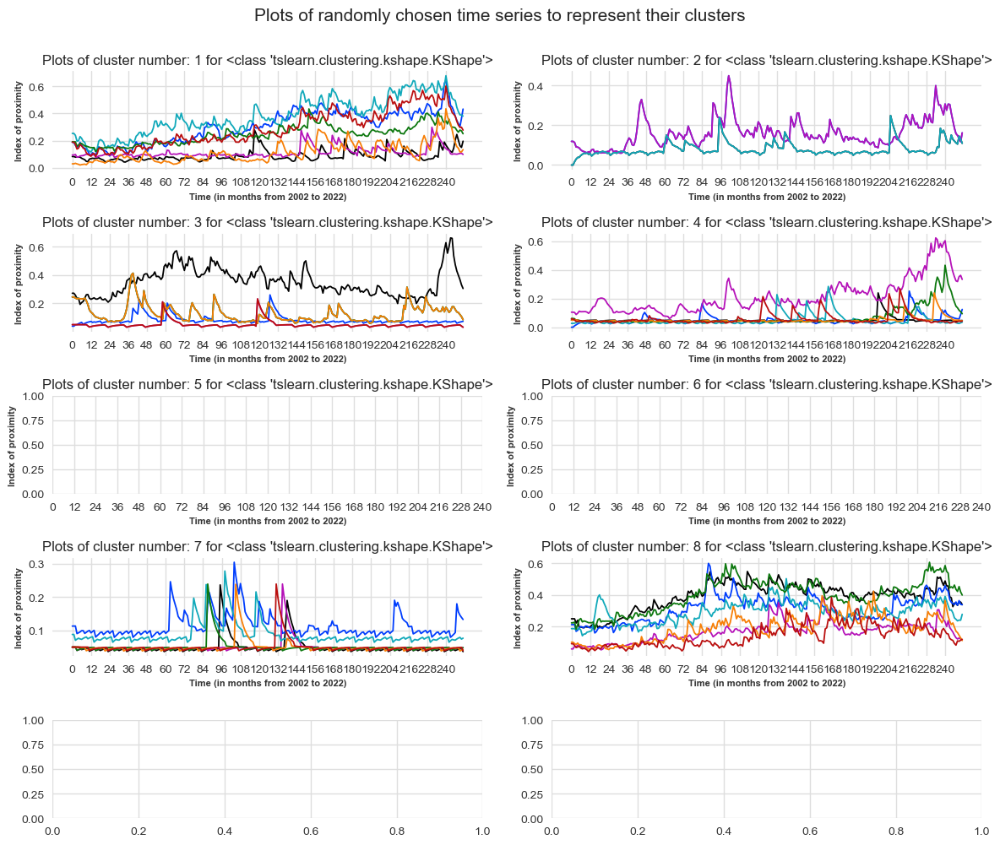

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

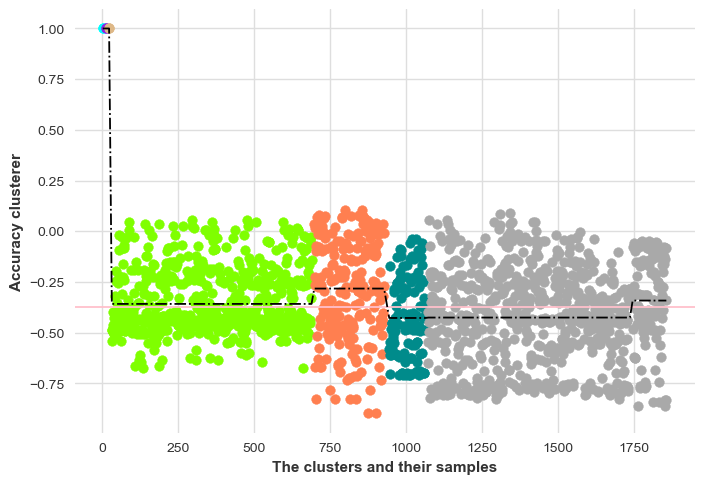

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


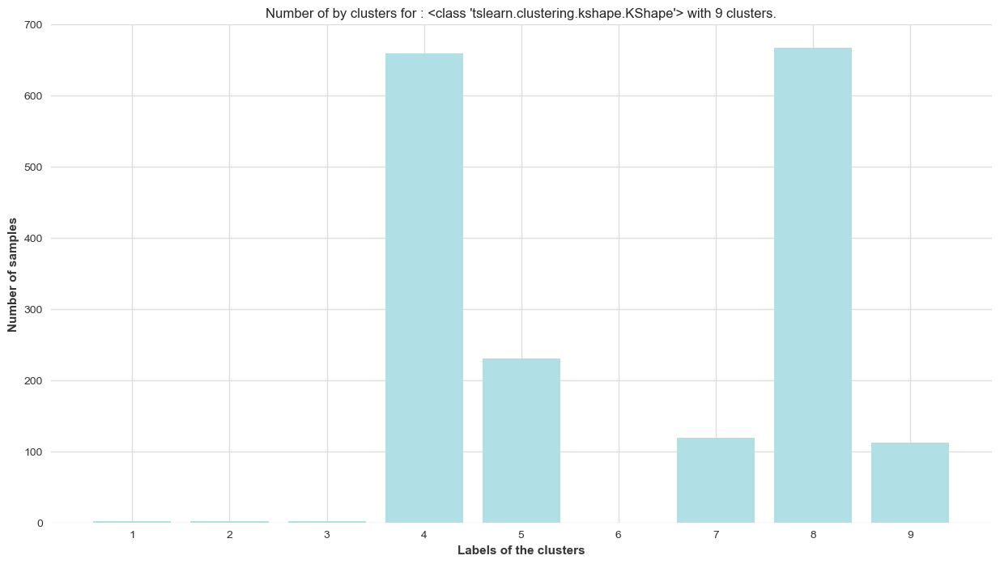

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


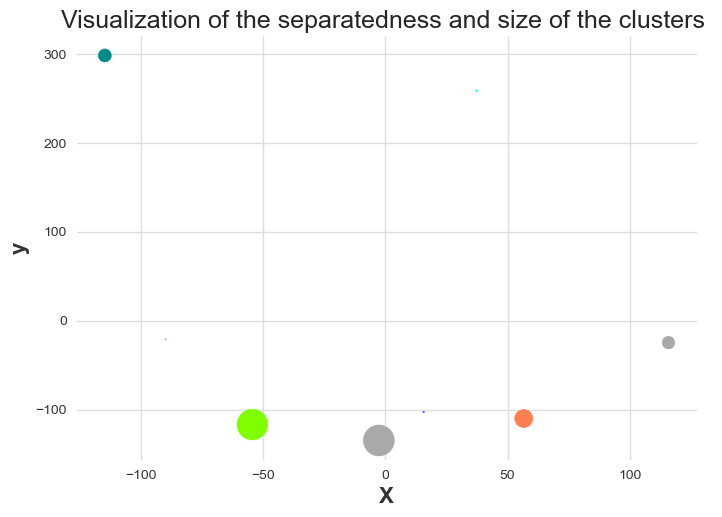

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


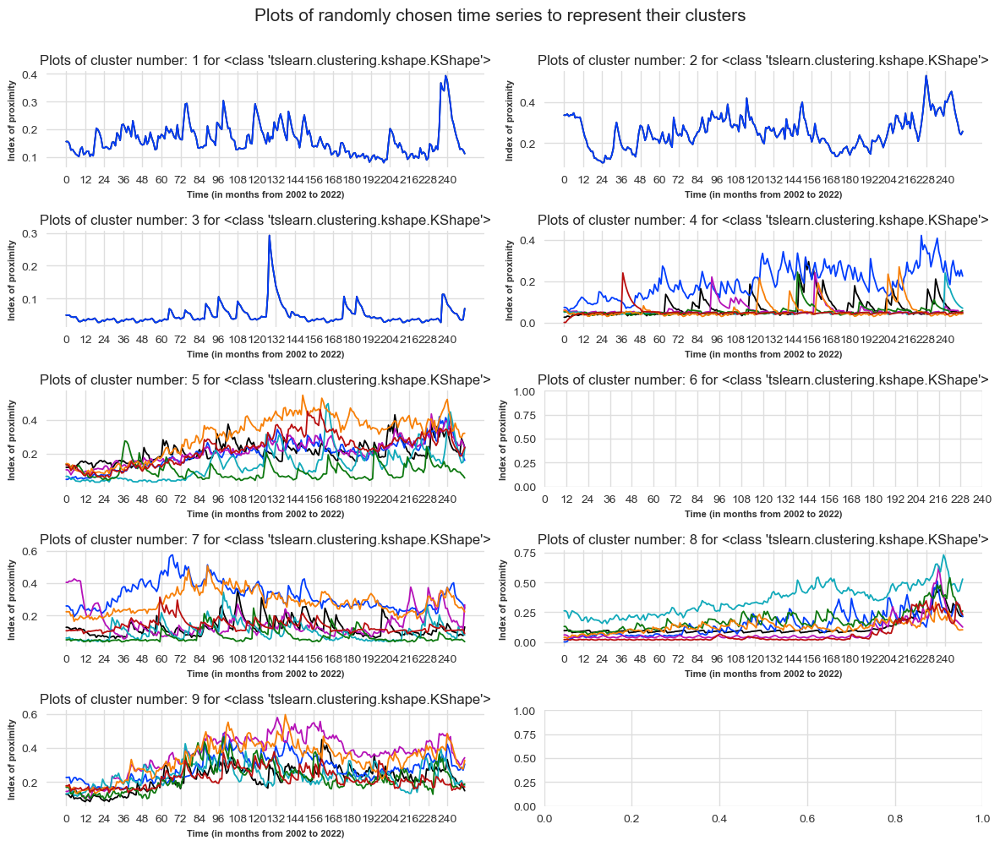

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

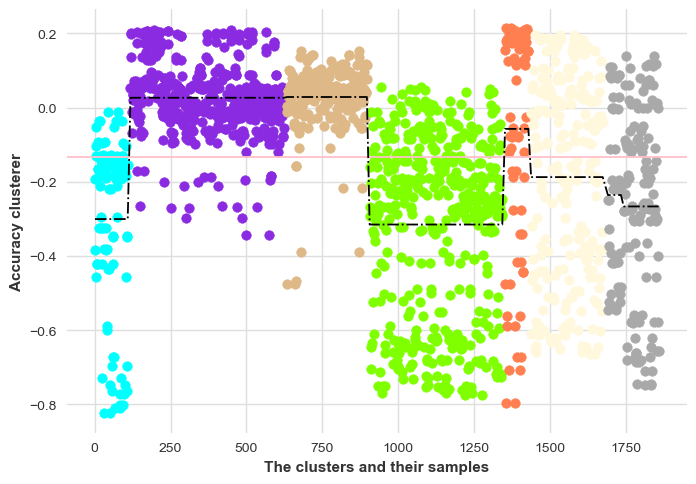

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


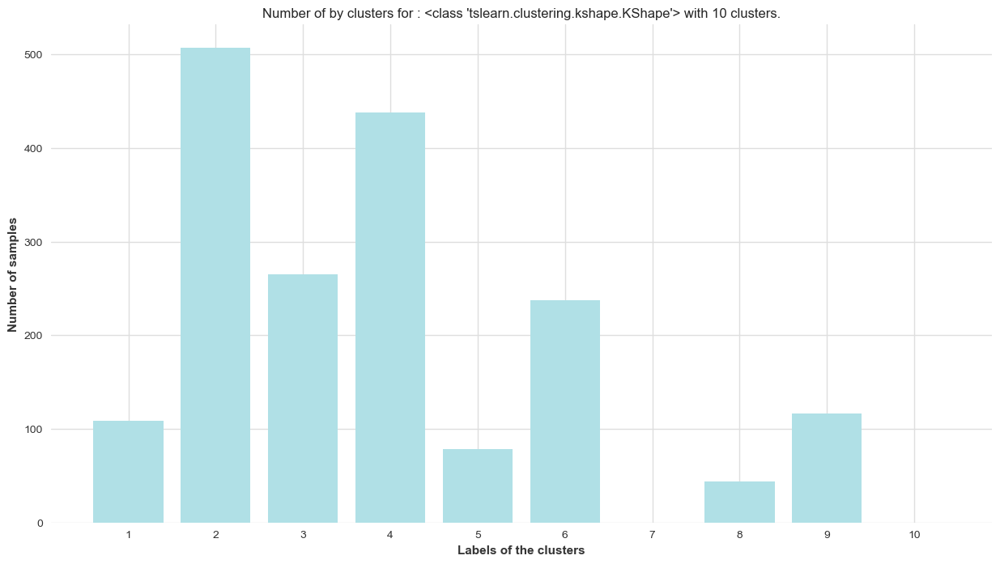

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


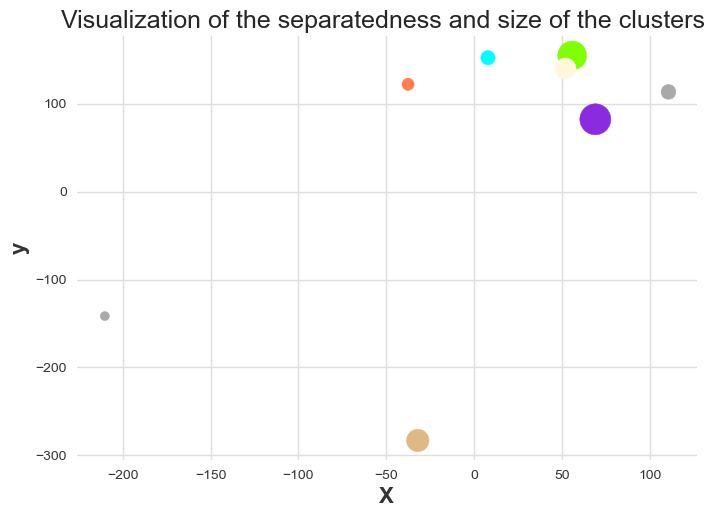

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


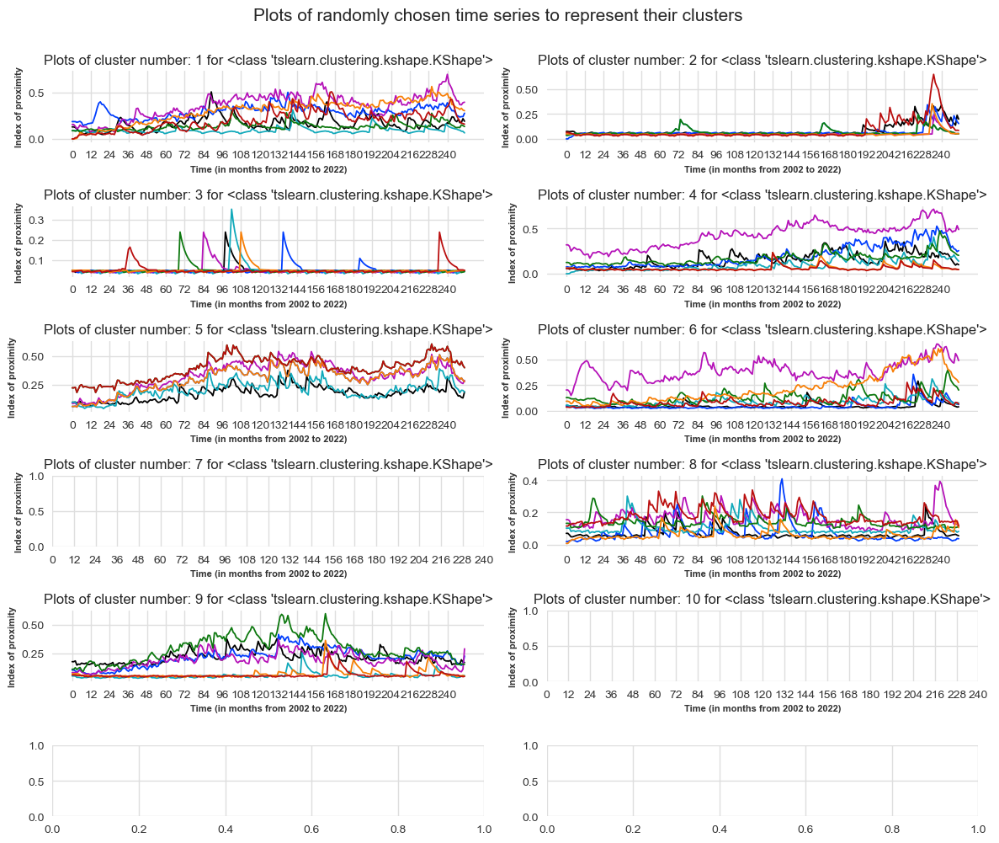

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

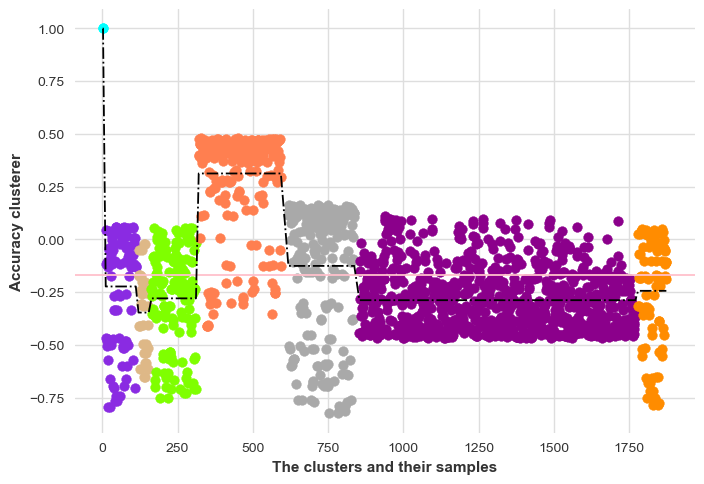

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


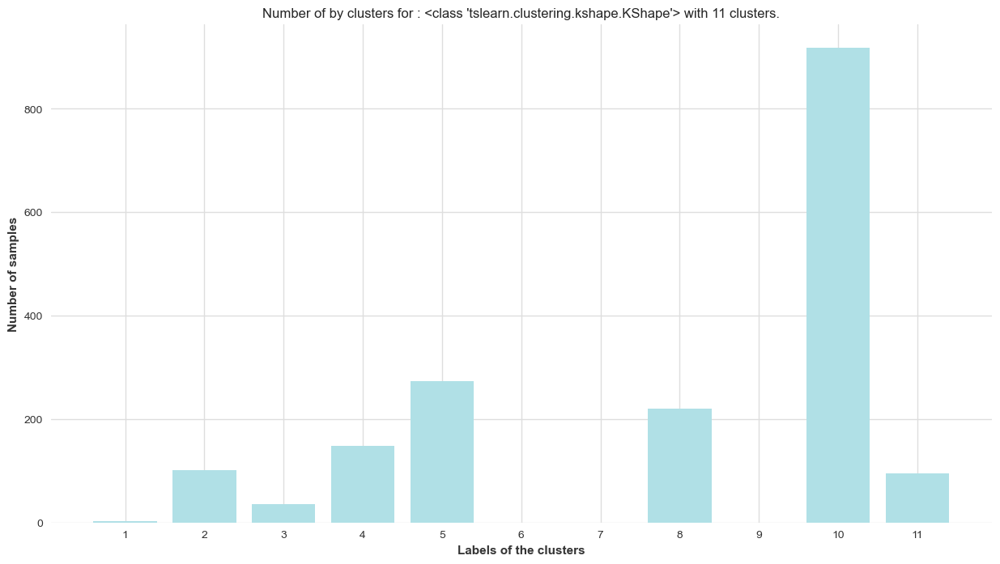

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


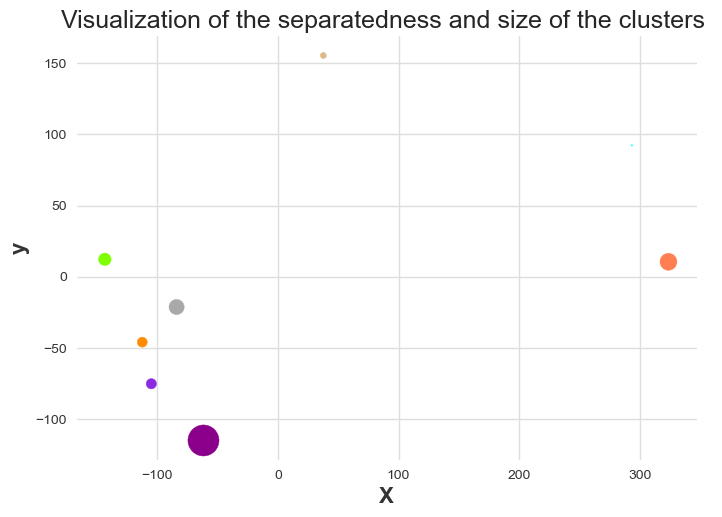

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


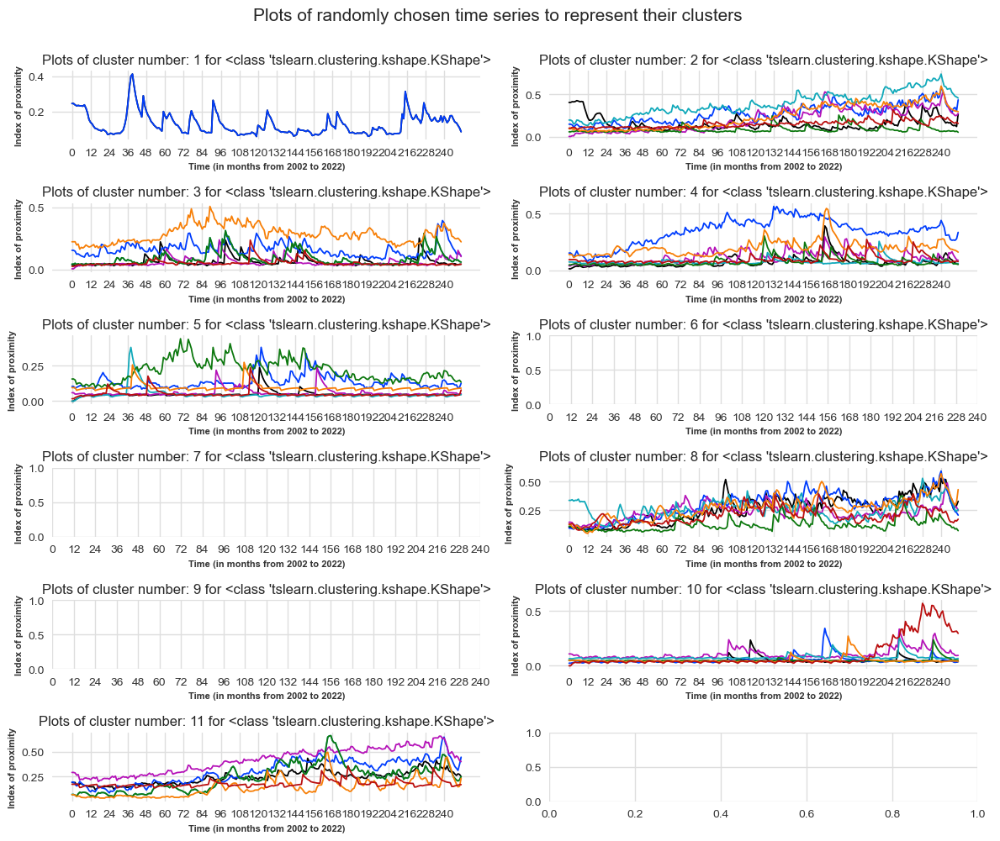

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

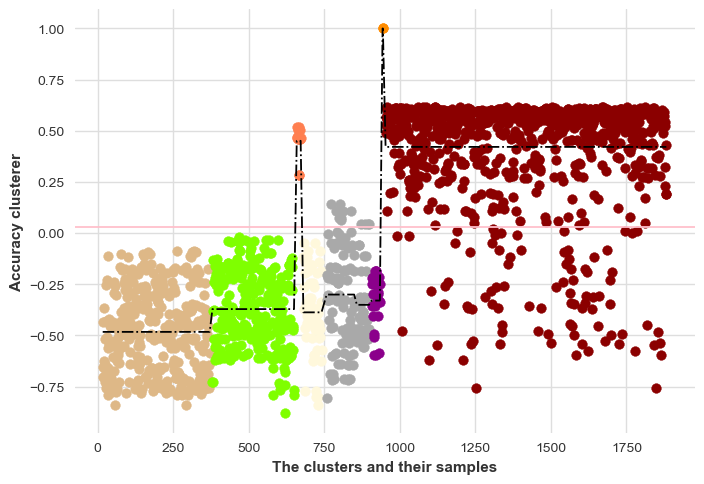

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


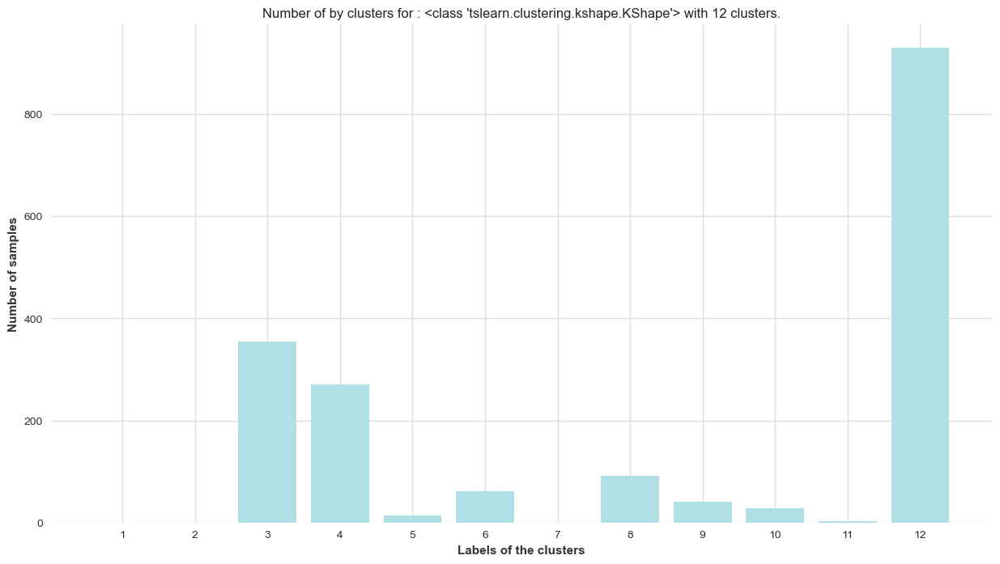

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


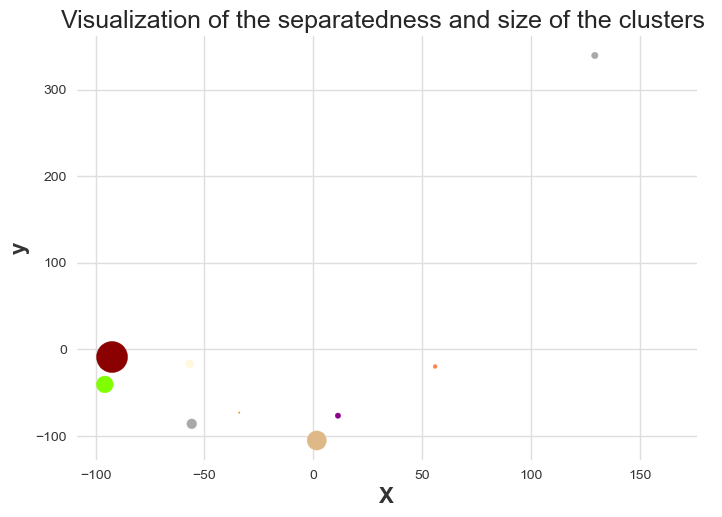

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


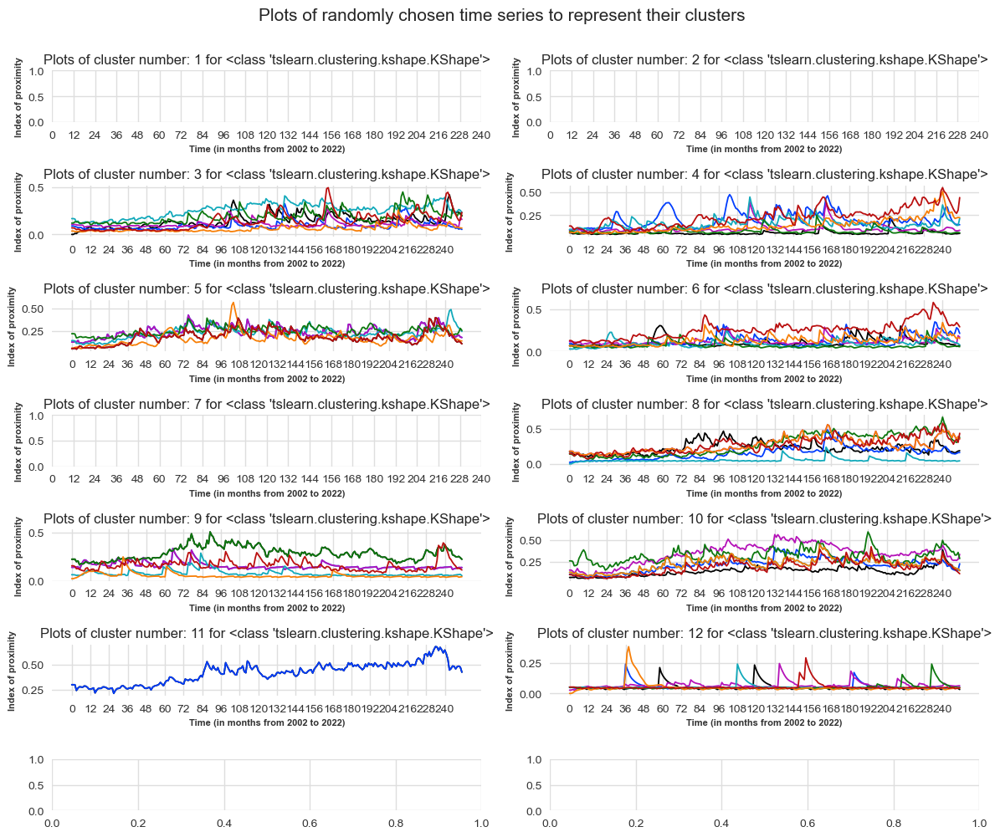

It took 2 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

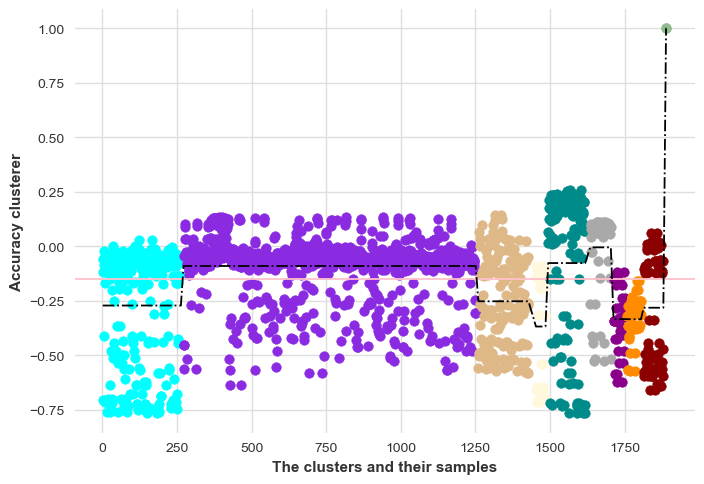

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


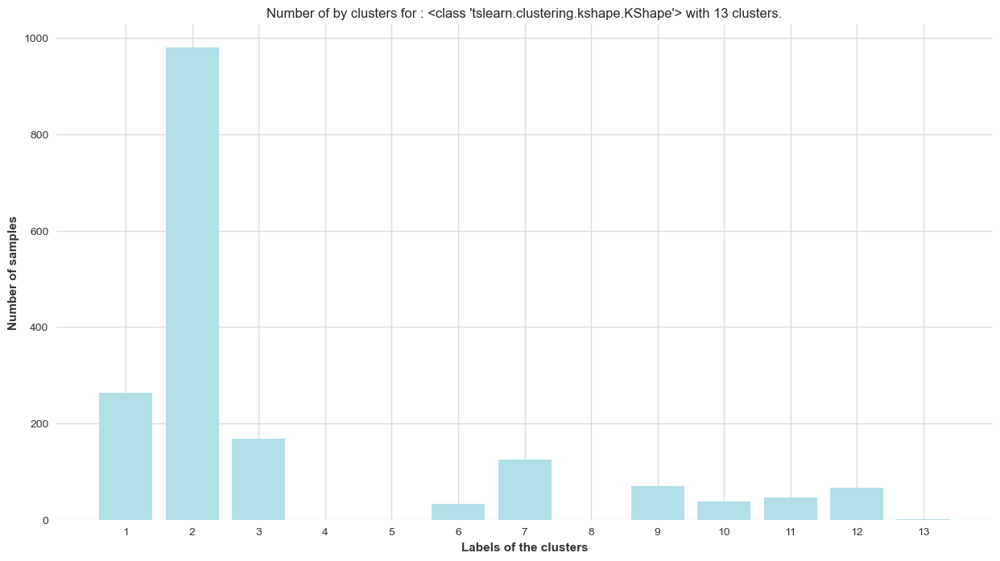

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


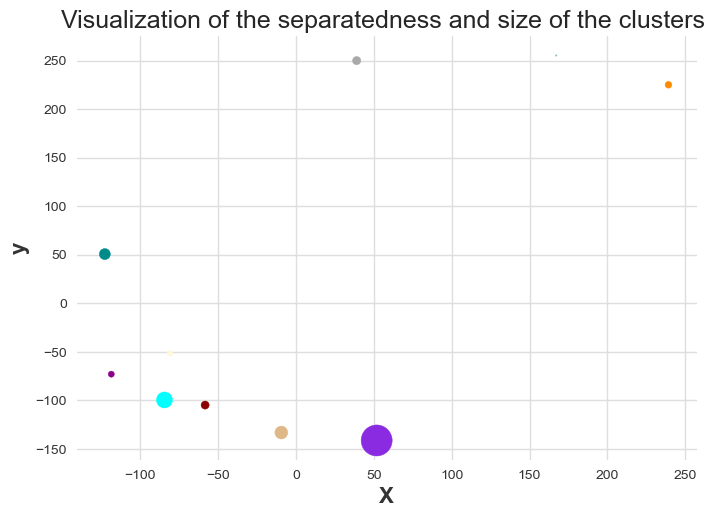

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


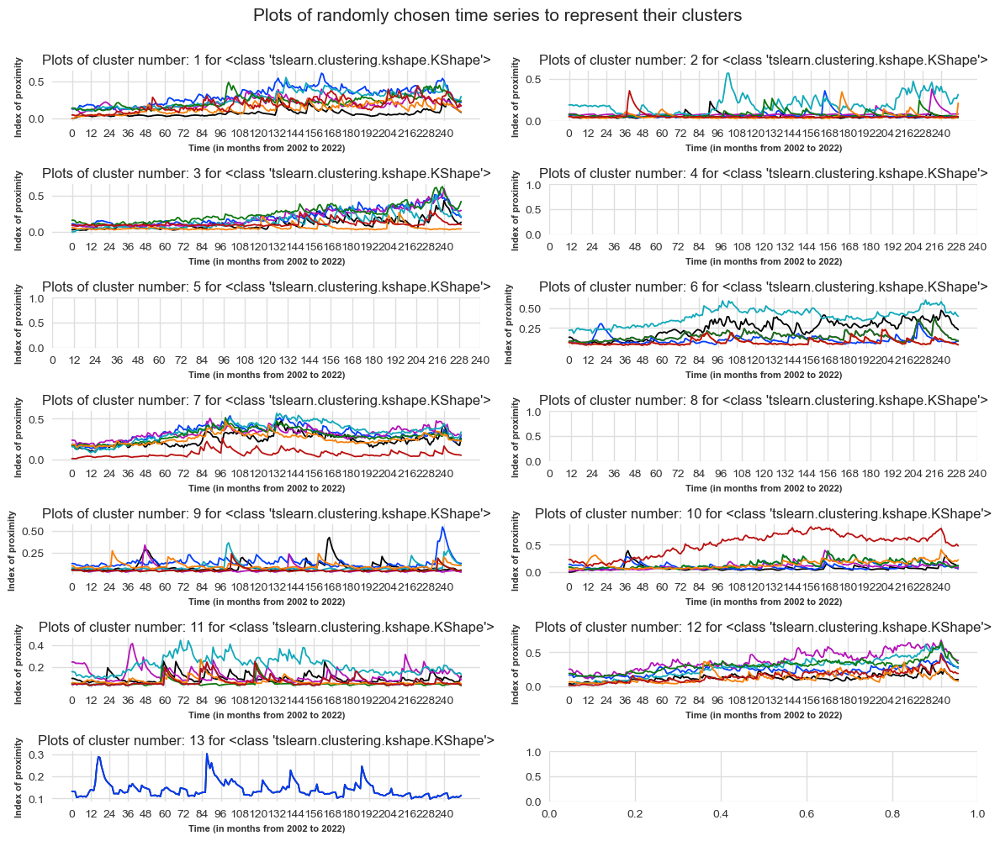

It took 4 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

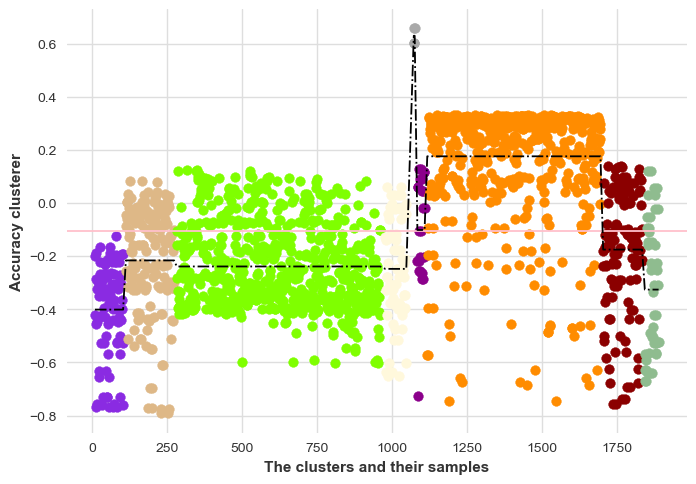

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


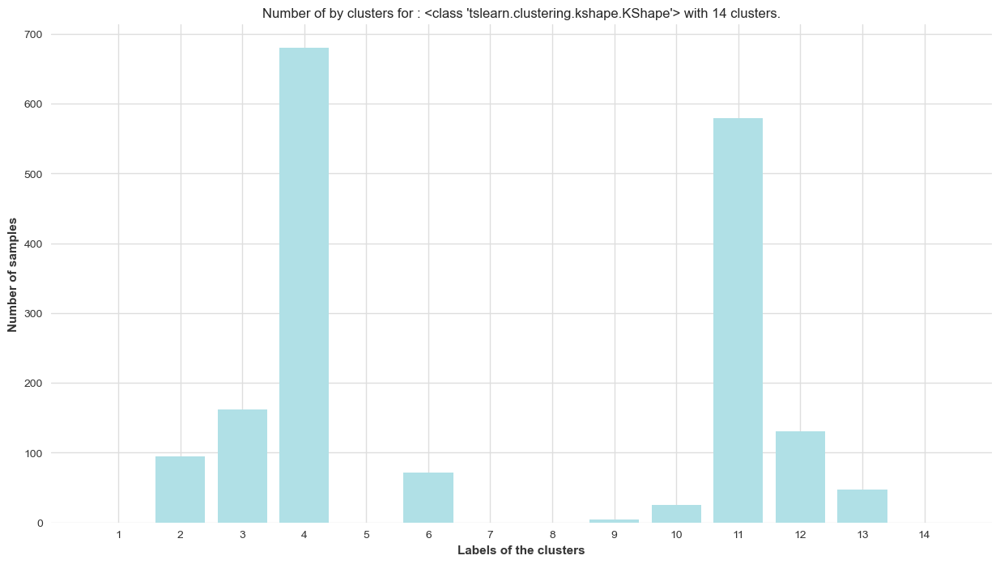

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


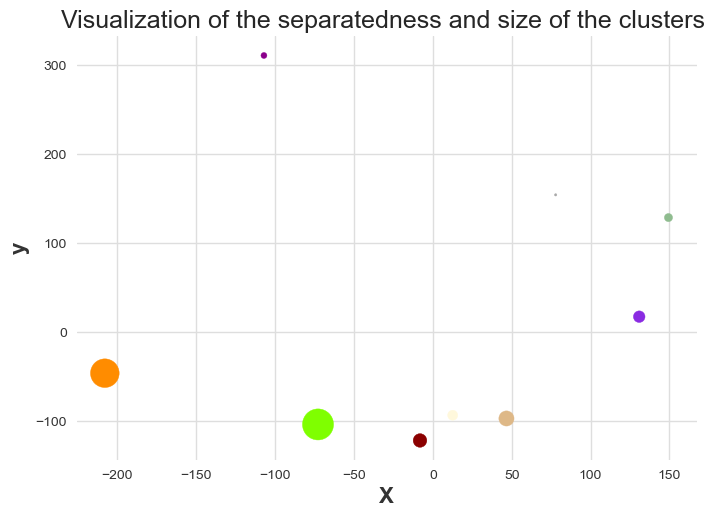

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


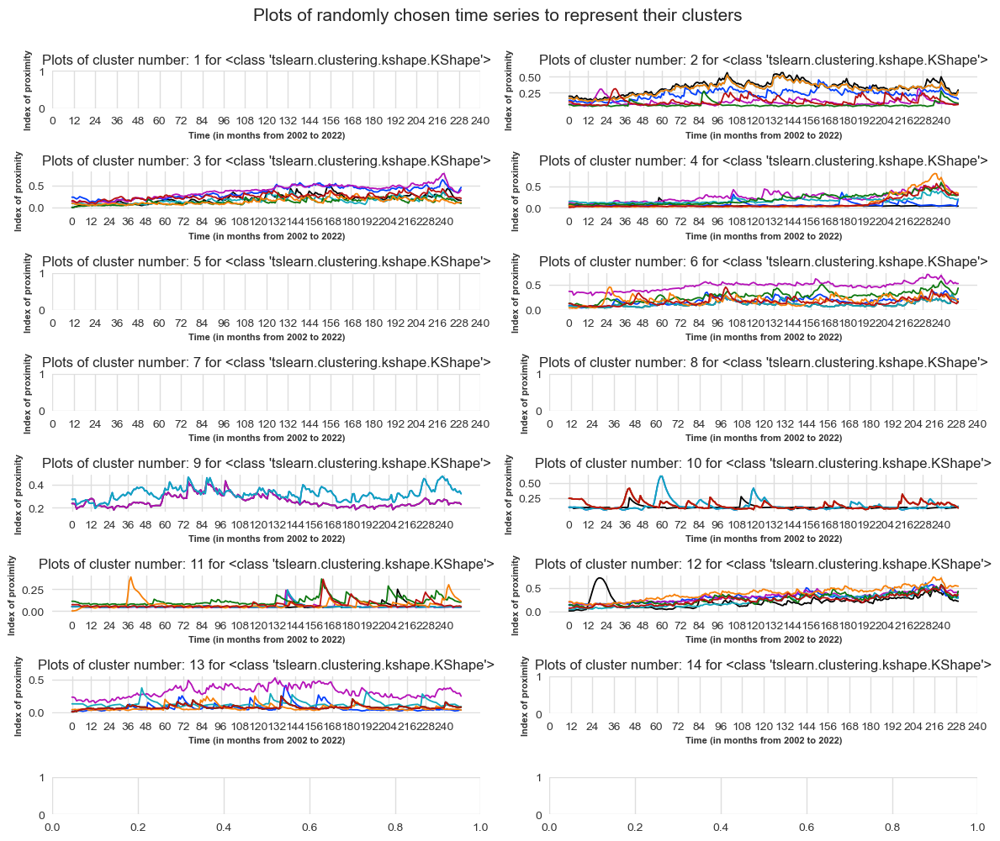

It took 3 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

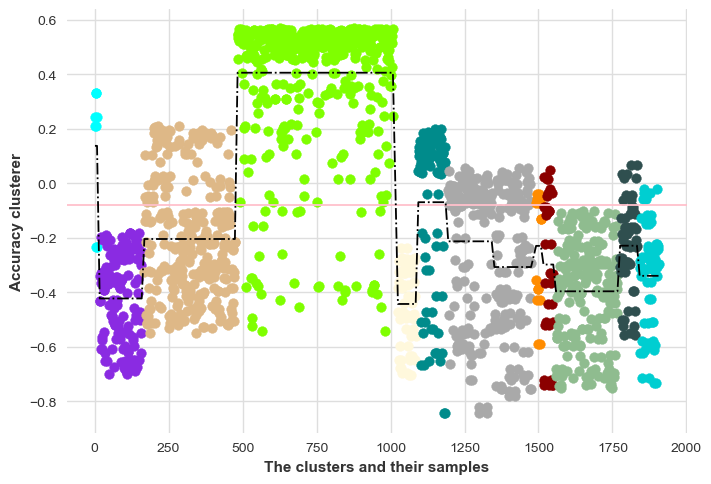

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


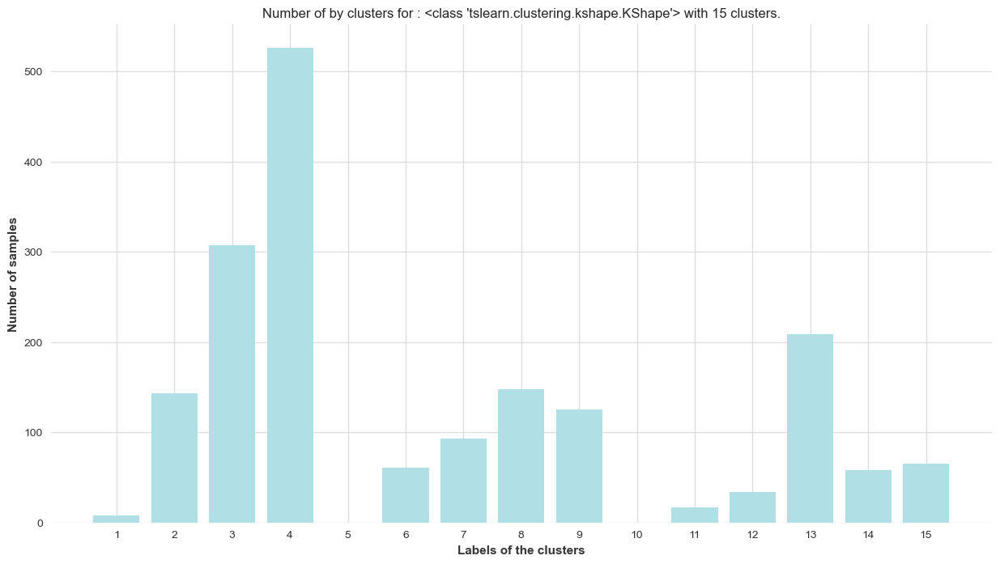

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


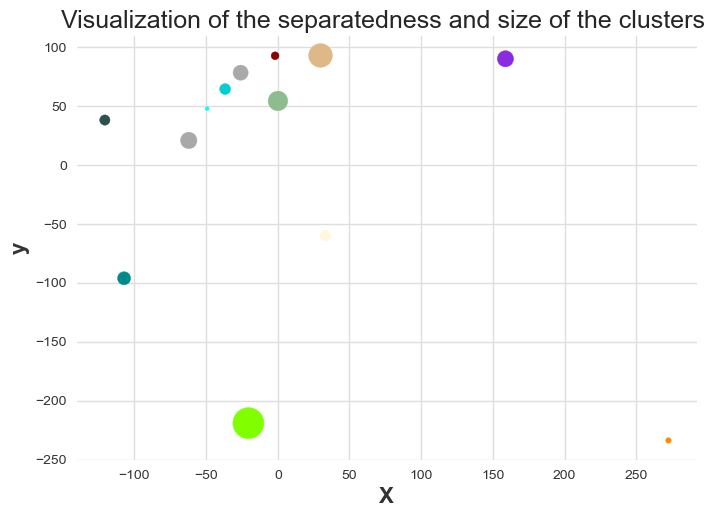

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


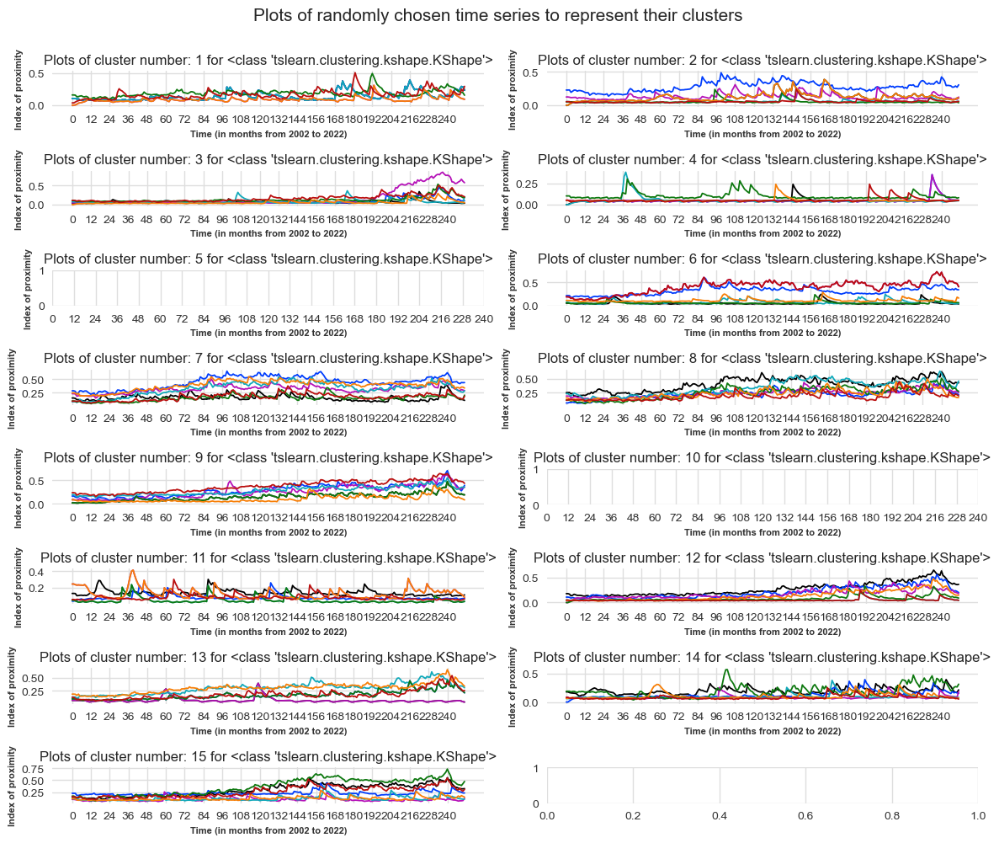

It took 3 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

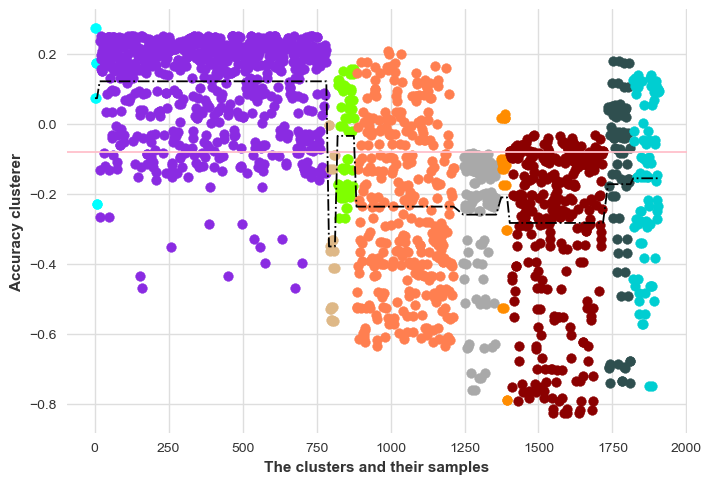

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


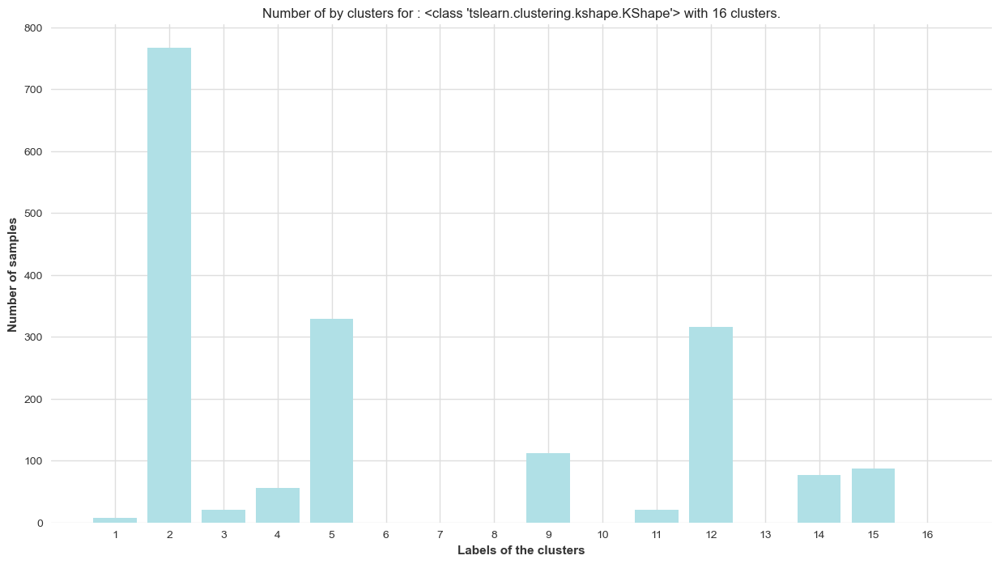

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


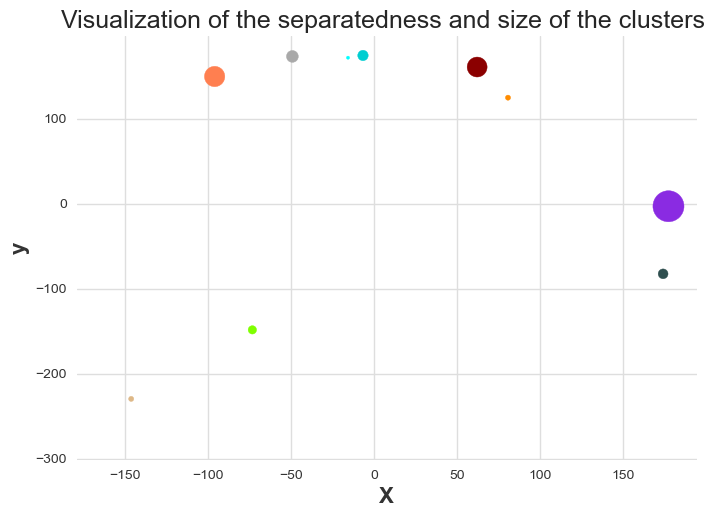

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


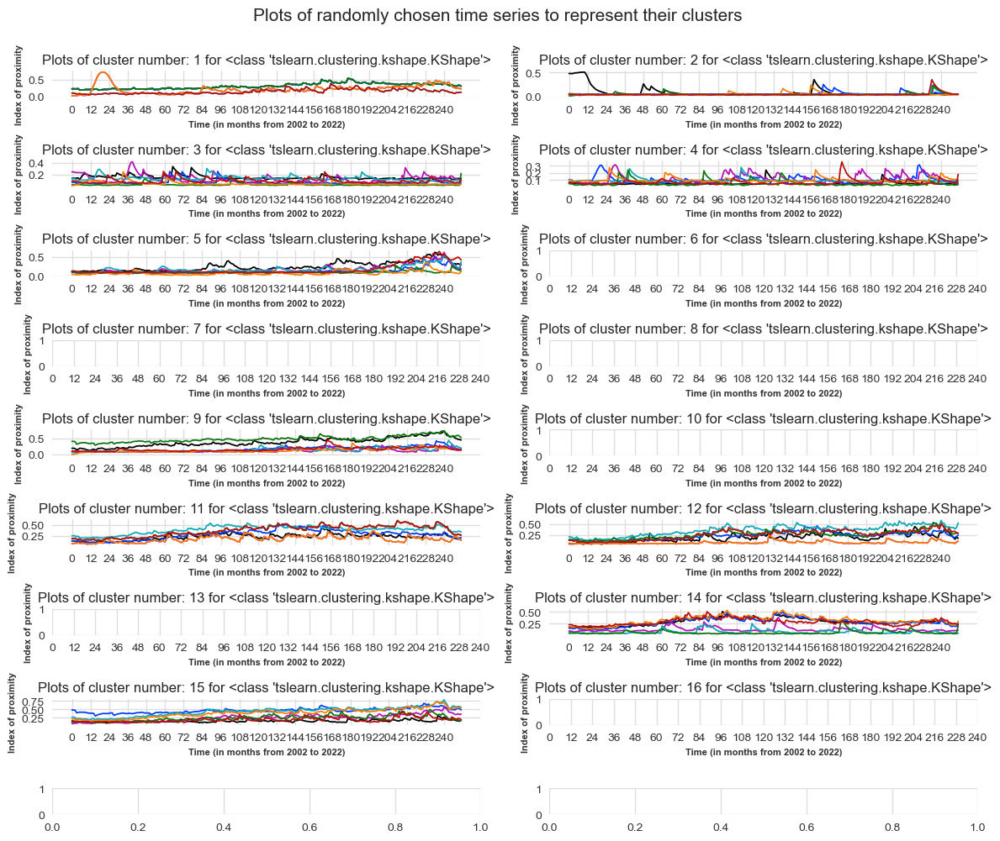

It took 3 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

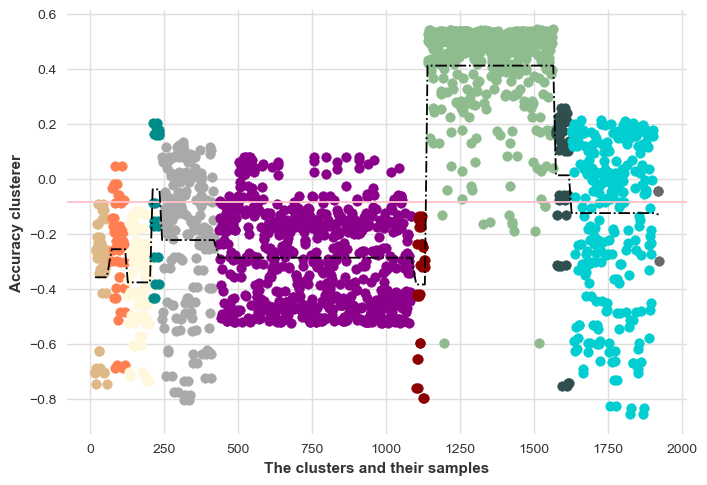

It took 1 seconds to compute the silhouette score and to visualize it as a scatter plot.


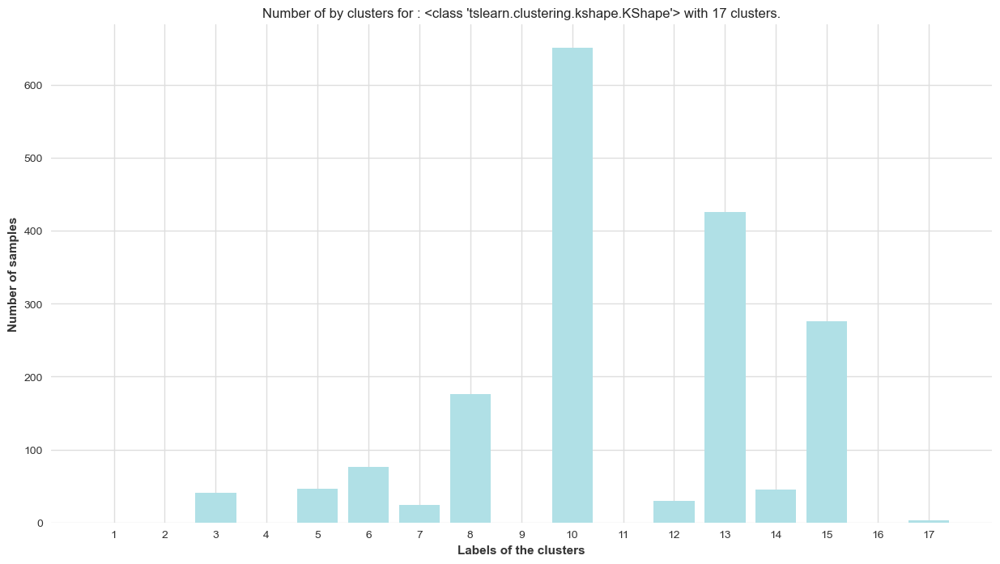

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


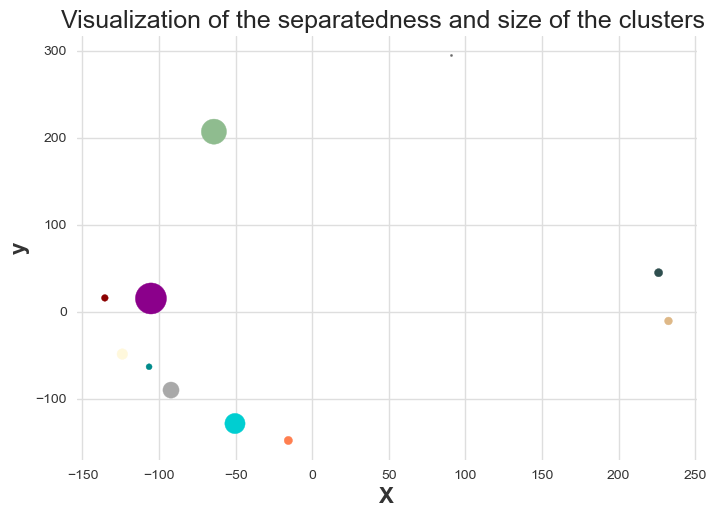

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


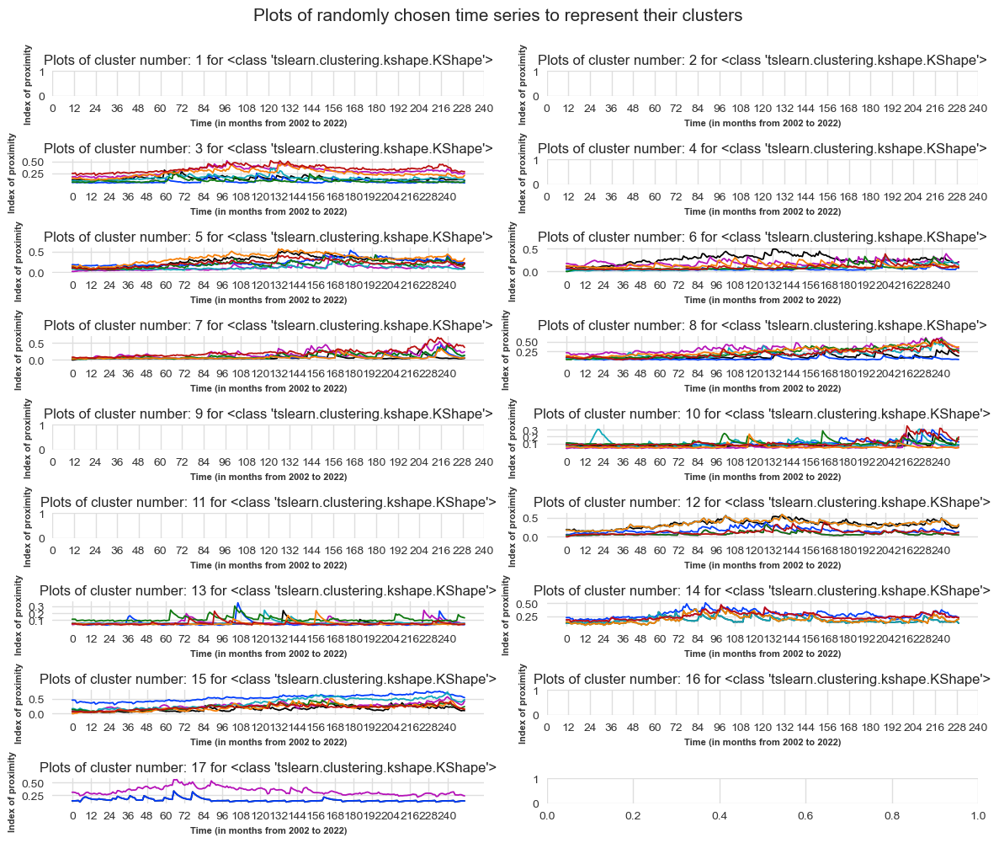

It took 3 seconds to plot the chosen time series.
 
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of em

KeyboardInterrupt: 

In [232]:
for number in numbercluster:
    myclusterer = evaluate_clusterer(KShape,dftraincluster, dfcluster,n_clusters=number, init_algorithm="kmeans++", max_iter=400,\
    metric="wddtw",random_state=1, n_init=40,distance_viz='l1',colors=colors)

We can see that to have 5 or 6 clusters is okay, while the rest is bad and does not make much sense.

<div class="alert-info">
10. Fitting the best clusterers with the best numbers of clusters
</div>

In [330]:
bestnumber_cluster = 5

In [331]:
algo = KShape

In [332]:
# hdpscan /density based algorithm to think about it maybe

Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster
Init 1
Resumed because of empty cluster


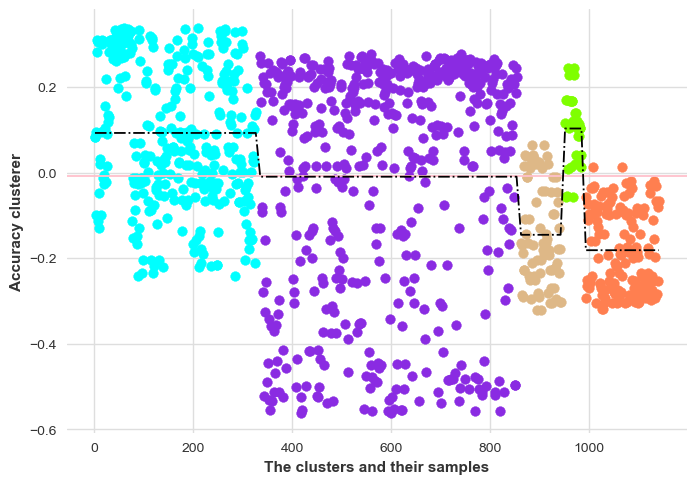

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


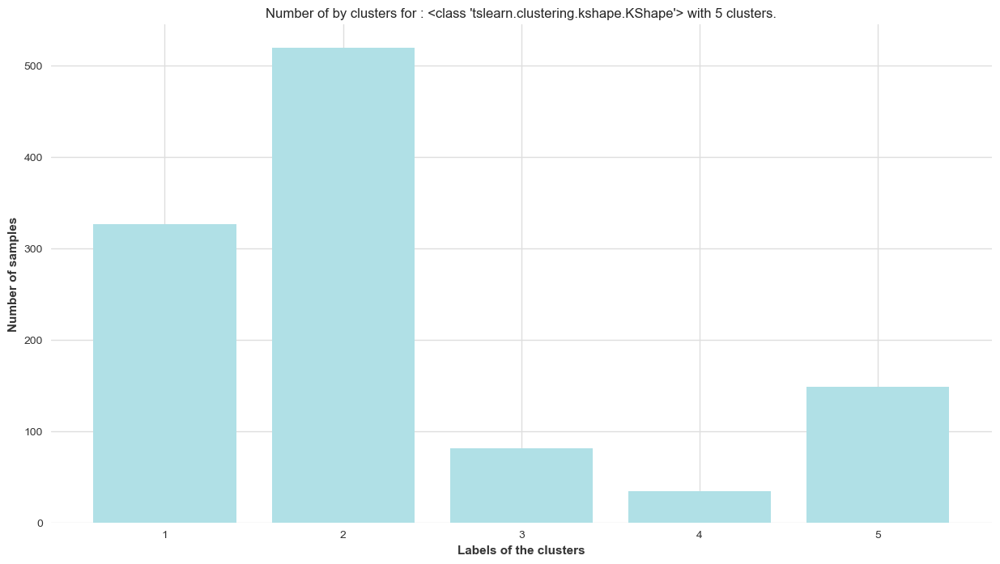

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


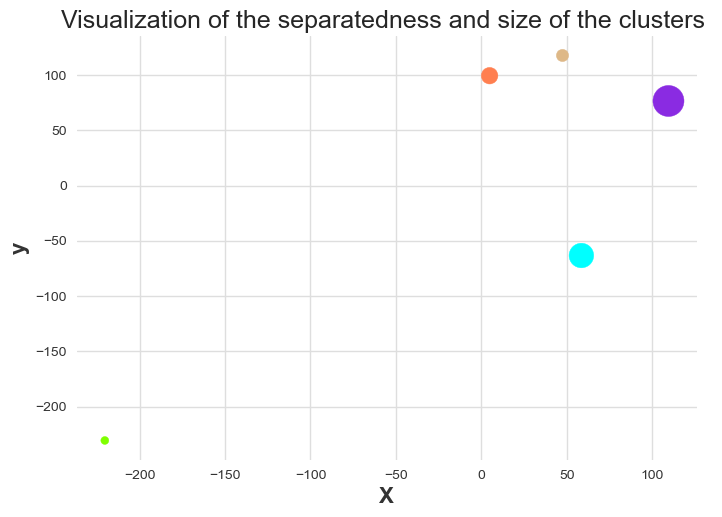

It took 7 seconds to compute visualize on a surface the clusters and the distance between the centroids.


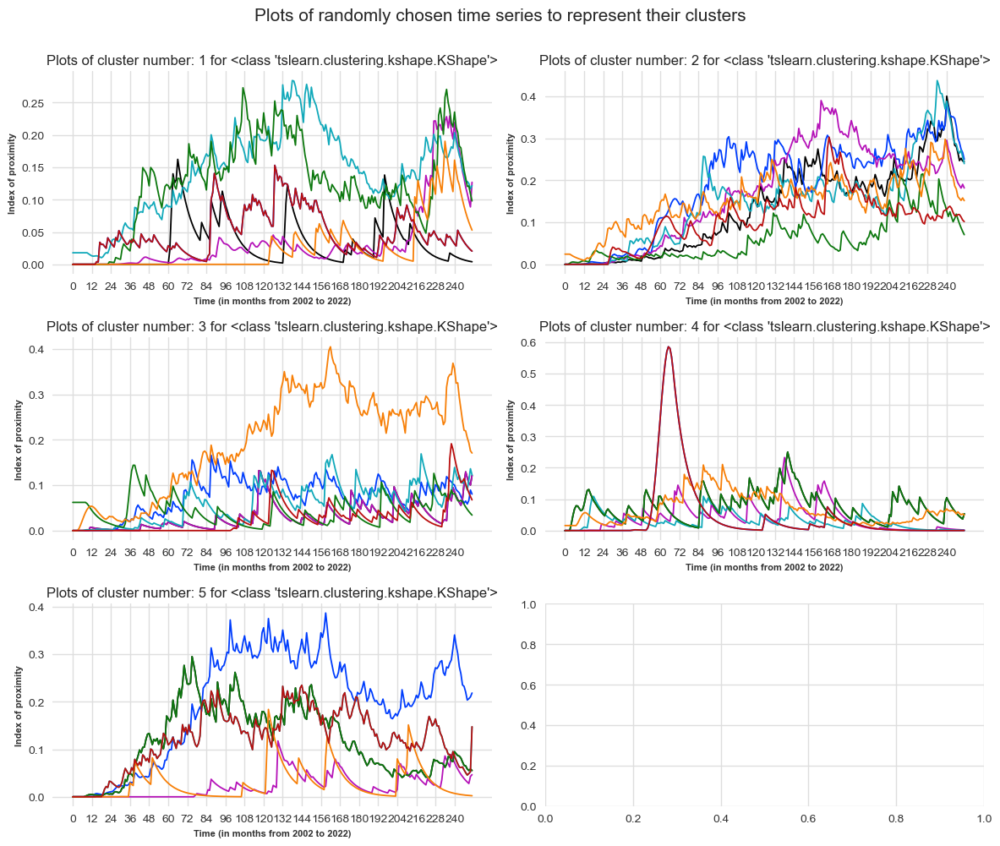

It took 1 seconds to plot the chosen time series.
 


In [333]:
myclusterer = evaluate_clusterer(algo,dftraincluster, dfcluster,n_clusters=bestnumber_cluster, init_algorithm="kmeans++", max_iter=500,\
metric="wddtw",random_state=1, n_init=50,distance_viz='l1',colors=colors)

Let us compare it with fitting the algorithm with data from the my sample of data.

Init 1
Resumed because of empty cluster
Init 1
0.194 --> 0.187 --> 0.184 --> 0.183 --> 0.183 --> 
Init 2
0.208 --> 0.192 --> 0.190 --> 0.187 --> 0.171 --> 0.147 --> 0.144 --> 0.142 --> 0.141 --> 0.141 --> 0.139 --> 0.138 --> 0.137 --> 0.137 --> 0.136 --> 0.135 --> 0.135 --> 0.135 --> 0.134 --> 0.134 --> 0.133 --> 0.133 --> 0.133 --> 0.132 --> 0.132 --> 0.132 --> 0.131 --> 0.131 --> 0.131 --> 0.130 --> 0.130 --> 0.130 --> 0.130 --> 0.130 --> 0.130 --> 0.129 --> 0.129 --> 0.129 --> 0.129 --> 0.129 --> 0.129 --> 0.129 --> 0.129 --> 
Init 3
Resumed because of empty cluster
Init 3
0.207 --> 0.187 --> 0.173 --> 0.172 --> 0.171 --> 0.171 --> 0.171 --> 0.170 --> 0.170 --> 0.170 --> 0.169 --> 0.169 --> 0.168 --> 0.168 --> 0.168 --> 0.167 --> 0.166 --> 0.166 --> 0.165 --> 0.165 --> 0.164 --> 0.164 --> 0.163 --> 0.163 --> 0.162 --> 0.162 --> 0.161 --> 0.160 --> 0.160 --> 0.159 --> 0.158 --> 0.158 --> 0.157 --> 0.156 --> 0.155 --> 0.154 --> 0.154 --> 0.153 --> 0.152 --> 0.152 --> 0.151 --> 0.150 -

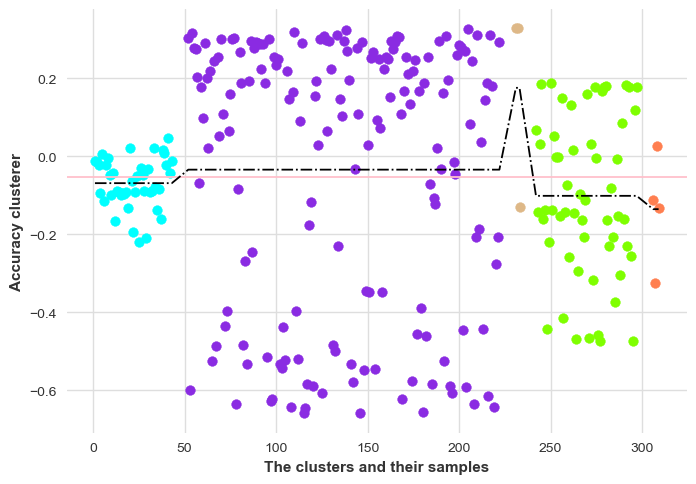

It took 0 seconds to compute the silhouette score and to visualize it as a scatter plot.


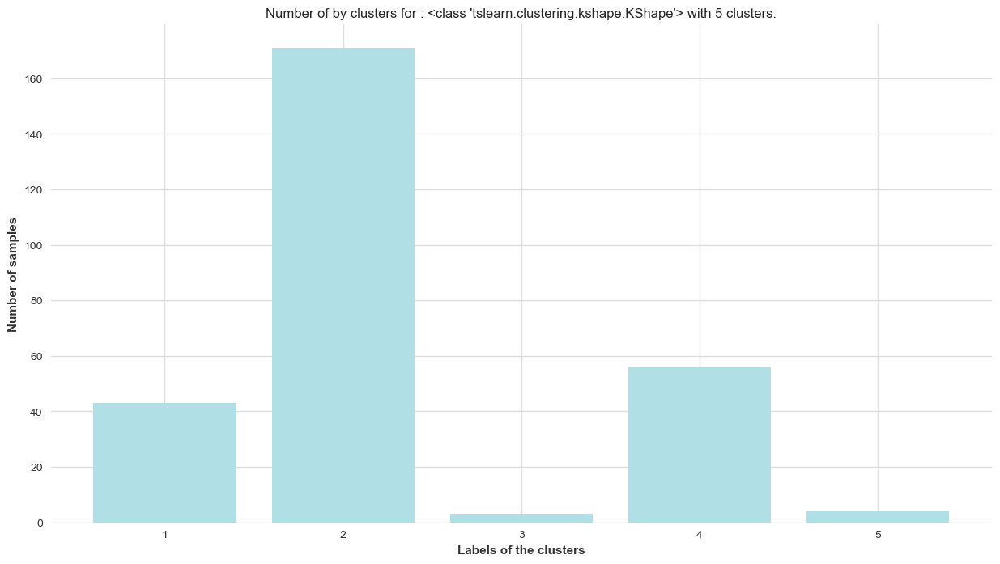

It took 0 seconds to visualize a bar chart with the distribution of samples among the clusters.


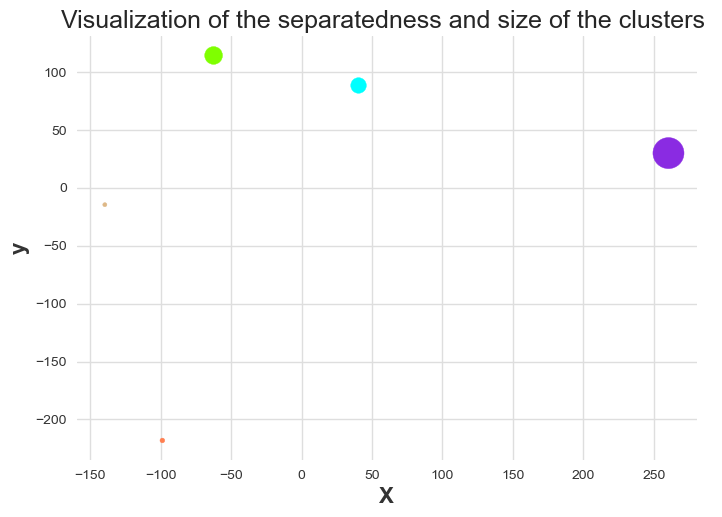

It took 0 seconds to compute visualize on a surface the clusters and the distance between the centroids.


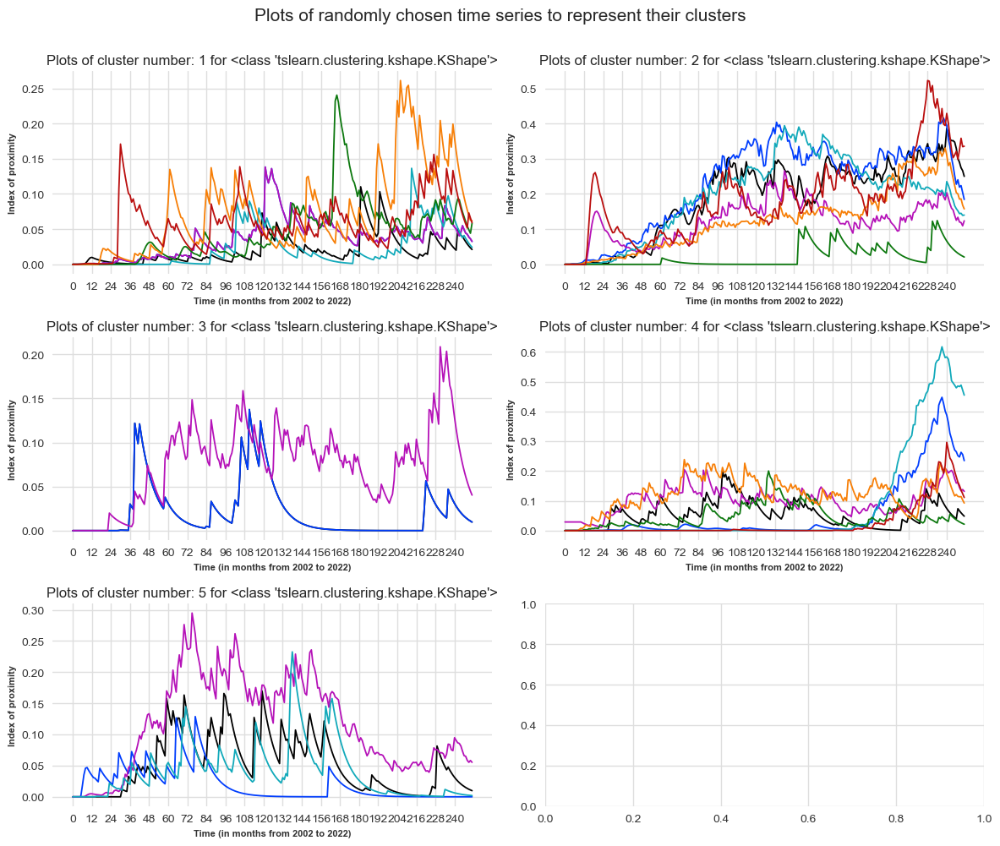

It took 1 seconds to plot the chosen time series.
 


In [334]:
myclusterer_withindata = evaluate_clusterer(bestalgo,X_train, X_test,n_clusters=bestnumber_cluster, init_algorithm="kmeans++", max_iter=500,\
metric="wddtw",random_state=1, n_init=40,distance_viz='l1',colors=colors)

We can observe that the clustering trained with in sample data is not as efficient as the one trained with external data. For this reason, we keep our idea of transfer learning in this specific setting our clustering task.

<div class="alert-info">
11. Clustering effectively all the time series and saving it in a dataframe:
</div>

In [335]:
dfindices_normalized

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,2002-01,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-02,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-03,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-04,0.000000,0.000000,0.003142,0.007803,0.007501
0,Authentication protocole,Authentication protocole,2002-05,0.002632,0.002632,0.005128,0.011675,0.011244
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08,0.071042,0.071042,0.211980,0.279424,0.283876
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09,0.063938,0.063938,0.210831,0.281445,0.283261
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10,0.057544,0.057544,0.197061,0.273963,0.285633
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11,0.069831,0.069831,0.195349,0.293252,0.308170


In [336]:
numbercluster = bestnumber_cluster

listconcept1=[]
listconcept2=[]
listindextype=[]
listcluster=[]


for concept1 in list_concepts:
    dfconcept1 = dfindices_normalized.loc[dfindices_normalized['concept1']==concept1]
    dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
    for concept2 in list_concepts:
        dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2]
        dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
        interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
        for index in list_indices:
            if interpolation_score<0.5:
                indices = np.array(dfconcept2[index].tolist())
                absval_indices = [abs(x) for x in list(indices)]
                # if the mean of the absolute series is above 0.02 we decrete it is not flat
                if abs(np.array(absval_indices).mean())>0.02:
                    tm = dfconcept2[index].tolist()
                    mytm=to_time_series_dataset(tm)
                    cluster_numbering = myclusterer.predict(mytm)[0]
                # nevertheless in this case we consider it as flat and attribute to it an artificial cluster with all
                # the flat series we did not consider previously
                else:
                    cluster_numbering=numbercluster
            # if the interpolation score is very high, we consider it to be useless to our studies
            # adding it to our set of time series would only add some noise, therefore we simply attribute
            #nan to it, to cancel it from our analyses.
            else:
                cluster_numbering=np.nan

            listconcept1.append(concept1)
            listconcept2.append(concept2)
            listindextype.append(index)
            listcluster.append(cluster_numbering)

In [349]:
(1.06+2.24+1.41+0.52+1.04)/5

1.254

In [337]:
numbercluster = bestnumber_cluster

listconcept1=[]
listconcept2=[]
listindextype=[]
listcluster=[]


for index in list_indices:
    list_tm_byindex = []
    listindices =[]
    
    listcluster_index=[]
    k=0
    for concept1 in list_concepts:
        dfconcept1 = dfindices_normalized.loc[dfindices_normalized['concept1']==concept1]
        dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
        for concept2 in list_concepts:
            dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2]
            dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
            interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
            if interpolation_score<0.5:
                indices = np.array(dfconcept2[index].tolist())
                absval_indices = [abs(x) for x in list(indices)]
                # if the mean of the absolute series is above 0.02 we decrete it is not flat
                if abs(np.array(absval_indices).mean())>0.02:
                    tm = dfconcept2[index].tolist()
                    mytm=to_time_series_dataset(tm)
                    list_tm_byindex.append(tm)
                    # I just define the number of the cluster as a variable I have to fill later
                    cluster_numbering ='tofill'
                    # I register the variable of the index, which is where this 
                    # cluster_numbering will appear in listcluster_index
                    listindices.append(k)
                # nevertheless in this case we consider it as flat and attribute to it an artificial cluster with all
                # the flat series we did not consider previously
                else:
                    cluster_numbering=numbercluster
            # if the interpolation score is very high, we consider it to be useless to our studies
            # adding it to our set of time series would only add some noise, therefore we simply attribute
            #nan to it, to cancel it from our analyses.
            else:
                cluster_numbering=np.nan
                
            #updating the overall index
            
            k=k+1

            listconcept1.append(concept1)
            listconcept2.append(concept2)
            listindextype.append(index)
            listcluster_index.append(cluster_numbering)
    
    predictions = myclusterer.predict(list_tm_byindex)
    
    # attributing the actual prediction to our time series
    for i in range(len(predictions)):
        myindexinlist = listindices[i]
        if listcluster_index[myindexinlist]!='tofill':
            print('This should not happen.')
        listcluster_index[myindexinlist]=predictions[i]
    
    listcluster = listcluster+listcluster_index

In [338]:
len(listconcept1)

3125

In [339]:
len(listconcept2)

3125

In [340]:
len(listindextype)

3125

In [341]:
len(listcluster)

3125

In [342]:
max(listcluster)

5

In [343]:
df_tm_tocluster = pd.DataFrame({'concept1':listconcept1,'concept2':listconcept2,'index':listindextype,'cluster':listcluster})

In [344]:
df_tm_tocluster

,concept1,concept2,index,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,0.0
1,Authentication protocole,Biometrics,index_cit_t1_t2,5.0
2,Authentication protocole,Blockchain,index_cit_t1_t2,5.0
3,Authentication protocole,Digital rights management,index_cit_t1_t2,5.0
4,Authentication protocole,Digital signature,index_cit_t1_t2,5.0
...,...,...,...,...
3120,Zero-knowlegde proof,Symmetric-key algorithm,index_keyword,2.0
3121,Zero-knowlegde proof,Threshold cryptosystem,index_keyword,NaN
3122,Zero-knowlegde proof,Trusted Computing,index_keyword,4.0
3123,Zero-knowlegde proof,Tunneling protocol,index_keyword,NaN


In [345]:
len(df_tm_tocluster.loc[df_tm_tocluster['cluster'].isnull()])

775

In [346]:
df_tm_tocluster.to_pickle('data_indices/df_tm_tocluster')